In [1]:
import numpy as np

import matplotlib.pyplot as plt
plt.rcParams['text.usetex'] = False
from matplotlib import cm, colors
from matplotlib.patches import Ellipse
import matplotlib as mpl

colors = plt.colormaps['tab10'].colors
import ligo.skymap.plot

from astropy.table import Table, vstack, join
from astropy.coordinates import SkyCoord, Distance
from astropy.cosmology import Planck18, FlatLambdaCDM
from astropy.wcs import WCS
from astropy.visualization.wcsaxes import SphericalCircle
from astropy import units as u
from astropy import constants as c
from astropy.io import fits
from IPython.display import display

from cosmoprimo.fiducial import DESI

from scipy.spatial.distance import cdist, euclidean

import os
from glob import glob

from corner import corner

import pickle

from sklearn.covariance import EllipticEnvelope
from matplotlib.patches import Ellipse
from scipy.stats import chi2
import math

from tqdm import tqdm
from hdbscan import HDBSCAN
from scipy.stats import binned_statistic
from matplotlib.projections import get_projection_names

from desiutil.plots import init_sky
from astropy import constants as const

# Custom functions / classes
import sys
# sys.path.insert(1, '/global/u1/k/kadglass/DESI_SGA/TF/')
# sys.path.insert(1, '/Users/kdouglass/Documents/Research/DESI/PV_survey/code/TF/')
sys.path.insert(1, '/global/u1/s/sgmoore1/DESI_SGA/TF/')
from help_functions import adjust_lightness, profile_histogram
from line_fits import hyperfit_line_multi
from TF_photoCorrect import BASS_corr, MW_dust, k_corr, internal_dust
from z_CMB_convert import convert_z_frame

In [2]:
# Base values for later conversions (all in units in km/s).
c_kms = c.c.to_value('km/s')

h = 1.
H0 = 100*h

q0 = 0.2

In [4]:
def mean_eta_z(cat_prefix, zbins, n_mocks=10, eta_col='LOGDIST', eta_err_col='LOGDIST_ERR'):
    eta_list = []  # to store each mock's binned mean
    
    for i in range(n_mocks):
        # Get the catalog variable from globals()
        cat = globals()[f"{cat_prefix}_{i}"]
        
        # Apply profile_histogram for this mock
        _, eta_avg, _ = profile_histogram(
            cat['ZOBS'][cat['MAIN']],
            cat[eta_col][cat['MAIN']],
            zbins,
            weights=cat[eta_err_col][cat['MAIN']]**-2,
            weighted=True
        )
        
        eta_list.append(eta_avg)
    
    # Stack all mock results into a 2D array: shape (n_mocks, n_bins)
    eta_array = np.vstack(eta_list)
    
    # Compute mean and std across mocks (axis=0 → across rows)
    eta_mean = np.mean(eta_array, axis=0)
    eta_std = np.std(eta_array, axis=0)
    
    # Compute bin centers
    zc = 0.5 * (zbins[1:] + zbins[:-1])
    
    return zc, eta_mean, eta_std

def mean_eta_eta(cat_prefix, eta_bins, n_mocks=10, eta_col='LOGDIST', eta_err_col='LOGDIST_ERR'):
    eta_list = []  # to store each mock's binned mean
    
    for i in range(n_mocks):
        # Get the catalog variable from globals()
        cat = globals()[f"{cat_prefix}_{i}"]
        
        _, eta_avg, _ = profile_histogram(
            cat['LOGDIST_TRUE'][cat['MAIN']],
            cat[eta_col][cat['MAIN']],
            eta_bins,
            stat='median'
        )
        
        eta_list.append(eta_avg)
    
    # Stack all mock results into a 2D array: shape (n_mocks, n_bins)
    eta_array = np.vstack(eta_list)
    
    # Compute mean and std across mocks (axis=0 → across rows)
    eta_mean = np.mean(eta_array, axis=0)
    eta_std = np.std(eta_array, axis=0)
    
    # Compute bin centers
    eta_c = 0.5 * (eta_bins[1:] + eta_bins[:-1])
    
    return eta_c, eta_mean, eta_std

def mean_delta_eta_z(cat_prefix, zbins, n_mocks=10, eta_col='LOGDIST', eta_err_col='LOGDIST_ERR'):
    eta_list = []  # to store each mock's binned mean
    
    for i in range(n_mocks):
        # Get the catalog variable from globals()
        cat = globals()[f"{cat_prefix}_{i}"]

        _, eta_avg, _ = profile_histogram(
            cat['ZOBS'][cat['MAIN']],
            cat[eta_col][cat['MAIN']] - cat['LOGDIST_TRUE'][cat['MAIN']],
            zbins,
            weights=cat[eta_err_col][cat['MAIN']]**-2,
            weighted=True
        )
        
        eta_list.append(eta_avg)
    
    # Stack all mock results into a 2D array: shape (n_mocks, n_bins)
    eta_array = np.vstack(eta_list)
    
    # Compute mean and std across mocks (axis=0 → across rows)
    eta_mean = np.mean(eta_array, axis=0)
    eta_std = np.std(eta_array, axis=0)
    
    # Compute bin centers
    zc = 0.5 * (zbins[1:] + zbins[:-1])
    
    return zc, eta_mean, eta_std


def mean_delta_eta_m(cat_prefix, mbins, n_mocks=10, eta_col='LOGDIST', eta_err_col='LOGDIST_ERR'):
    eta_list = []  # to store each mock's binned mean
    
    for i in range(n_mocks):
        # Get the catalog variable from globals()
        cat = globals()[f"{cat_prefix}_{i}"]

        _, eta_avg, _ = profile_histogram(
            cat['R_ABSMAG_SB26'][cat['MAIN']],
            cat[eta_col][cat['MAIN']] - cat['LOGDIST_TRUE'][cat['MAIN']],
            mbins,
            weights=cat[eta_err_col][cat['MAIN']]**-2,
            weighted=True
        )
        
        eta_list.append(eta_avg)
    
    # Stack all mock results into a 2D array: shape (n_mocks, n_bins)
    eta_array = np.vstack(eta_list)
    
    # Compute mean and std across mocks (axis=0 → across rows)
    eta_mean = np.mean(eta_array, axis=0)
    eta_std = np.std(eta_array, axis=0)
    
    # Compute bin centers
    mc = 0.5 * (mbins[1:] + mbins[:-1])
    
    return mc, eta_mean, eta_std

def mean_delta_eta_appm(cat_prefix, mbins, n_mocks=10, eta_col='LOGDIST', eta_err_col='LOGDIST_ERR'):
    eta_list = []  # to store each mock's binned mean
    cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
    for i in range(n_mocks):
        # Get the catalog variable from globals()
        cat = globals()[f"{cat_prefix}_{i}"]


        app_m = cosmology.distmod(cat['ZOBS'][cat['MAIN']]).to_value('mag') + cat['R_ABSMAG_SB26'][cat['MAIN']]
        _, eta_avg, _ = profile_histogram(
            app_m,
            cat[eta_col][cat['MAIN']] - cat['LOGDIST_TRUE'][cat['MAIN']],
            mbins,
            weights=cat[eta_err_col][cat['MAIN']]**-2,
            weighted=True
        )
        
        eta_list.append(eta_avg)
    
    # Stack all mock results into a 2D array: shape (n_mocks, n_bins)
    eta_array = np.vstack(eta_list)
    
    # Compute mean and std across mocks (axis=0 → across rows)
    eta_mean = np.mean(eta_array, axis=0)
    eta_std = np.std(eta_array, axis=0)
    
    # Compute bin centers
    mc = 0.5 * (mbins[1:] + mbins[:-1])
    
    return mc, eta_mean, eta_std

def mean_eta_eta_zbins(cat_prefix, eta_bins, n_mocks=10, eta_col='LOGDIST', eta_err_col='LOGDIST_ERR', zmin=0, zmax=1):
    eta_list = []  # to store each mock's binned mean
    
    for i in range(n_mocks):
        # Get the catalog variable from globals()
        cat = globals()[f"{cat_prefix}_{i}"]
        cat = cat[(cat['ZOBS'] > zmin) & (cat['ZOBS'] < zmax)]
        _, eta_avg, _ = profile_histogram(
            cat['LOGDIST_TRUE'][cat['MAIN']],
            cat[eta_col][cat['MAIN']],
            eta_bins,
            stat='median'
        )
        
        eta_list.append(eta_avg)
    
    # Stack all mock results into a 2D array: shape (n_mocks, n_bins)
    eta_array = np.vstack(eta_list)
    
    # Compute mean and std across mocks (axis=0 → across rows)
    eta_mean = np.mean(eta_array, axis=0)
    eta_std = np.std(eta_array, axis=0)
    
    # Compute bin centers
    eta_c = 0.5 * (eta_bins[1:] + eta_bins[:-1])
    
    return eta_c, eta_mean, eta_std

In [5]:
#### read in the v13 mocks
z=0.03
version='v13'
for i in range(10):
# mockfile = mockfiles[np.random.randint(n_mock)]
    globals()[f'mock_v13_{i}']= Table.read(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_zmin={z}_mockidx={60*i}.fits')



In [6]:
mock_v13_0

RA,DEC,ZOBS,ZCOS,vx,vy,vz,DWARF,MAIN,LOGVROT,R_ABSMAG_SB26,LOGDIST_TRUE,LOGDIST,LOGDIST_ERR,Y1_COMP,Y3_COMP
float64,float64,float64,float64,float64,float64,float64,bool,bool,float64,float64,float64,float64,float64,float64,float64
185.7022102832178,4.1413601223312755,0.11172798555016938,0.10991454536005436,-423.27459716796875,-520.94970703125,250.795166015625,False,True,2.168657004671041,-21.95743584272125,0.007618177987605179,0.2883538303614415,0.12435811656162202,1.0,1.0
180.42242370187515,-1.0065998873875552,0.11009305112079626,0.10870194561286645,-370.06585693359375,-10.584589958190918,-345.9512634277344,False,True,2.413358998501243,-21.88555843959148,0.0059156701494544,-0.09278439215129311,0.10977097710450245,1.0,1.0
176.48050201097269,6.728829453440869,0.11136099673967004,0.10971141393698831,-508.4543762207031,49.60839080810547,-523.8817749023438,False,True,2.2941388635877553,-21.175679573158202,0.0069466571333791196,-0.05607137388145844,0.10976592851418264,0.0,0.9636363636363636
186.43150214255164,5.600938272383595,0.11122607861529477,0.1093812948143913,-502.3745422363281,-484.9122619628906,-536.5270385742188,False,True,2.2999187045332796,-21.755657280895946,0.007784166202758059,0.05126126190194356,0.11071226346566652,0.0,0.9556962025316456
189.67425955028784,3.0100353751287936,0.11095549988278042,0.10975353968612903,-471.7829895019531,805.4813842773438,-86.82174682617188,False,True,2.281997988624802,-21.808558152451642,0.005069468681499246,0.08870125374169646,0.11070171338977629,0.9867549668874173,0.9536423841059603
185.0165519536517,4.100763052170461,0.11068523906195726,0.10816102294674335,-623.4550170898438,-694.0182495117188,40.14926528930664,False,True,2.289994272988461,-21.93560510959301,0.010732154239134673,0.10212570327302331,0.11077286947991455,0.8188405797101449,1.0
189.26832208143009,5.54292967910915,0.10721175184956766,0.10927731612325821,482.24932861328125,355.1363830566406,-285.52886962890625,False,True,2.3793733857971384,-22.035674243059454,-0.008872248345147682,-0.011823123823361925,0.1105082005323948,0.5636363636363636,0.8363636363636363
173.3787019974296,-8.601180359940724,0.10991991235525167,0.1094162241555045,-68.98114013671875,308.0338134765625,-222.25929260253906,False,True,2.318165631984309,-21.171054184359658,0.00213692016575493,-0.09300810531781566,0.11062519368633894,0.9034090909090909,0.9034090909090909
168.41364715794055,1.534080331785917,0.11170751733360818,0.10963906549775237,-476.62225341796875,501.60906982421875,-321.8409729003906,False,True,2.4617880870500177,-21.7802891637241,0.008700486666772634,-0.18642443685762375,0.10940091634616976,0.9745222929936306,0.9745222929936306


# Compare the eta values using all the ellipse variants


In [3]:
##### Read in all of the mock files

for i in range(10):
    ## population density fits
    for j in {2, 2.5, 3}:
        version='v5'
        globals()[f'mock_sig{int(j*10)}_{version}_extrap_{i}'] = Table.read(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std={j}_mockidx={60*i}_extrap.fits')
        globals()[f'mock_sig{int(j*10)}_{version}_noextrap_{i}'] = Table.read(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std={j}_mockidx={60*i}_noextrap.fits')
    #### HDBScan fitsmock_sig{int(j*10)}_{version}_extrap_{i}
    for k in {2, 2.5}:
        version='v5b'
        globals()[f'mock_sig{int(k*10)}_{version}_extrap_{i}'] = Table.read(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std={k}_mockidx={60*i}_extrap.fits')
        globals()[f'mock_sig{int(k*10)}_{version}_noextrap_{i}'] = Table.read(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std={k}_mockidx={60*i}_noextrap.fits')

In [66]:
# _zbins = np.arange(0, 0.105, 0.005)
# dz = 0.5*np.diff(_zbins)
# zc = 0.5*(_zbins[1:] + _zbins[:-1])
# zc, eta_mean, eta_std = mean_eta_z('mock_sig20_v5_extrap', n_mocks=10, zbins=_zbins)

# plt.figure()
# plt.plot(zc, eta_mean, lw=2, color='tab:blue', label='mean across mocks')
# plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:blue', alpha=0.3)
# plt.xlabel('Redshift bin')
# plt.ylabel('Weighted LOGDIST')
# plt.legend()
# plt.show()


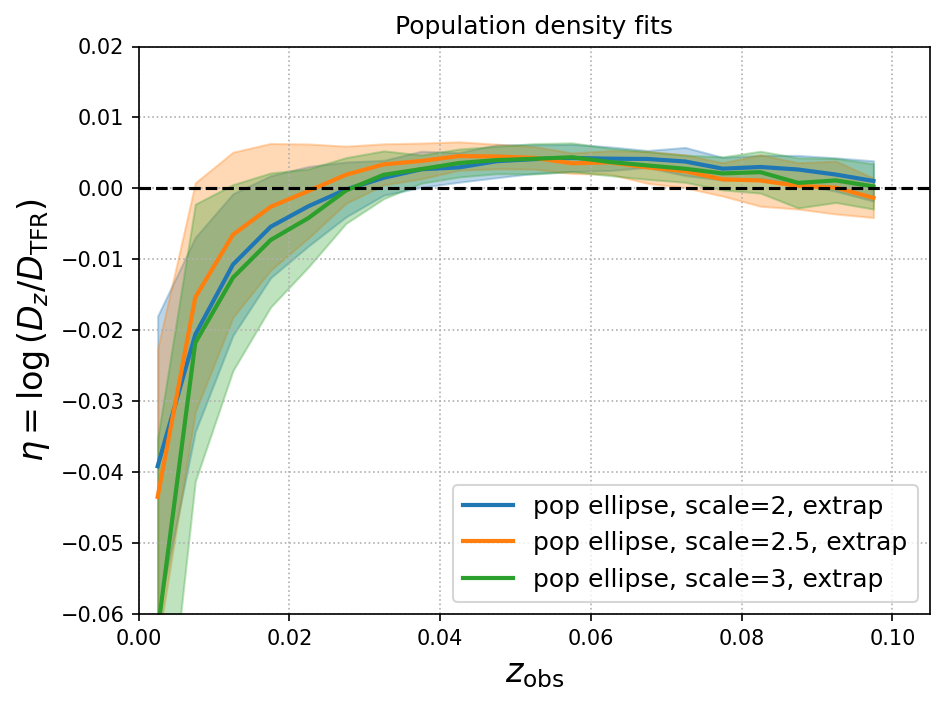

In [69]:
fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])
cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
plt.grid(ls=':')

zc, eta_mean, eta_std = mean_eta_z('mock_sig20_v5_extrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:blue', label='pop ellipse, scale=2, extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:blue', alpha=0.3)

zc, eta_mean, eta_std = mean_eta_z('mock_sig25_v5_extrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:orange', label='pop ellipse, scale=2.5, extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:orange', alpha=0.3)


zc, eta_mean, eta_std = mean_eta_z('mock_sig30_v5_extrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:green', label='pop ellipse, scale=3, extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:green', alpha=0.3)

# Line at eta = 0
plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
# -------------------------------------------------------------------------------

plt.legend(fontsize=12)
plt.title('Population density fits')
plt.xlabel(r'$z_\mathrm{obs}$', fontsize=16)
plt.ylabel(r'$\eta = \log{(D_z / D_\mathrm{TFR})}$', fontsize=16)

plt.xlim(0,0.105)
plt.ylim(-0.06, 0.02);

# fig.savefig('tfr_mock_eta.png', dpi=150);

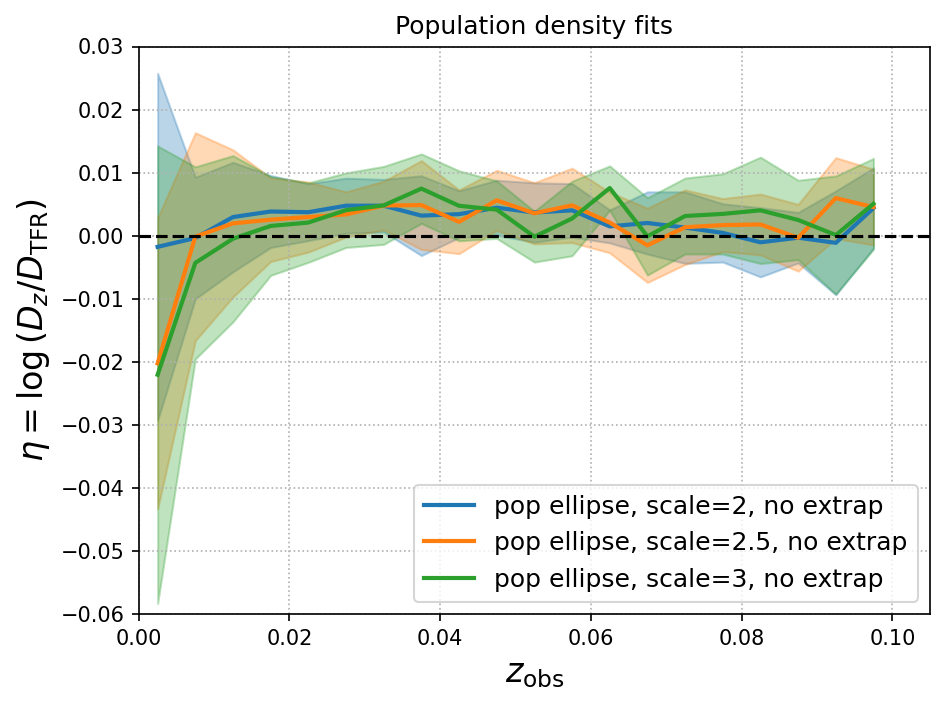

In [87]:
fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])
cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
plt.grid(ls=':')

zc, eta_mean, eta_std = mean_eta_z('mock_sig20_v5_noextrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:blue', label='pop ellipse, scale=2, no extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:blue', alpha=0.3)

zc, eta_mean, eta_std = mean_eta_z('mock_sig25_v5_noextrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:orange', label='pop ellipse, scale=2.5, no extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:orange', alpha=0.3)


zc, eta_mean, eta_std = mean_eta_z('mock_sig30_v5_noextrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:green', label='pop ellipse, scale=3, no extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:green', alpha=0.3)

# Line at eta = 0
plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
# -------------------------------------------------------------------------------

plt.legend(fontsize=12, loc='lower right')
plt.title('Population density fits')
plt.xlabel(r'$z_\mathrm{obs}$', fontsize=16)
plt.ylabel(r'$\eta = \log{(D_z / D_\mathrm{TFR})}$', fontsize=16)

plt.xlim(0,0.105)
plt.ylim(-0.06, 0.03);

# fig.savefig('tfr_mock_eta.png', dpi=150);

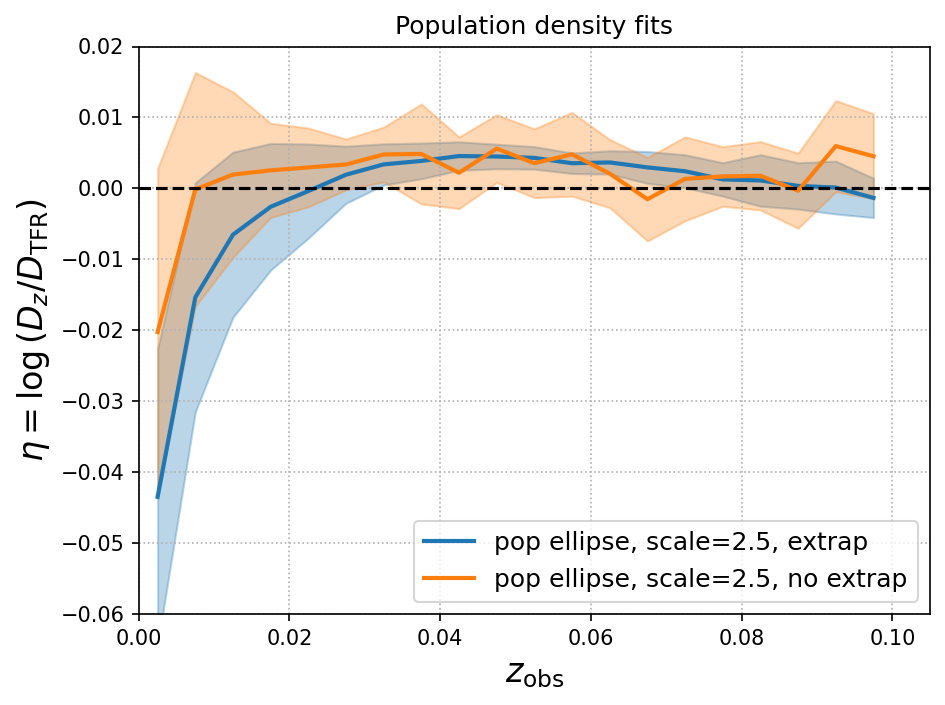

In [86]:
fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])
cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
plt.grid(ls=':')

zc, eta_mean, eta_std = mean_eta_z('mock_sig25_v5_extrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:blue', label='pop ellipse, scale=2.5, extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:blue', alpha=0.3)


zc, eta_mean, eta_std = mean_eta_z('mock_sig25_v5_noextrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:orange', label='pop ellipse, scale=2.5, no extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:orange', alpha=0.3)

# Line at eta = 0
plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
# -------------------------------------------------------------------------------

plt.legend(fontsize=12, loc='lower right')
plt.title('Population density fits')
plt.xlabel(r'$z_\mathrm{obs}$', fontsize=16)
plt.ylabel(r'$\eta = \log{(D_z / D_\mathrm{TFR})}$', fontsize=16)

plt.xlim(0,0.105)
plt.ylim(-0.06, 0.02);

# fig.savefig('tfr_mock_eta.png', dpi=150);

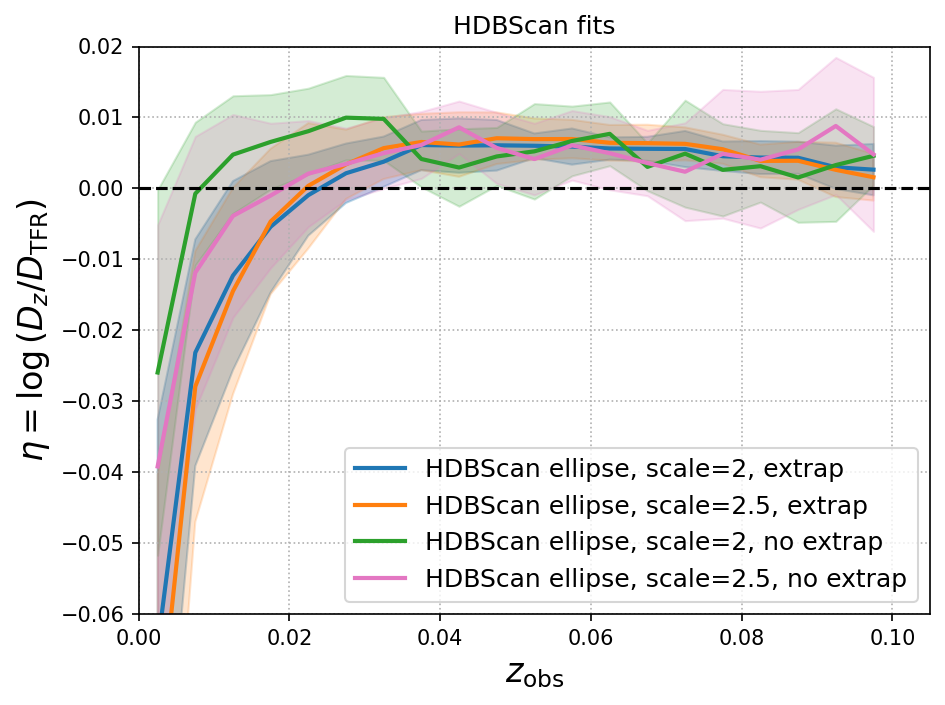

In [120]:
fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])

plt.grid(ls=':')

zc, eta_mean, eta_std = mean_eta_z('mock_sig20_v5b_extrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:blue', label='HDBScan ellipse, scale=2, extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:blue', alpha=0.3)

zc, eta_mean, eta_std = mean_eta_z('mock_sig25_v5b_extrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:orange', label='HDBScan ellipse, scale=2.5, extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:orange', alpha=0.2)

zc, eta_mean, eta_std = mean_eta_z('mock_sig20_v5b_noextrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:green', label='HDBScan ellipse, scale=2, no extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:green', alpha=0.2)

zc, eta_mean, eta_std = mean_eta_z('mock_sig25_v5b_noextrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:pink', label='HDBScan ellipse, scale=2.5, no extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:pink', alpha=0.2)

# Line at eta = 0
plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
# -------------------------------------------------------------------------------

plt.legend(fontsize=12, loc='lower right')
plt.title('HDBScan fits')
plt.xlabel(r'$z_\mathrm{obs}$', fontsize=16)
plt.ylabel(r'$\eta = \log{(D_z / D_\mathrm{TFR})}$', fontsize=16)

plt.xlim(0,0.105)
plt.ylim(-0.06, 0.02);

# fig.savefig('tfr_mock_eta.png', dpi=150);

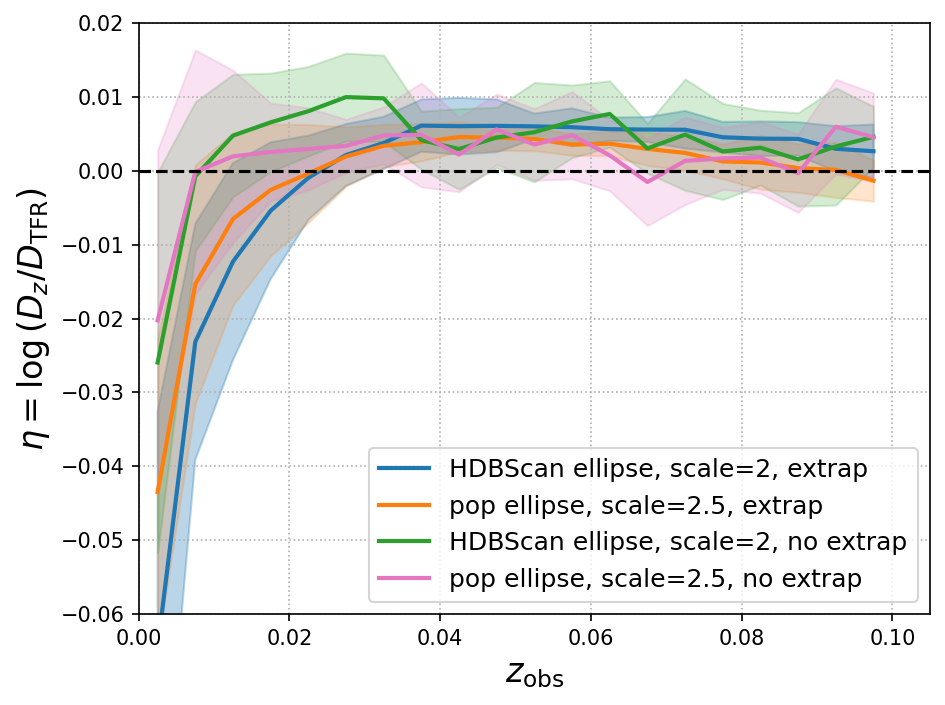

In [119]:
fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])

plt.grid(ls=':')

zc, eta_mean, eta_std = mean_eta_z('mock_sig20_v5b_extrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:blue', label='HDBScan ellipse, scale=2, extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:blue', alpha=0.3)

zc, eta_mean, eta_std = mean_eta_z('mock_sig25_v5_extrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:orange', label='pop ellipse, scale=2.5, extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:orange', alpha=0.2)

zc, eta_mean, eta_std = mean_eta_z('mock_sig20_v5b_noextrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:green', label='HDBScan ellipse, scale=2, no extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:green', alpha=0.2)

zc, eta_mean, eta_std = mean_eta_z('mock_sig25_v5_noextrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:pink', label='pop ellipse, scale=2.5, no extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:pink', alpha=0.2)

# Line at eta = 0
plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
# -------------------------------------------------------------------------------

plt.legend(fontsize=12, loc='lower right')
# plt.title('HDBScan fits')
plt.xlabel(r'$z_\mathrm{obs}$', fontsize=16)
plt.ylabel(r'$\eta = \log{(D_z / D_\mathrm{TFR})}$', fontsize=16)

plt.xlim(0,0.105)
plt.ylim(-0.06, 0.02);

# fig.savefig('tfr_mock_eta.png', dpi=150);

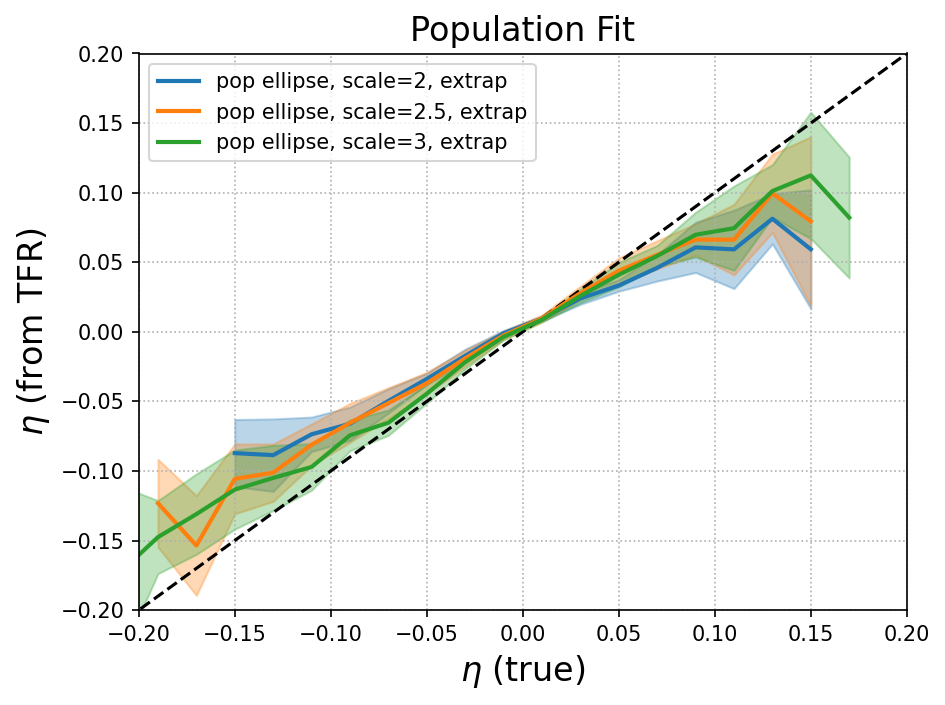

In [93]:
plt.figure(tight_layout=True, dpi=150, facecolor='none')

# plt.plot(eta_true[~idx_mock_good], eta_mock[~idx_mock_good], '.', c='gray', alpha=0.1, zorder=0)
# plt.plot(eta_true[mock_main], eta_mock[mock_main], '.', alpha=0.1, zorder=1)
# plt.hexbin(eta_true[fit_cat_0['MAIN']], 
#            fit_cat_0['LOGDIST'][fit_cat_0['MAIN']], 
#            cmap='plasma', 
#            mincnt=1, 
#            vmin=1, 
#            vmax=1000, 
#            gridsize=(100,100), 
#            extent=(-0.2, 0.2, -1, 1))

plt.plot([-5, 2], [-5, 2], '--', c='k')

eta_bins = np.arange(-0.5, 0.3, 0.02)
d_eta = 0.5*np.diff(eta_bins)
eta_c = 0.5*(eta_bins[1:] + eta_bins[:-1])

eta_c, eta_mean, eta_std = mean_eta_eta('mock_sig20_v5_extrap', eta_bins, n_mocks=10)
plt.plot(eta_c, eta_mean, lw=2, color='tab:blue', label='pop ellipse, scale=2, extrap')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, color='tab:blue', alpha=0.3)

eta_c, eta_mean, eta_std = mean_eta_eta('mock_sig25_v5_extrap', eta_bins, n_mocks=10)
plt.plot(eta_c, eta_mean, lw=2, color='tab:orange', label='pop ellipse, scale=2.5, extrap')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, color='tab:orange', alpha=0.3)

eta_c, eta_mean, eta_std = mean_eta_eta('mock_sig30_v5_extrap', eta_bins, n_mocks=10)
plt.plot(eta_c, eta_mean, lw=2, color='tab:green', label='pop ellipse, scale=3, extrap')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, color='tab:green', alpha=0.3)

# eta_c, eta_mean, eta_std = mean_eta_eta('mock_sig20_v5b_extrap', eta_bins n_mocks=10)
# plt.plot(eta_c, eta_mean, lw=2, color='tab:blue', label='pop ellipse, scale=2, extrap')
# plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, color='tab:blue', alpha=0.3)


plt.grid(ls=':')

plt.xlim([-0.2, 0.2])
plt.ylim([-0.2, 0.2])
plt.legend()
plt.title('Population Fit', fontsize=16)
plt.xlabel(r'$\eta$ (true)', fontsize=16)
plt.ylabel(r'$\eta$ (from TFR)', fontsize=16);

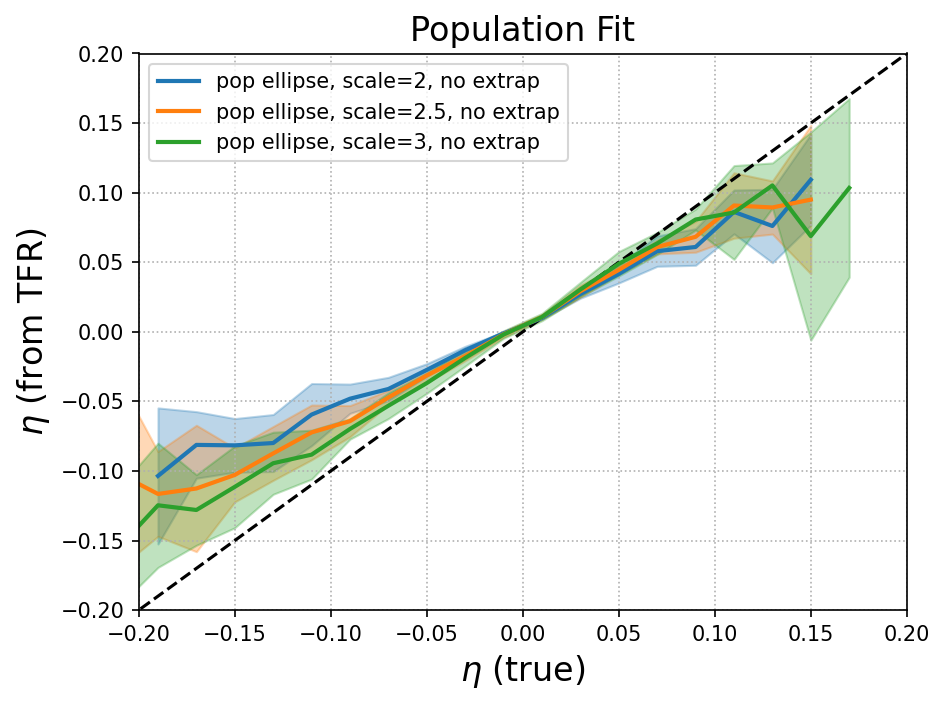

In [94]:
plt.figure(tight_layout=True, dpi=150, facecolor='none')

# plt.plot(eta_true[~idx_mock_good], eta_mock[~idx_mock_good], '.', c='gray', alpha=0.1, zorder=0)
# plt.plot(eta_true[mock_main], eta_mock[mock_main], '.', alpha=0.1, zorder=1)
# plt.hexbin(eta_true[fit_cat_0['MAIN']], 
#            fit_cat_0['LOGDIST'][fit_cat_0['MAIN']], 
#            cmap='plasma', 
#            mincnt=1, 
#            vmin=1, 
#            vmax=1000, 
#            gridsize=(100,100), 
#            extent=(-0.2, 0.2, -1, 1))

plt.plot([-5, 2], [-5, 2], '--', c='k')

eta_bins = np.arange(-0.5, 0.3, 0.02)
d_eta = 0.5*np.diff(eta_bins)
eta_c = 0.5*(eta_bins[1:] + eta_bins[:-1])

eta_c, eta_mean, eta_std = mean_eta_eta('mock_sig20_v5_noextrap', eta_bins, n_mocks=10)
plt.plot(eta_c, eta_mean, lw=2, color='tab:blue', label='pop ellipse, scale=2, no extrap')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, color='tab:blue', alpha=0.3)

eta_c, eta_mean, eta_std = mean_eta_eta('mock_sig25_v5_noextrap', eta_bins, n_mocks=10)
plt.plot(eta_c, eta_mean, lw=2, color='tab:orange', label='pop ellipse, scale=2.5, no extrap')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, color='tab:orange', alpha=0.3)

eta_c, eta_mean, eta_std = mean_eta_eta('mock_sig30_v5_noextrap', eta_bins, n_mocks=10)
plt.plot(eta_c, eta_mean, lw=2, color='tab:green', label='pop ellipse, scale=3, no extrap')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, color='tab:green', alpha=0.3)

# eta_c, eta_mean, eta_std = mean_eta_eta('mock_sig20_v5b_extrap', eta_bins n_mocks=10)
# plt.plot(eta_c, eta_mean, lw=2, color='tab:blue', label='pop ellipse, scale=2, extrap')
# plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, color='tab:blue', alpha=0.3)


plt.grid(ls=':')

plt.xlim([-0.2, 0.2])
plt.ylim([-0.2, 0.2])
plt.legend()
plt.title('Population Fit', fontsize=16)
plt.xlabel(r'$\eta$ (true)', fontsize=16)
plt.ylabel(r'$\eta$ (from TFR)', fontsize=16);

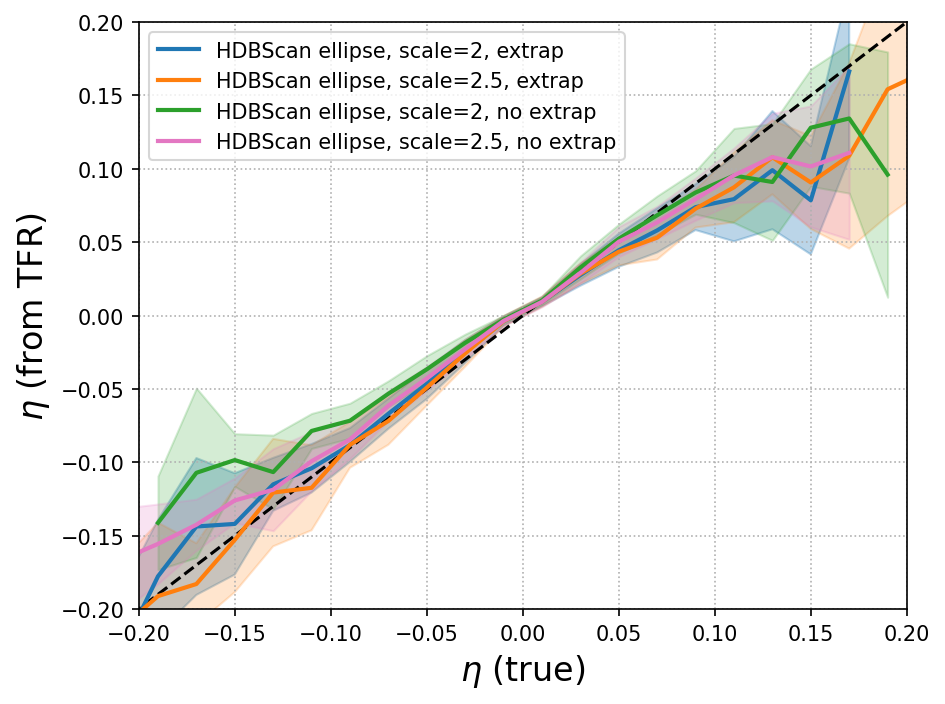

In [98]:
plt.figure(tight_layout=True, facecolor='none', dpi=150)

# plt.plot(eta_true[~idx_mock_good], eta_mock[~idx_mock_good], '.', c='gray', alpha=0.1, zorder=0)
# plt.plot(eta_true[mock_main], eta_mock[mock_main], '.', alpha=0.1, zorder=1)
# plt.hexbin(eta_true[fit_cat_0['MAIN']], 
#            fit_cat_0['LOGDIST'][fit_cat_0['MAIN']], 
#            cmap='plasma', 
#            mincnt=1, 
#            vmin=1, 
#            vmax=1000, 
#            gridsize=(100,100), 
#            extent=(-0.2, 0.2, -1, 1))

plt.plot([-5, 2], [-5, 2], '--', c='k')

eta_bins = np.arange(-0.5, 0.3, 0.02)
d_eta = 0.5*np.diff(eta_bins)
eta_c = 0.5*(eta_bins[1:] + eta_bins[:-1])

eta_c, eta_mean, eta_std = mean_eta_eta('mock_sig20_v5b_extrap', eta_bins, n_mocks=10)
plt.plot(eta_c, eta_mean, lw=2, color='tab:blue', label='HDBScan ellipse, scale=2, extrap')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, color='tab:blue', alpha=0.3)

eta_c, eta_mean, eta_std = mean_eta_eta('mock_sig25_v5b_extrap', eta_bins, n_mocks=10)
plt.plot(eta_c, eta_mean, lw=2, color='tab:orange', label='HDBScan ellipse, scale=2.5, extrap')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, color='tab:orange', alpha=0.2)

eta_c, eta_mean, eta_std = mean_eta_eta('mock_sig20_v5b_noextrap', eta_bins, n_mocks=10)
plt.plot(eta_c, eta_mean, lw=2, color='tab:green', label='HDBScan ellipse, scale=2, no extrap')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, color='tab:green', alpha=0.2)

eta_c, eta_mean, eta_std = mean_eta_eta('mock_sig25_v5b_noextrap', eta_bins, n_mocks=10)
plt.plot(eta_c, eta_mean, lw=2, color='tab:pink', label='HDBScan ellipse, scale=2.5, no extrap')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, color='tab:pink', alpha=0.2)

# Line at eta = 0

# eta_c, eta_mean, eta_std = mean_eta_eta('mock_sig20_v5b_extrap', eta_bins n_mocks=10)
# plt.plot(eta_c, eta_mean, lw=2, color='tab:blue', label='pop ellipse, scale=2, extrap')
# plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, color='tab:blue', alpha=0.3)
plt.grid(ls=':')

plt.xlim([-0.2, 0.2])
plt.ylim([-0.2, 0.2])
plt.legend()
# plt.title('Population Fit')
plt.xlabel(r'$\eta$ (true)', fontsize=16)
plt.ylabel(r'$\eta$ (from TFR)', fontsize=16);

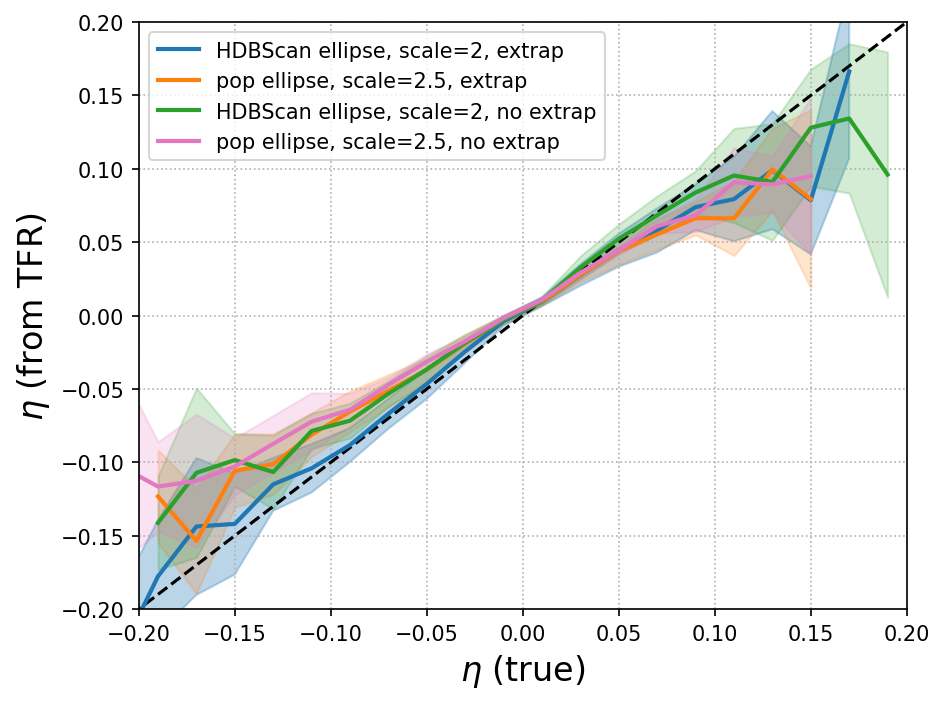

In [99]:
plt.figure(tight_layout=True, facecolor='none', dpi=150)

# plt.plot(eta_true[~idx_mock_good], eta_mock[~idx_mock_good], '.', c='gray', alpha=0.1, zorder=0)
# plt.plot(eta_true[mock_main], eta_mock[mock_main], '.', alpha=0.1, zorder=1)
# plt.hexbin(eta_true[fit_cat_0['MAIN']], 
#            fit_cat_0['LOGDIST'][fit_cat_0['MAIN']], 
#            cmap='plasma', 
#            mincnt=1, 
#            vmin=1, 
#            vmax=1000, 
#            gridsize=(100,100), 
#            extent=(-0.2, 0.2, -1, 1))

plt.plot([-5, 2], [-5, 2], '--', c='k')

eta_bins = np.arange(-0.5, 0.3, 0.02)
d_eta = 0.5*np.diff(eta_bins)
eta_c = 0.5*(eta_bins[1:] + eta_bins[:-1])

eta_c, eta_mean, eta_std = mean_eta_eta('mock_sig20_v5b_extrap', eta_bins, n_mocks=10)
plt.plot(eta_c, eta_mean, lw=2, color='tab:blue', label='HDBScan ellipse, scale=2, extrap')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, color='tab:blue', alpha=0.3)

eta_c, eta_mean, eta_std = mean_eta_eta('mock_sig25_v5_extrap', eta_bins, n_mocks=10)
plt.plot(eta_c, eta_mean, lw=2, color='tab:orange', label='pop ellipse, scale=2.5, extrap')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, color='tab:orange', alpha=0.2)

eta_c, eta_mean, eta_std = mean_eta_eta('mock_sig20_v5b_noextrap', eta_bins, n_mocks=10)
plt.plot(eta_c, eta_mean, lw=2, color='tab:green', label='HDBScan ellipse, scale=2, no extrap')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, color='tab:green', alpha=0.2)

eta_c, eta_mean, eta_std = mean_eta_eta('mock_sig25_v5_noextrap', eta_bins, n_mocks=10)
plt.plot(eta_c, eta_mean, lw=2, color='tab:pink', label='pop ellipse, scale=2.5, no extrap')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, color='tab:pink', alpha=0.2)

# Line at eta = 0

# eta_c, eta_mean, eta_std = mean_eta_eta('mock_sig20_v5b_extrap', eta_bins n_mocks=10)
# plt.plot(eta_c, eta_mean, lw=2, color='tab:blue', label='pop ellipse, scale=2, extrap')
# plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, color='tab:blue', alpha=0.3)
plt.grid(ls=':')

plt.xlim([-0.2, 0.2])
plt.ylim([-0.2, 0.2])
plt.legend()
# plt.title('Population Fit')
plt.xlabel(r'$\eta$ (true)', fontsize=16)
plt.ylabel(r'$\eta$ (from TFR)', fontsize=16);

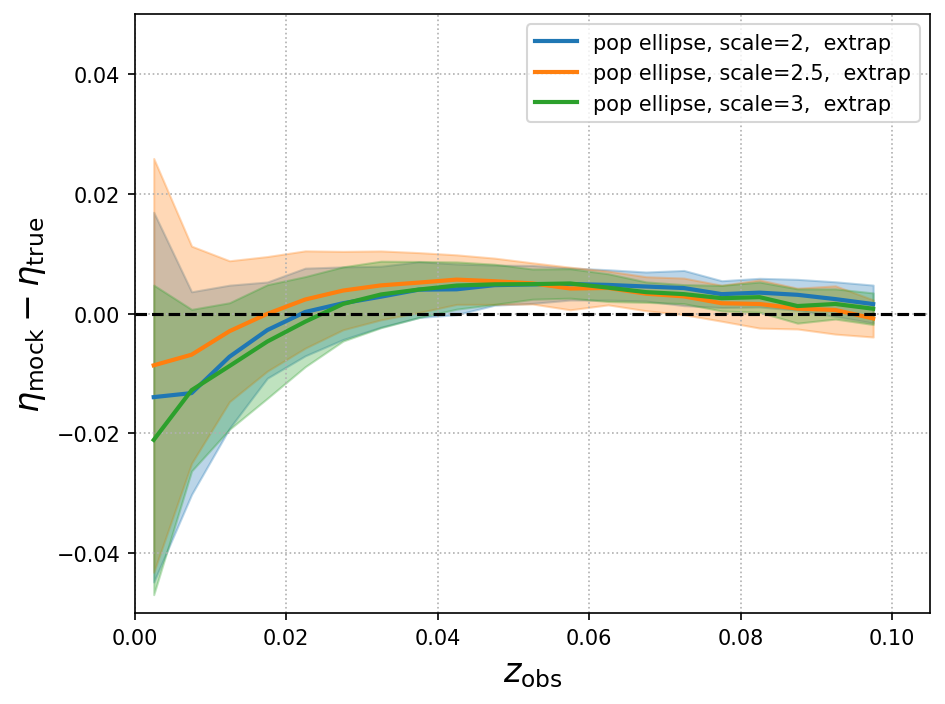

In [104]:
fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])

cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
plt.grid(ls=':')

# # True mock
# _, eta_avg, eta_std = profile_histogram(fit_cat_0['ZOBS'], 
#                                         fit_cat_0['LOGDIST_TRUE'], 
#                                         _zbins)
# plt.errorbar(zc, eta_avg, yerr=eta_std, fmt='x', color='k', label='mock (true)')

# Mock
zc, eta_mean, eta_std = mean_delta_eta_z('mock_sig20_v5_extrap', _zbins, n_mocks=10)
plt.plot(zc, eta_mean, lw=2, color='tab:blue', label='pop ellipse, scale=2,  extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:blue', alpha=0.3)

zc, eta_mean, eta_std = mean_delta_eta_z('mock_sig25_v5_extrap', _zbins, n_mocks=10)
plt.plot(zc, eta_mean, lw=2, color='tab:orange', label='pop ellipse, scale=2.5,  extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:orange', alpha=0.3)


zc, eta_mean, eta_std = mean_delta_eta_z('mock_sig30_v5_extrap', _zbins, n_mocks=10)
plt.plot(zc, eta_mean, lw=2, color='tab:green', label='pop ellipse, scale=3,  extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:green', alpha=0.3)

# Line at eta = 0
plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
#-------------------------------------------------------------------------------

plt.legend()
# plt.title('Population Fit')
plt.xlabel(r'$z_\mathrm{obs}$', fontsize=16)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)

plt.xlim(0,0.105)
plt.ylim(-0.05, 0.05);

# fig.savefig('tfr_mock_eta.png', dpi=150);

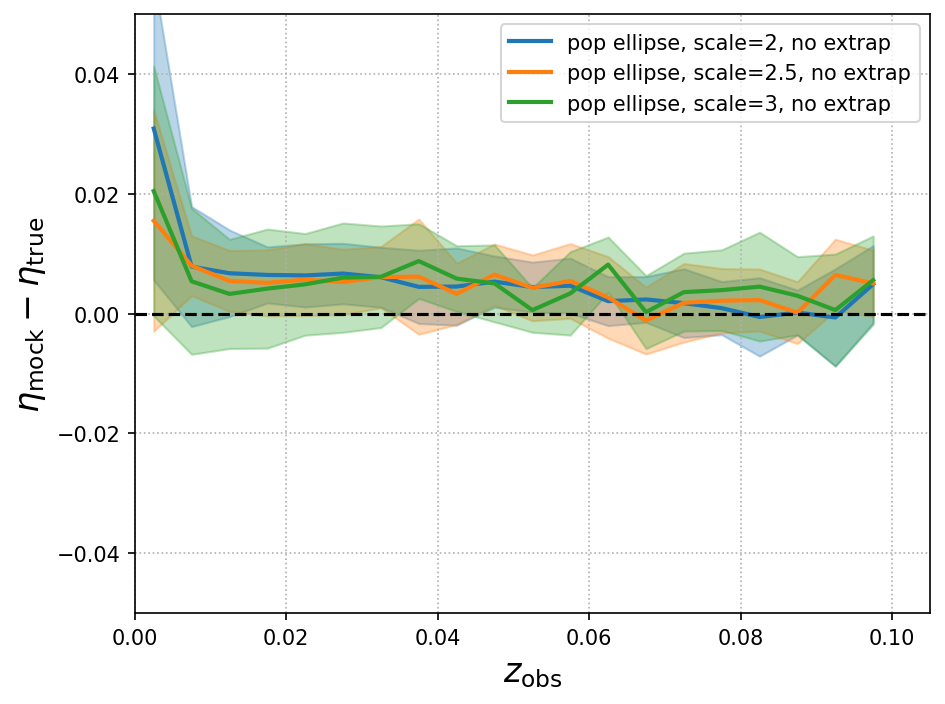

In [103]:
fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])

cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
plt.grid(ls=':')

# # True mock
# _, eta_avg, eta_std = profile_histogram(fit_cat_0['ZOBS'], 
#                                         fit_cat_0['LOGDIST_TRUE'], 
#                                         _zbins)
# plt.errorbar(zc, eta_avg, yerr=eta_std, fmt='x', color='k', label='mock (true)')

# Mock
zc, eta_mean, eta_std = mean_delta_eta_z('mock_sig20_v5_noextrap', _zbins, n_mocks=10)
plt.plot(zc, eta_mean, lw=2, color='tab:blue', label='pop ellipse, scale=2, no extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:blue', alpha=0.3)

zc, eta_mean, eta_std = mean_delta_eta_z('mock_sig25_v5_noextrap', _zbins, n_mocks=10)
plt.plot(zc, eta_mean, lw=2, color='tab:orange', label='pop ellipse, scale=2.5, no extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:orange', alpha=0.3)


zc, eta_mean, eta_std = mean_delta_eta_z('mock_sig30_v5_noextrap', _zbins, n_mocks=10)
plt.plot(zc, eta_mean, lw=2, color='tab:green', label='pop ellipse, scale=3, no extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:green', alpha=0.3)

# Line at eta = 0
plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
#-------------------------------------------------------------------------------

plt.legend()
# plt.title('Population Fit')
plt.xlabel(r'$z_\mathrm{obs}$', fontsize=16)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)

plt.xlim(0,0.105)
plt.ylim(-0.05, 0.05);

# fig.savefig('tfr_mock_eta.png', dpi=150);

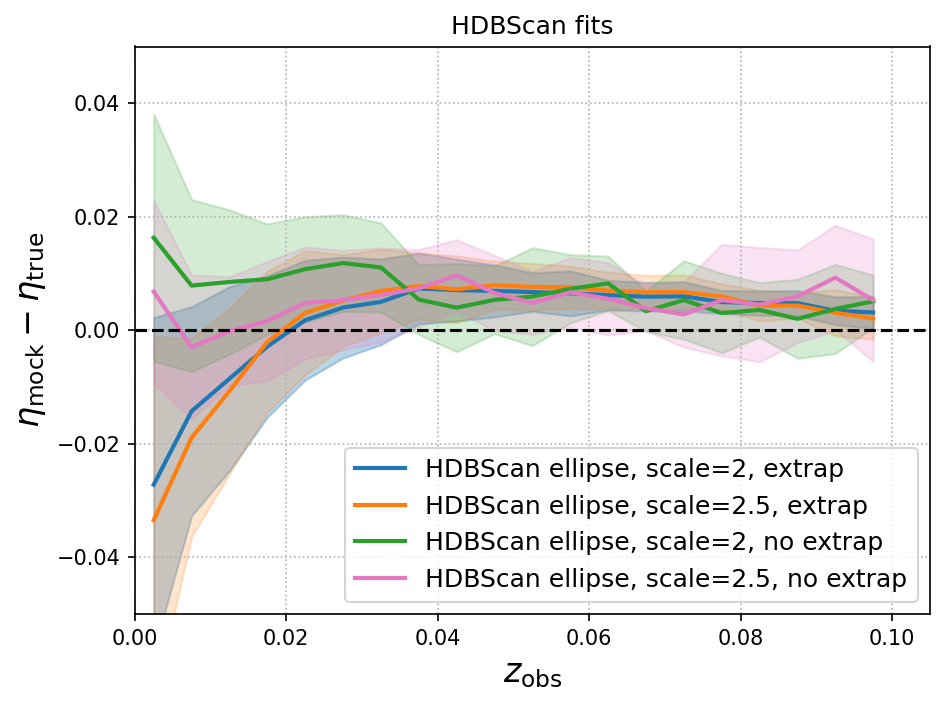

In [106]:
fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])

plt.grid(ls=':')

zc, eta_mean, eta_std = mean_delta_eta_z('mock_sig20_v5b_extrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:blue', label='HDBScan ellipse, scale=2, extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:blue', alpha=0.3)

zc, eta_mean, eta_std = mean_delta_eta_z('mock_sig25_v5b_extrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:orange', label='HDBScan ellipse, scale=2.5, extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:orange', alpha=0.2)

zc, eta_mean, eta_std = mean_delta_eta_z('mock_sig20_v5b_noextrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:green', label='HDBScan ellipse, scale=2, no extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:green', alpha=0.2)

zc, eta_mean, eta_std = mean_delta_eta_z('mock_sig25_v5b_noextrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:pink', label='HDBScan ellipse, scale=2.5, no extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:pink', alpha=0.2)

# Line at eta = 0
plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
# -------------------------------------------------------------------------------

plt.legend(fontsize=12, loc='lower right')
plt.title('HDBScan fits')
plt.xlabel(r'$z_\mathrm{obs}$', fontsize=16)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)

plt.xlim(0,0.105)
plt.ylim(-0.05, 0.05);

# fig.savefig('tfr_mock_eta.png', dpi=150);

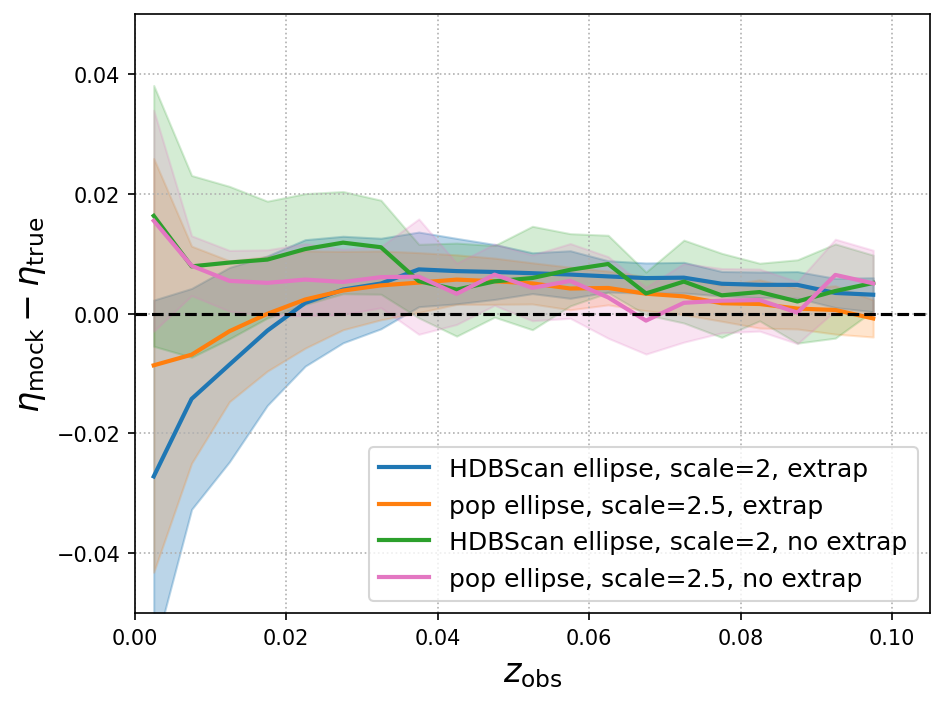

In [107]:
fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])

plt.grid(ls=':')

zc, eta_mean, eta_std = mean_delta_eta_z('mock_sig20_v5b_extrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:blue', label='HDBScan ellipse, scale=2, extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:blue', alpha=0.3)

zc, eta_mean, eta_std = mean_delta_eta_z('mock_sig25_v5_extrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:orange', label='pop ellipse, scale=2.5, extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:orange', alpha=0.2)

zc, eta_mean, eta_std = mean_delta_eta_z('mock_sig20_v5b_noextrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:green', label='HDBScan ellipse, scale=2, no extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:green', alpha=0.2)

zc, eta_mean, eta_std = mean_delta_eta_z('mock_sig25_v5_noextrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:pink', label='pop ellipse, scale=2.5, no extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:pink', alpha=0.2)

# Line at eta = 0
plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
# -------------------------------------------------------------------------------

plt.legend(fontsize=12, loc='lower right')
# plt.title('HDBScan fits')
plt.xlabel(r'$z_\mathrm{obs}$', fontsize=16)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)

plt.xlim(0,0.105)
plt.ylim(-0.05, 0.05);

# fig.savefig('tfr_mock_eta.png', dpi=150);

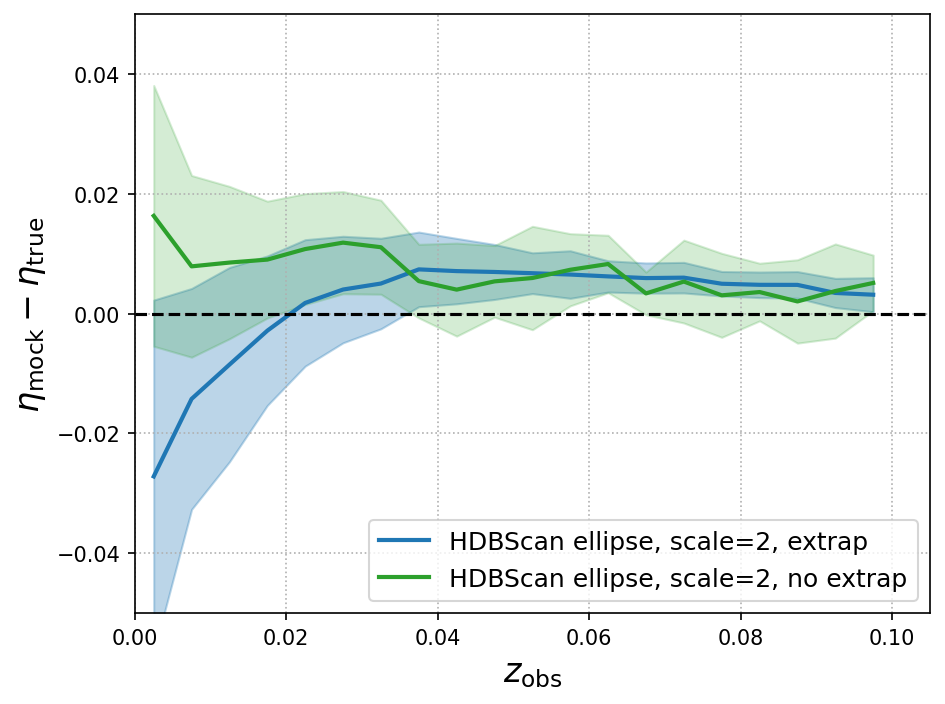

In [123]:
fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])

plt.grid(ls=':')

zc, eta_mean, eta_std = mean_delta_eta_z('mock_sig20_v5b_extrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:blue', label='HDBScan ellipse, scale=2, extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:blue', alpha=0.3)

# zc, eta_mean, eta_std = mean_delta_eta_z('mock_sig25_v5_extrap', n_mocks=10, zbins=_zbins)
# plt.plot(zc, eta_mean, lw=2, color='tab:orange', label='pop ellipse, scale=2.5, extrap')
# plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:orange', alpha=0.2)

zc, eta_mean, eta_std = mean_delta_eta_z('mock_sig20_v5b_noextrap', n_mocks=10, zbins=_zbins)
plt.plot(zc, eta_mean, lw=2, color='tab:green', label='HDBScan ellipse, scale=2, no extrap')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:green', alpha=0.2)

# zc, eta_mean, eta_std = mean_delta_eta_z('mock_sig25_v5_noextrap', n_mocks=10, zbins=_zbins)
# plt.plot(zc, eta_mean, lw=2, color='tab:pink', label='pop ellipse, scale=2.5, no extrap')
# plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, color='tab:pink', alpha=0.2)

# Line at eta = 0
plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
# -------------------------------------------------------------------------------

plt.legend(fontsize=12, loc='lower right')
# plt.title('HDBScan fits')
plt.xlabel(r'$z_\mathrm{obs}$', fontsize=16)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)

plt.xlim(0,0.105)
plt.ylim(-0.05, 0.05);

# fig.savefig('tfr_mock_eta.png', dpi=150);

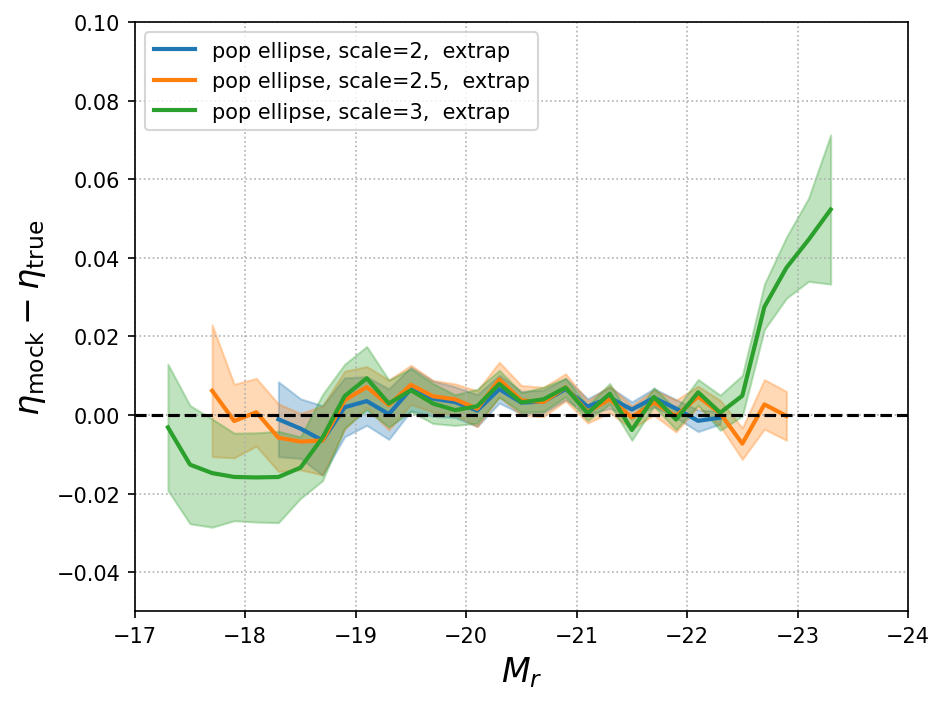

In [114]:
fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

Mr_bins = np.arange(-24, -17, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])

cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
plt.grid(ls=':')

# # True mock
# _, eta_avg, eta_std = profile_histogram(fit_cat_0['ZOBS'], 
#                                         fit_cat_0['LOGDIST_TRUE'], 
#                                         _zbins)
# plt.errorbar(zc, eta_avg, yerr=eta_std, fmt='x', color='k', label='mock (true)')

# Mock
mc, eta_mean, eta_std = mean_delta_eta_m('mock_sig20_v5_extrap', Mr_bins, n_mocks=10)
plt.plot(mc, eta_mean, lw=2, color='tab:blue', label='pop ellipse, scale=2,  extrap')
plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, color='tab:blue', alpha=0.3)

mc, eta_mean, eta_std = mean_delta_eta_m('mock_sig25_v5_extrap', Mr_bins, n_mocks=10)
plt.plot(mc, eta_mean, lw=2, color='tab:orange', label='pop ellipse, scale=2.5,  extrap')
plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, color='tab:orange', alpha=0.3)


mc, eta_mean, eta_std = mean_delta_eta_m('mock_sig30_v5_extrap', Mr_bins, n_mocks=10)
plt.plot(mc, eta_mean, lw=2, color='tab:green', label='pop ellipse, scale=3,  extrap')
plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, color='tab:green', alpha=0.3)

# Line at eta = 0

# Line at eta = 0
plt.hlines(0, -24, -17, linestyles='dashed', colors='k', zorder=5)
#-------------------------------------------------------------------------------

plt.legend(loc='upper left')
# plt.title('Population Fit')
plt.xlabel(r'$M_r$', fontsize=16)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)
plt.xlim(-17,-24)
plt.ylim(-0.05,0.1)
plt.show()
# plt.ylim(-0.05, 0.05);

# fig.savefig('tfr_mock_eta.png', dpi=150);

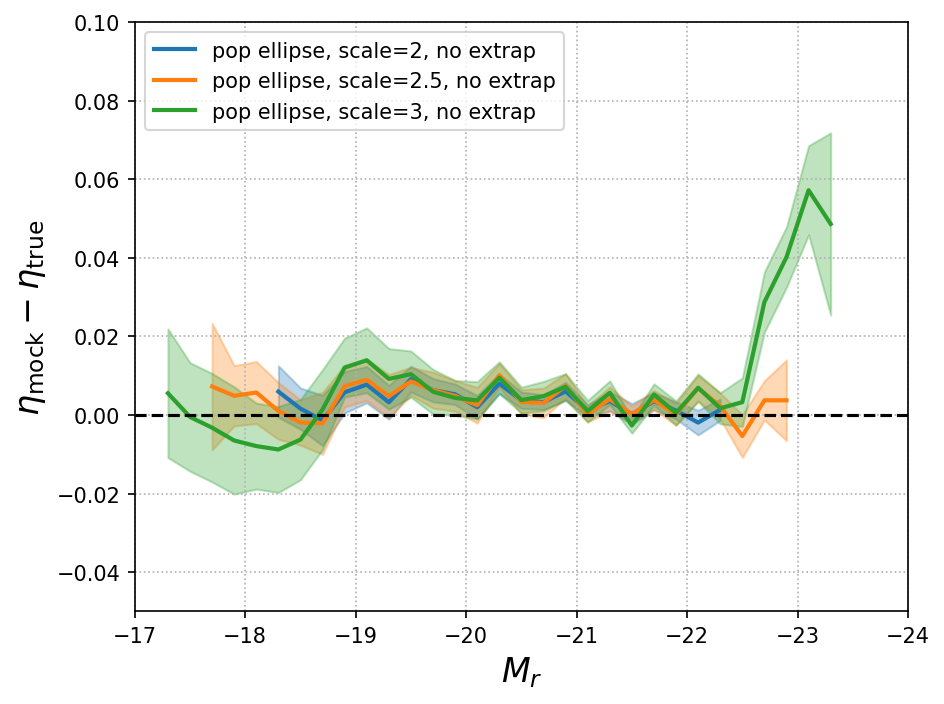

In [115]:
fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

Mr_bins = np.arange(-24, -17, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])

cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
plt.grid(ls=':')

# # True mock
# _, eta_avg, eta_std = profile_histogram(fit_cat_0['ZOBS'], 
#                                         fit_cat_0['LOGDIST_TRUE'], 
#                                         _zbins)
# plt.errorbar(zc, eta_avg, yerr=eta_std, fmt='x', color='k', label='mock (true)')

# Mock
mc, eta_mean, eta_std = mean_delta_eta_m('mock_sig20_v5_noextrap', Mr_bins, n_mocks=10)
plt.plot(mc, eta_mean, lw=2, color='tab:blue', label='pop ellipse, scale=2, no extrap')
plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, color='tab:blue', alpha=0.3)

mc, eta_mean, eta_std = mean_delta_eta_m('mock_sig25_v5_noextrap', Mr_bins, n_mocks=10)
plt.plot(mc, eta_mean, lw=2, color='tab:orange', label='pop ellipse, scale=2.5, no extrap')
plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, color='tab:orange', alpha=0.3)


mc, eta_mean, eta_std = mean_delta_eta_m('mock_sig30_v5_noextrap', Mr_bins, n_mocks=10)
plt.plot(mc, eta_mean, lw=2, color='tab:green', label='pop ellipse, scale=3, no extrap')
plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, color='tab:green', alpha=0.3)

# Line at eta = 0

# Line at eta = 0
plt.hlines(0, -24, -17, linestyles='dashed', colors='k', zorder=5)
#-------------------------------------------------------------------------------

plt.legend(loc='upper left')
# plt.title('Population Fit')
plt.xlabel(r'$M_r$', fontsize=16)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)
plt.xlim(-17,-24)
plt.ylim(-0.05,0.1)
plt.show()
# plt.ylim(-0.05, 0.05);

# fig.savefig('tfr_mock_eta.png', dpi=150);

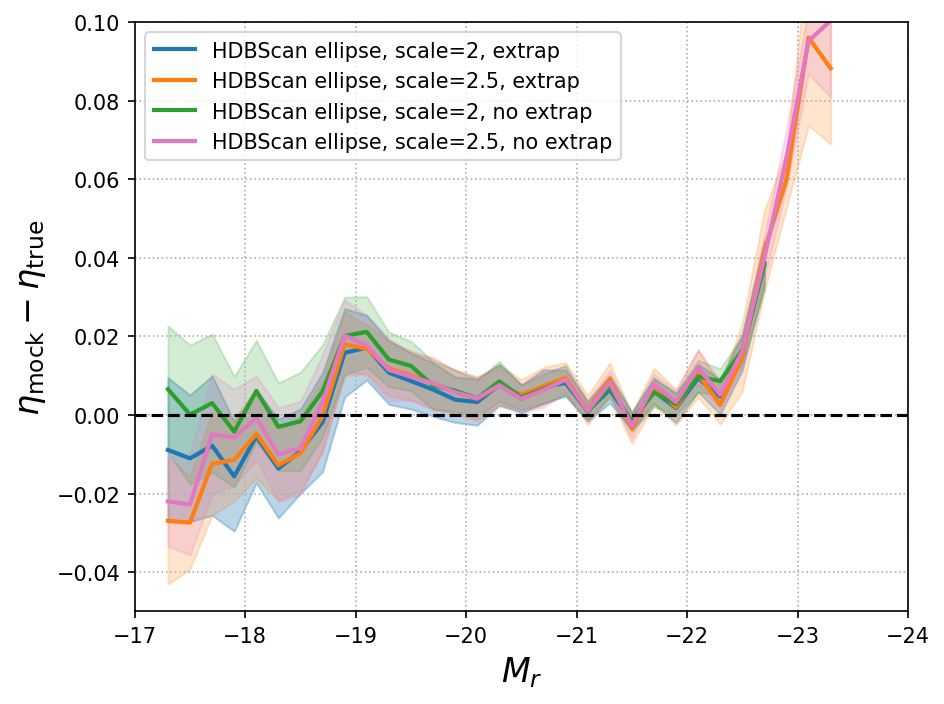

In [121]:
fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

Mr_bins = np.arange(-24, -17, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])

cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
plt.grid(ls=':')

# # True mock
# _, eta_avg, eta_std = profile_histogram(fit_cat_0['ZOBS'], 
#                                         fit_cat_0['LOGDIST_TRUE'], 
#                                         _zbins)
# plt.errorbar(zc, eta_avg, yerr=eta_std, fmt='x', color='k', label='mock (true)')

# Mock
mc, eta_mean, eta_std = mean_delta_eta_m('mock_sig20_v5b_extrap', Mr_bins, n_mocks=10)
plt.plot(mc, eta_mean, lw=2, color='tab:blue', label='HDBScan ellipse, scale=2, extrap')
plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, color='tab:blue', alpha=0.3)

mc, eta_mean, eta_std = mean_delta_eta_m('mock_sig25_v5b_extrap', Mr_bins, n_mocks=10)
plt.plot(mc, eta_mean, lw=2, color='tab:orange', label='HDBScan ellipse, scale=2.5, extrap')
plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, color='tab:orange', alpha=0.2)

mc, eta_mean, eta_std = mean_delta_eta_m('mock_sig20_v5b_noextrap', Mr_bins, n_mocks=10)
plt.plot(mc, eta_mean, lw=2, color='tab:green', label='HDBScan ellipse, scale=2, no extrap')
plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, color='tab:green', alpha=0.2)

mc, eta_mean, eta_std = mean_delta_eta_m('mock_sig25_v5b_noextrap', Mr_bins, n_mocks=10)
plt.plot(mc, eta_mean, lw=2, color='tab:pink', label='HDBScan ellipse, scale=2.5, no extrap')
plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, color='tab:pink', alpha=0.2)

# Line at eta = 0

# Line at eta = 0
plt.hlines(0, -24, -17, linestyles='dashed', colors='k', zorder=5)
#-------------------------------------------------------------------------------

plt.legend(loc='upper left')
# plt.title('Population Fit')
plt.xlabel(r'$M_r$', fontsize=16)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)
plt.xlim(-17,-24)
plt.ylim(-0.05,0.1)
plt.show()
# plt.ylim(-0.05, 0.05);

# fig.savefig('tfr_mock_eta.png', dpi=150);

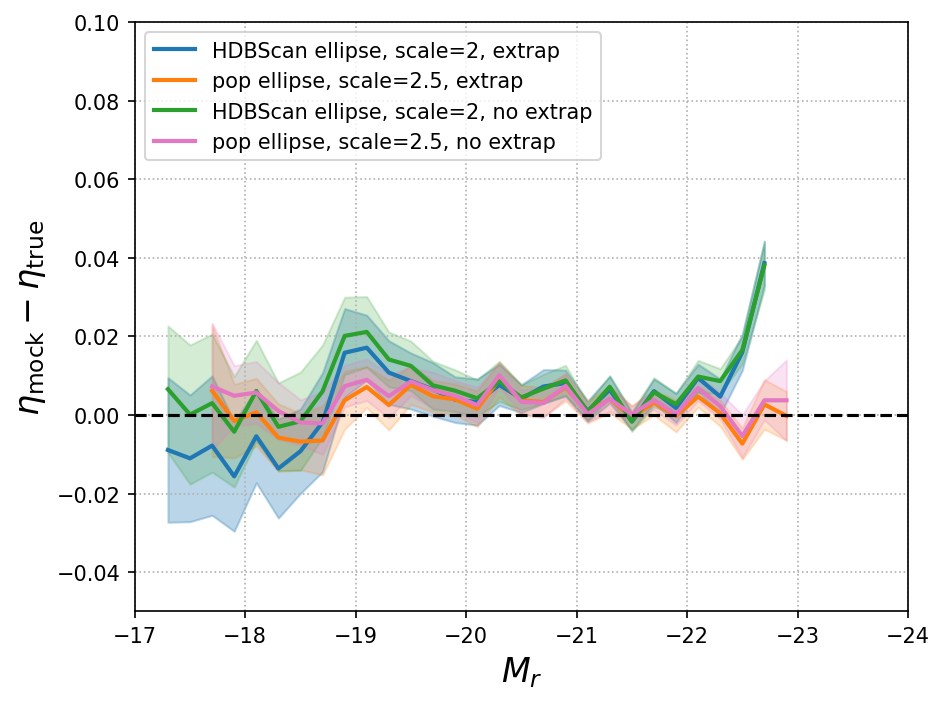

In [118]:
fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

Mr_bins = np.arange(-24, -17, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])

cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
plt.grid(ls=':')

# # True mock
# _, eta_avg, eta_std = profile_histogram(fit_cat_0['ZOBS'], 
#                                         fit_cat_0['LOGDIST_TRUE'], 
#                                         _zbins)
# plt.errorbar(zc, eta_avg, yerr=eta_std, fmt='x', color='k', label='mock (true)')

# Mock
mc, eta_mean, eta_std = mean_delta_eta_m('mock_sig20_v5b_extrap', Mr_bins, n_mocks=10)
plt.plot(mc, eta_mean, lw=2, color='tab:blue', label='HDBScan ellipse, scale=2, extrap')
plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, color='tab:blue', alpha=0.3)

mc, eta_mean, eta_std = mean_delta_eta_m('mock_sig25_v5_extrap', Mr_bins, n_mocks=10)
plt.plot(mc, eta_mean, lw=2, color='tab:orange', label='pop ellipse, scale=2.5, extrap')
plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, color='tab:orange', alpha=0.2)

mc, eta_mean, eta_std = mean_delta_eta_m('mock_sig20_v5b_noextrap', Mr_bins, n_mocks=10)
plt.plot(mc, eta_mean, lw=2, color='tab:green', label='HDBScan ellipse, scale=2, no extrap')
plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, color='tab:green', alpha=0.2)

mc, eta_mean, eta_std = mean_delta_eta_m('mock_sig25_v5_noextrap', Mr_bins, n_mocks=10)
plt.plot(mc, eta_mean, lw=2, color='tab:pink', label='pop ellipse, scale=2.5, no extrap')
plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, color='tab:pink', alpha=0.2)

# Line at eta = 0

# Line at eta = 0
plt.hlines(0, -24, -17, linestyles='dashed', colors='k', zorder=5)
#-------------------------------------------------------------------------------

plt.legend(loc='upper left')
# plt.title('Population Fit')
plt.xlabel(r'$M_r$', fontsize=16)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)
plt.xlim(-17,-24)
plt.ylim(-0.05,0.1)
plt.show()
# plt.ylim(-0.05, 0.05);

# fig.savefig('tfr_mock_eta.png', dpi=150);

# Do the parameter tests for bin width variations

In [98]:
##### Read in all of the mock files

for i in range(10):
    ## population density fits
    for j in {0.005, 0.006, 0.0075}:
        version='v5'
        globals()[f'mock_dz{int(j*1e4)}_{version}_zmin1_extrap_{i}'] = Table.read(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2.5_dz={j}_zmin=0.01_mockidx={60*i}_extrap.fits')
        globals()[f'mock_dz{int(j*1e4)}_{version}_zmin1_noextrap_{i}'] = Table.read(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2.5_dz={j}_zmin=0.01_mockidx={60*i}_noextrap.fits')

        globals()[f'mock_dz{int(j*1e4)}_{version}_zmin3_extrap_{i}'] = Table.read(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2.5_dz={j}_zmin=0.03_mockidx={60*i}_extrap.fits')
        globals()[f'mock_dz{int(j*1e4)}_{version}_zmin3_noextrap_{i}'] = Table.read(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2.5_dz={j}_zmin=0.03_mockidx={60*i}_noextrap.fits')

        
        version='v5b'
        globals()[f'mock_dz{int(j*1e4)}_{version}_zmin1_extrap_{i}'] = Table.read(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2_dz={j}_zmin=0.01_mockidx={60*i}_extrap.fits')
        globals()[f'mock_dz{int(j*1e4)}_{version}_zmin1_noextrap_{i}'] = Table.read(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2_dz={j}_zmin=0.01_mockidx={60*i}_noextrap.fits')

        globals()[f'mock_dz{int(j*1e4)}_{version}_zmin3_extrap_{i}'] = Table.read(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2_dz={j}_zmin=0.03_mockidx={60*i}_extrap.fits')
        globals()[f'mock_dz{int(j*1e4)}_{version}_zmin3_noextrap_{i}'] = Table.read(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2_dz={j}_zmin=0.03_mockidx={60*i}_noextrap.fits')

        version='v7'
        globals()[f'mock_dz{int(j*1e4)}_{version}_zmin1_extrap_{i}'] = Table.read(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2.5_dz={j}_zmin=0.01_mockidx={60*i}_extrap.fits')
        globals()[f'mock_dz{int(j*1e4)}_{version}_zmin1_noextrap_{i}'] = Table.read(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2.5_dz={j}_zmin=0.01_mockidx={60*i}_noextrap.fits')

        globals()[f'mock_dz{int(j*1e4)}_{version}_zmin3_extrap_{i}'] = Table.read(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2.5_dz={j}_zmin=0.03_mockidx={60*i}_extrap.fits')
        globals()[f'mock_dz{int(j*1e4)}_{version}_zmin3_noextrap_{i}'] = Table.read(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2.5_dz={j}_zmin=0.03_mockidx={60*i}_noextrap.fits')


## Look at how the minimum calibration bin and extrapolations change within each bin size and ellipse type

(-0.05, 0.05)

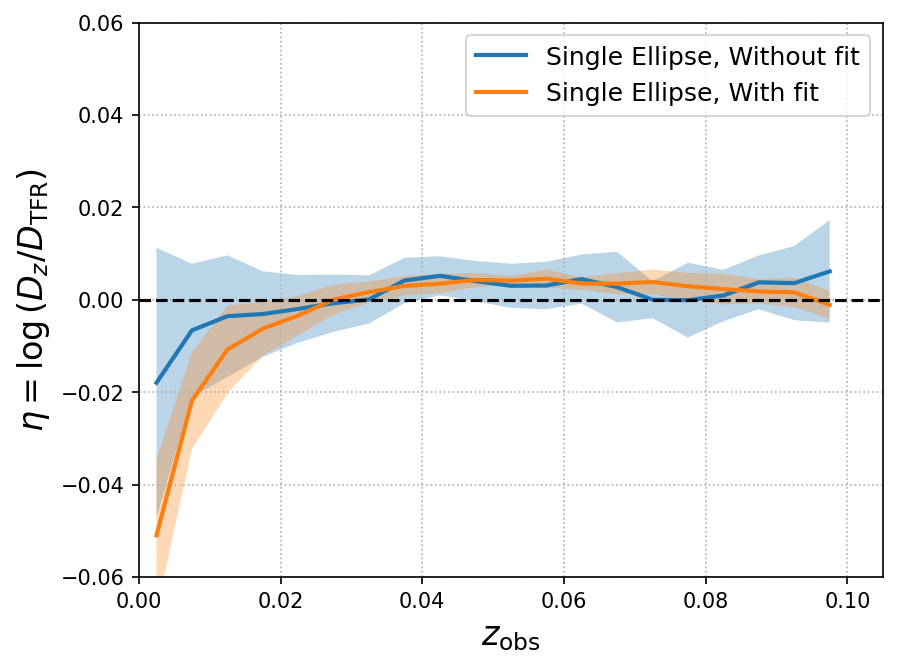

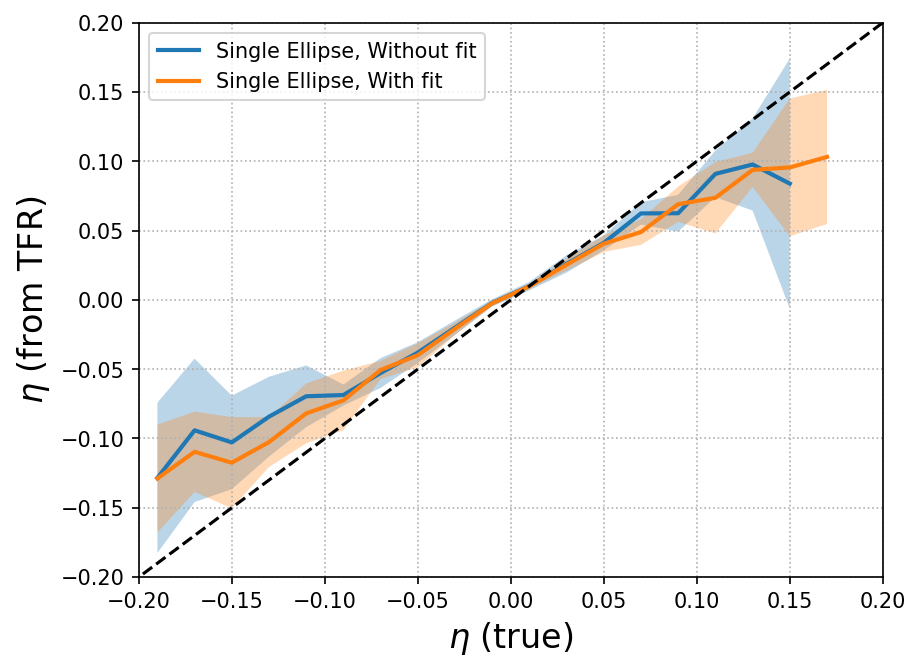

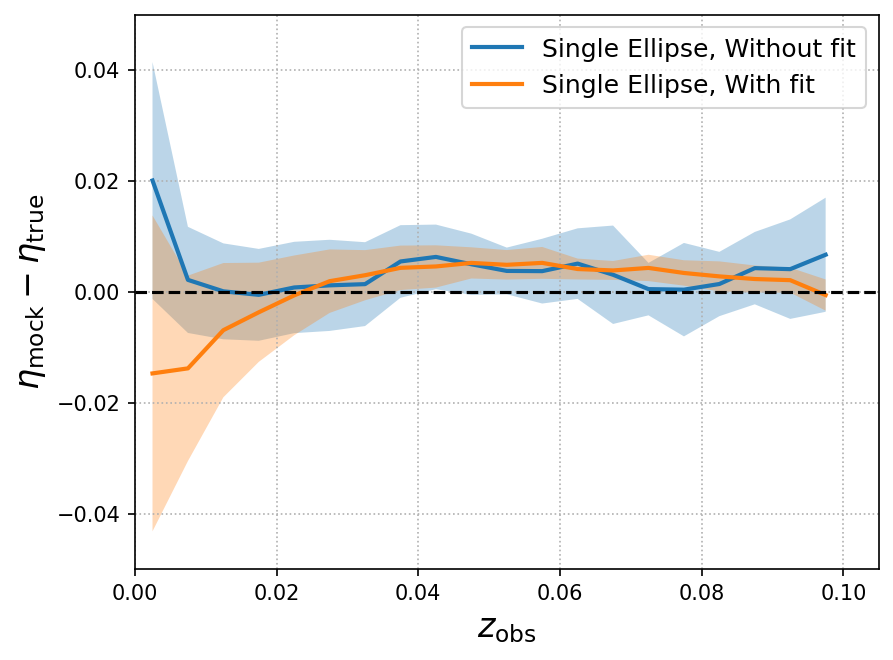

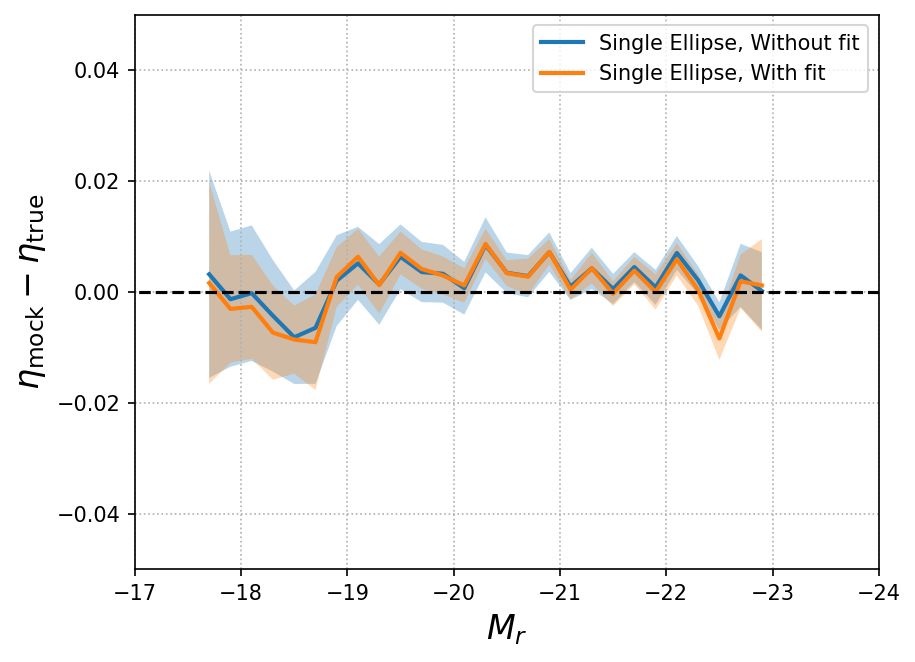

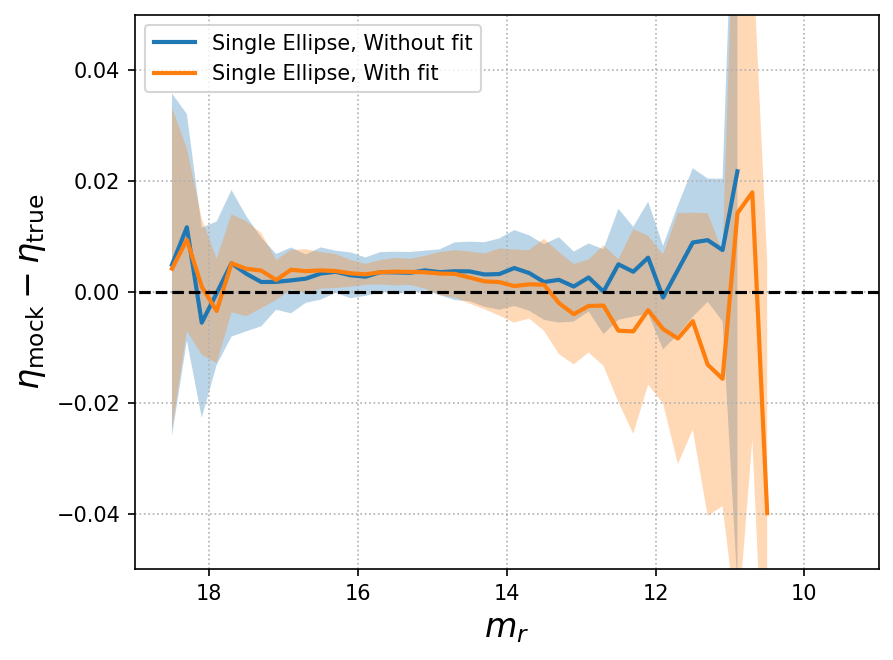

In [106]:
# fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)
i='v5'
width=50
k=3
# _zbins = np.arange(0, 0.105, 0.005)
# dz = 0.5*np.diff(_zbins)
# zc = 0.5*(_zbins[1:] + _zbins[:-1])
cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
# plt.grid(ls=':')

plt.figure(facecolor='none',dpi=150)
plt.grid(ls=':')

dz=0.005
zmin = 0.03
zmax = 0.105
_zbins = np.arange(0, zmax, dz)

# dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])
_, eta_mean, eta_std = mean_eta_z(f'mock_dz{width}_{i}_zmin{k}_noextrap', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label=f'Single Ellipse, Without fit')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
            
_, eta_mean, eta_std = mean_eta_z(f'mock_dz{width}_{i}_zmin{k}_extrap', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label=f'Single Ellipse, With fit')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
            
# Line at eta = 0
plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
# -------------------------------------------------------------------------------

plt.legend(fontsize=12)
# plt.title('Population density fits')
plt.xlabel(r'$z_\mathrm{obs}$', fontsize=16)
plt.ylabel(r'$\eta = \log{(D_z / D_\mathrm{TFR})}$', fontsize=16)
                

plt.xlim(0,0.105)
plt.ylim(-0.06, 0.06);
# plt.show()


eta_bins = np.arange(-0.5, 0.3, 0.02)
d_eta = 0.5*np.diff(eta_bins)
eta_c = 0.5*(eta_bins[1:] + eta_bins[:-1])


plt.figure(facecolor='none', dpi=150)
plt.grid(ls=':')

eta_c, eta_mean, eta_std = mean_eta_eta(f'mock_dz{width}_{i}_zmin{k}_noextrap', eta_bins, n_mocks=10)
        
plt.plot(eta_c, eta_mean, lw=2, label=f'Single Ellipse, Without fit')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

eta_c, eta_mean, eta_std = mean_eta_eta(f'mock_dz{width}_{i}_zmin{k}_extrap', eta_bins, n_mocks=10)
        
plt.plot(eta_c, eta_mean, lw=2, label=f'Single Ellipse, With fit')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
        
plt.grid(ls=':')
plt.plot([-5, 2], [-5, 2], '--', c='k')
plt.xlim([-0.2, 0.2])
plt.ylim([-0.2, 0.2])
plt.legend()
# plt.title('Population Fit', fontsize=16)
plt.xlabel(r'$\eta$ (true)', fontsize=16)
plt.ylabel(r'$\eta$ (from TFR)', fontsize=16);

# fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])
cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
plt.figure(facecolor='none', dpi=150)
plt.grid(ls=':')

_, eta_mean, eta_std = mean_delta_eta_z(f'mock_dz{width}_{i}_zmin{k}_noextrap', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label=f'Single Ellipse, Without fit')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

_, eta_mean, eta_std = mean_delta_eta_z(f'mock_dz{width}_{i}_zmin{k}_extrap', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label=f'Single Ellipse, With fit')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

# Line at eta = 0
plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
# -------------------------------------------------------------------------------

plt.legend(fontsize=12)
# plt.title('Population density fits')
plt.xlabel(r'$z_\mathrm{obs}$', fontsize=16)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)

plt.xlim(0,0.105)
plt.ylim(-0.05, 0.05);
# plt.show()


Mr_bins = np.arange(-24, -17, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])

plt.figure(facecolor='none', dpi=150)
plt.grid(ls=':')


mc, eta_mean, eta_std = mean_delta_eta_m(f'mock_dz{width}_{i}_zmin{k}_noextrap', Mr_bins, n_mocks=10)

plt.plot(mc, eta_mean, lw=2, label=f'Single Ellipse, Without fit')
plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

mc, eta_mean, eta_std = mean_delta_eta_m(f'mock_dz{width}_{i}_zmin{k}_extrap', Mr_bins, n_mocks=10)

plt.plot(mc, eta_mean, lw=2, label=f'Single Ellipse, With fit')
plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
                
plt.hlines(0, -24, -17, linestyles='dashed', colors='k', zorder=5)
plt.legend()
plt.xlabel(r'$M_r$', fontsize=16)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)
plt.xlim(-17,-24)
plt.ylim(-0.05,0.05)
            
mr_bins = np.arange(9, 19, 0.2)
dmr = 0.5*np.diff(mr_bins)
mrc = 0.5*(mr_bins[1:] + mr_bins[:-1])


plt.figure(facecolor='none', dpi=150)
plt.grid(ls=':')


mc, eta_mean, eta_std = mean_delta_eta_appm(f'mock_dz{width}_{i}_zmin{k}_noextrap', mr_bins, n_mocks=10)

plt.plot(mc, eta_mean, lw=2, label=f'Single Ellipse, Without fit')
plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
        
mc, eta_mean, eta_std = mean_delta_eta_appm(f'mock_dz{width}_{i}_zmin{k}_extrap', mr_bins, n_mocks=10)

plt.plot(mc, eta_mean, lw=2, label=f'Single Ellipse, With fit')
plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
        
plt.hlines(0, 9, 19, linestyles='dashed', colors='k', zorder=5)
plt.legend(loc='upper left')
plt.xlabel(r'$m_r$', fontsize=16)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)
plt.xlim(19,9 )
plt.ylim(-0.05,0.05)
            
# fig.savefig('tfr_mock_eta.png', dpi=150);

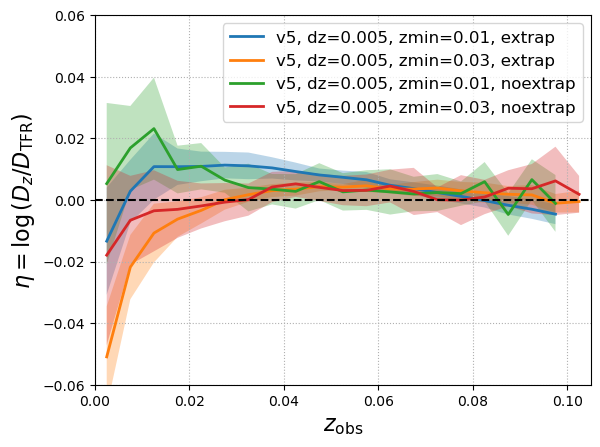

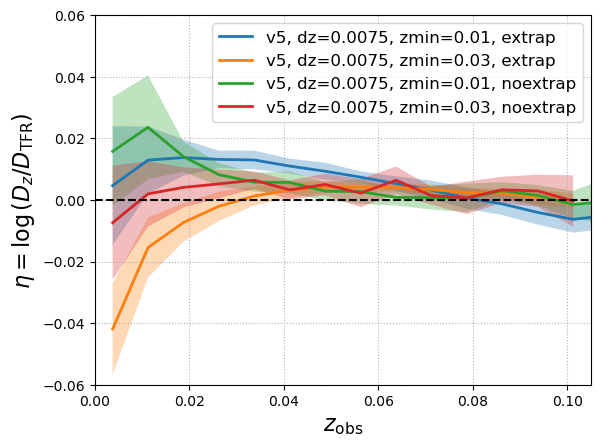

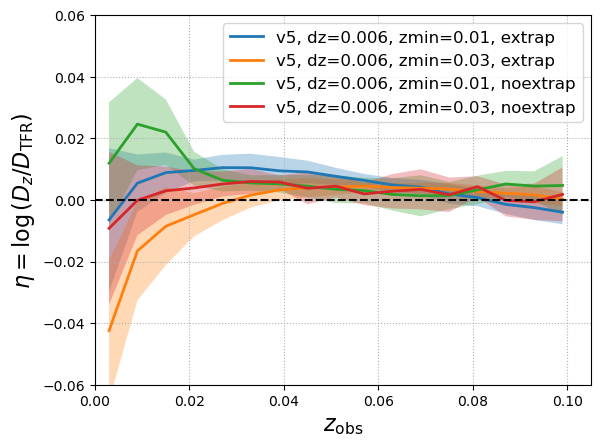

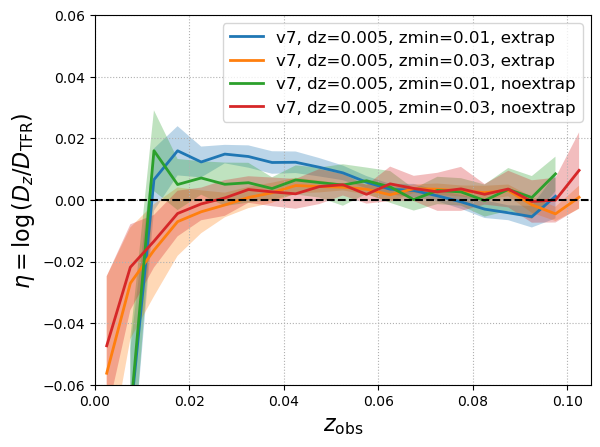

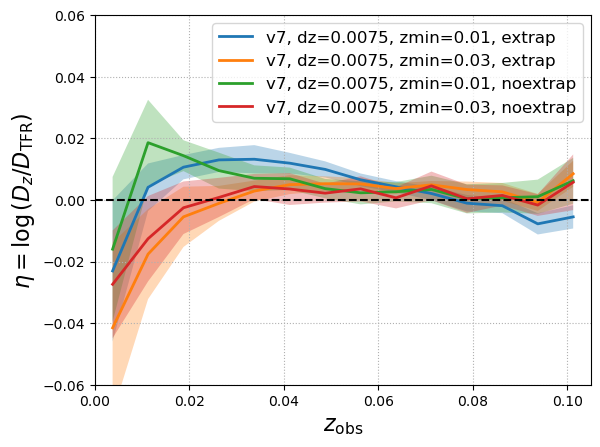

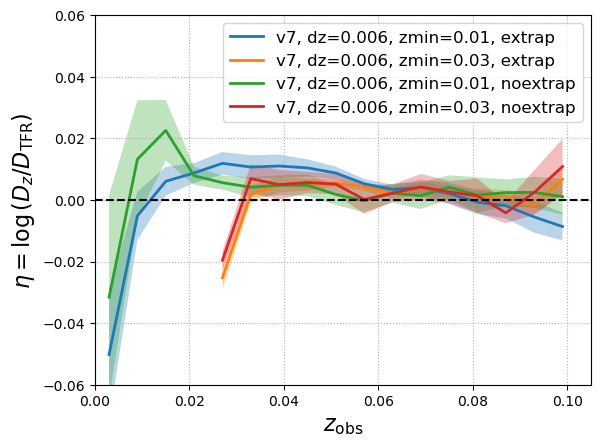

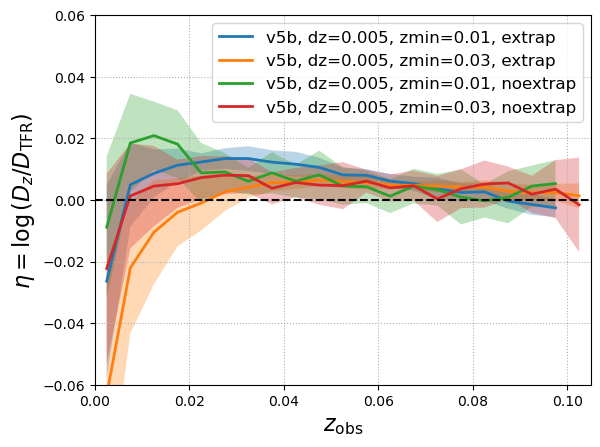

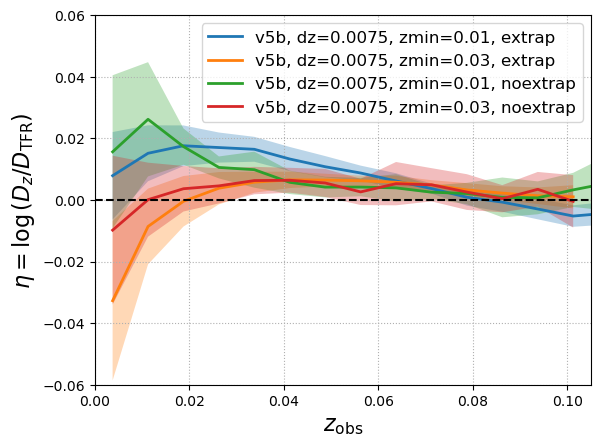

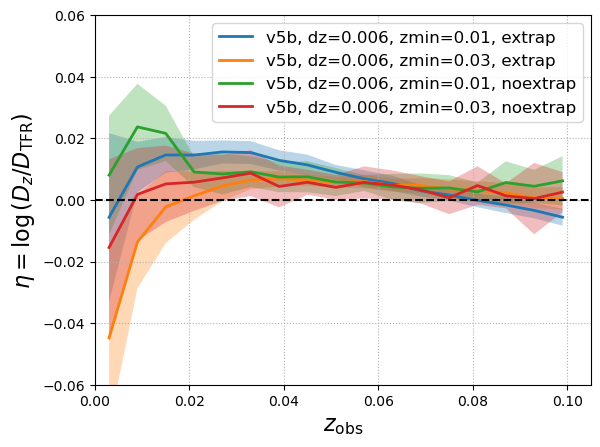

In [15]:
# fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])
cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
# plt.grid(ls=':')

for i in {'v5', 'v5b', 'v7'}:
    for width in {50, 60, 75}:
        plt.figure()
        plt.grid(ls=':')

        for j in {'extrap', 'noextrap'}:
            for k in {1,3}:
                dz=width/10000
                zmin = (k/100)
                zmax = zmin +  math.ceil(1+((0.1-zmin)/dz))*dz

                _zbins = np.arange(0, zmax, dz)
                # dz = 0.5*np.diff(_zbins)
                zc = 0.5*(_zbins[1:] + _zbins[:-1])
                _, eta_mean, eta_std = mean_eta_z(f'mock_dz{width}_{i}_zmin{k}_{j}', n_mocks=10, zbins=_zbins)
                
                plt.plot(zc, eta_mean, lw=2, label=f'{i}, dz={dz}, zmin={zmin}, {j}')
                plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
            

        # Line at eta = 0
        plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
        # -------------------------------------------------------------------------------
        
        plt.legend(fontsize=12)
        # plt.title('Population density fits')
        plt.xlabel(r'$z_\mathrm{obs}$', fontsize=16)
        plt.ylabel(r'$\eta = \log{(D_z / D_\mathrm{TFR})}$', fontsize=16)
        
        plt.xlim(0,0.105)
        plt.ylim(-0.06, 0.06);
        # plt.show()

# fig.savefig('tfr_mock_eta.png', dpi=150);

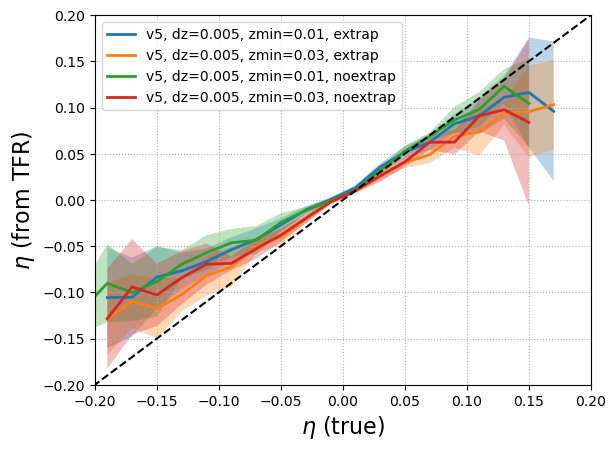

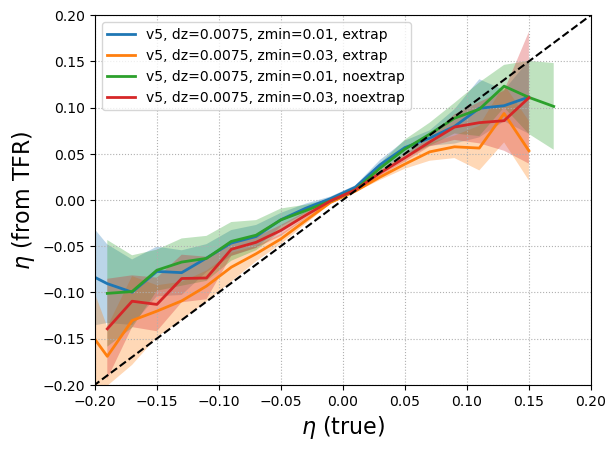

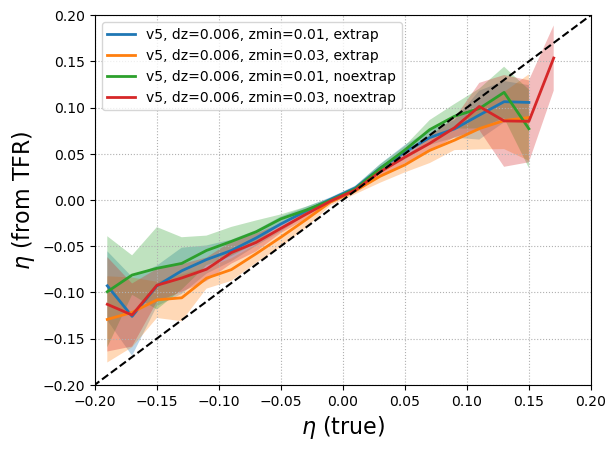

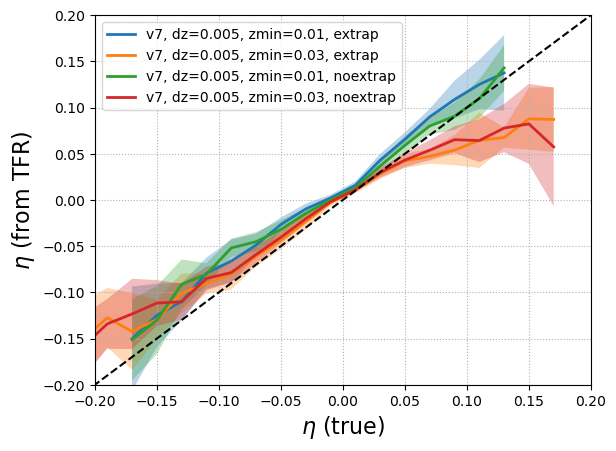

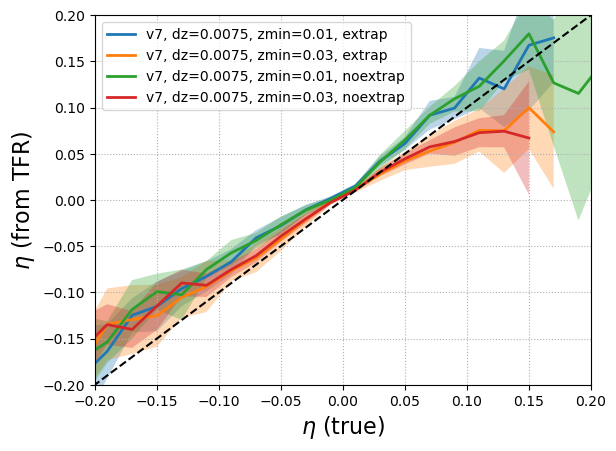

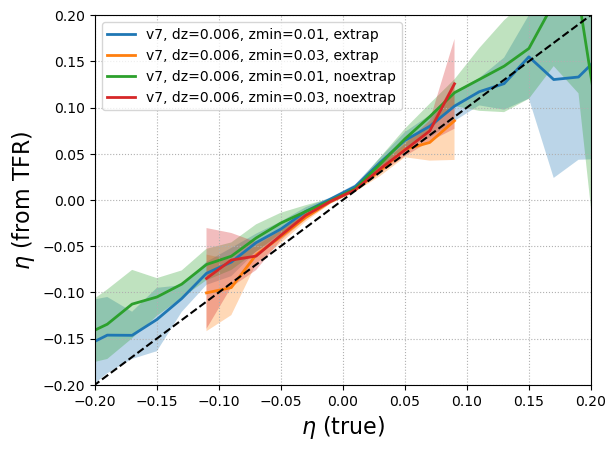

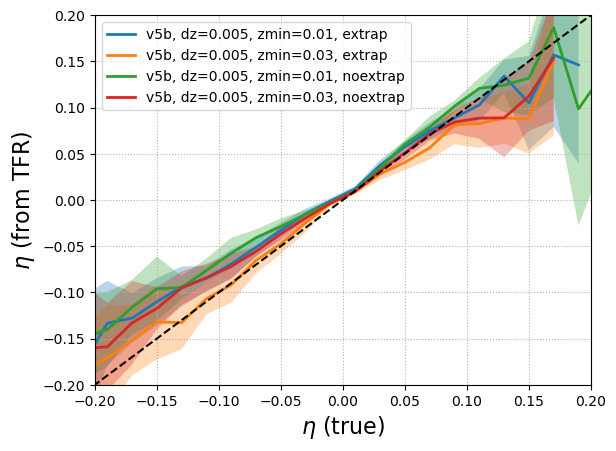

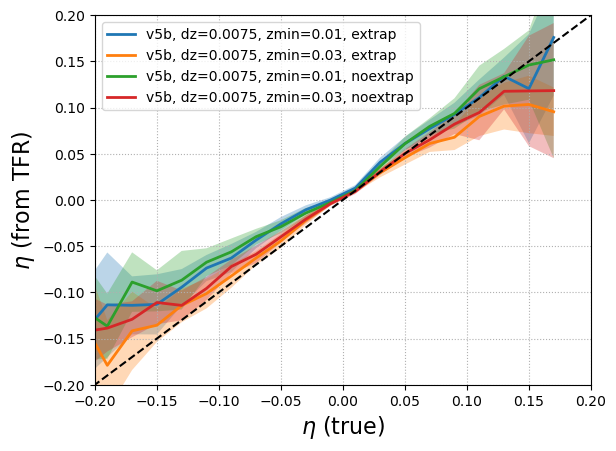

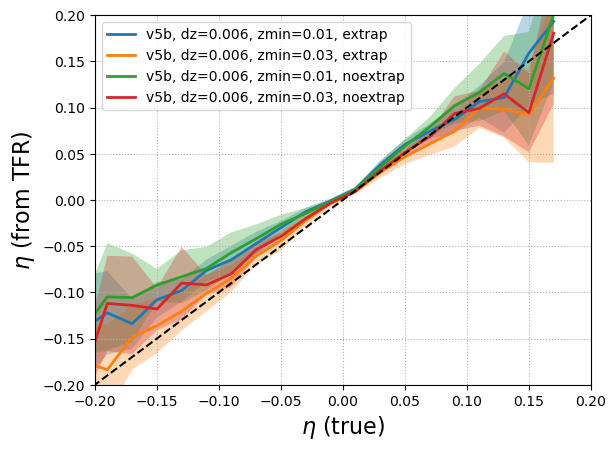

In [16]:
eta_bins = np.arange(-0.5, 0.3, 0.02)
d_eta = 0.5*np.diff(eta_bins)
eta_c = 0.5*(eta_bins[1:] + eta_bins[:-1])

for i in {'v5', 'v5b', 'v7'}:
    for width in {50, 60, 75}:
        plt.figure()
        plt.grid(ls=':')

        for j in {'extrap', 'noextrap'}:
            for k in {1,3}:
                dz=width/10000
                zmin = (k/100)
                eta_c, eta_mean, eta_std = mean_eta_eta(f'mock_dz{width}_{i}_zmin{k}_{j}', eta_bins, n_mocks=10)
                
                plt.plot(eta_c, eta_mean, lw=2, label=f'{i}, dz={dz}, zmin={zmin}, {j}')
                plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
                
        plt.grid(ls=':')
        plt.plot([-5, 2], [-5, 2], '--', c='k')
        plt.xlim([-0.2, 0.2])
        plt.ylim([-0.2, 0.2])
        plt.legend()
        # plt.title('Population Fit', fontsize=16)
        plt.xlabel(r'$\eta$ (true)', fontsize=16)
        plt.ylabel(r'$\eta$ (from TFR)', fontsize=16);
            

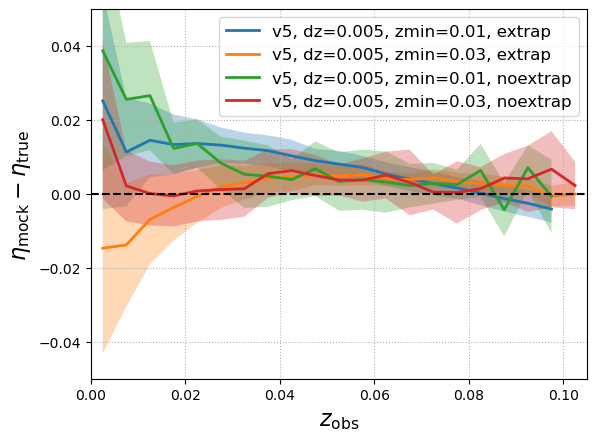

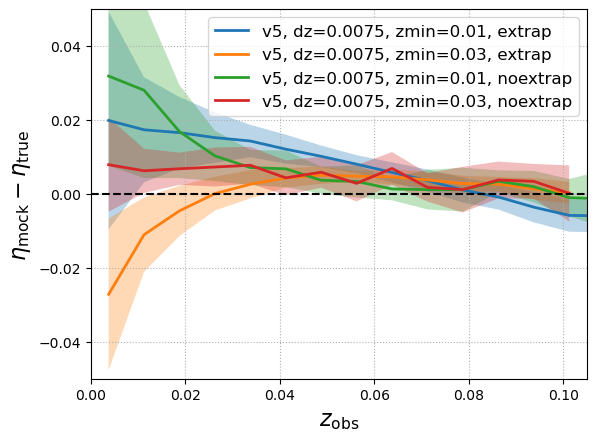

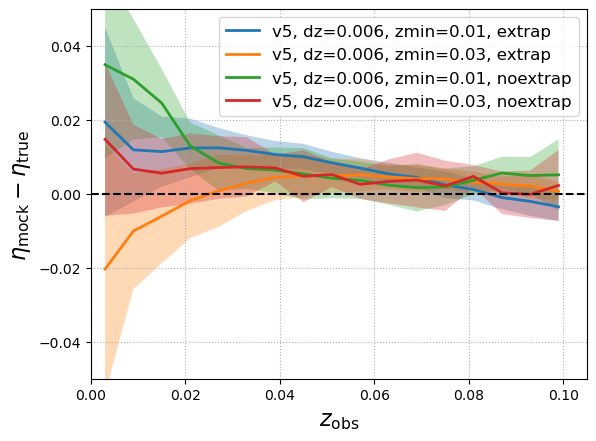

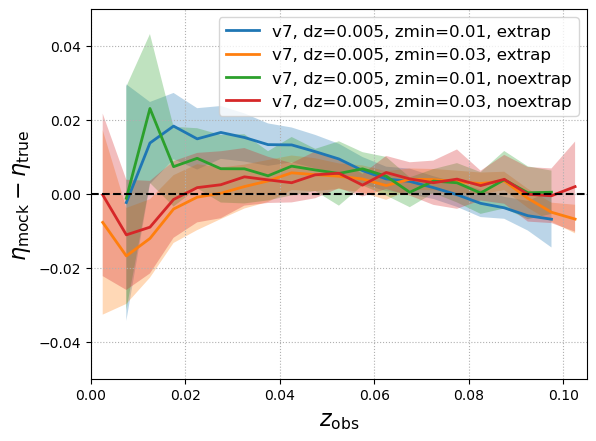

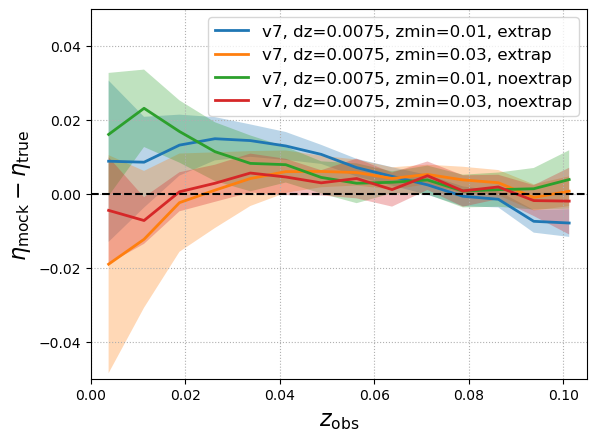

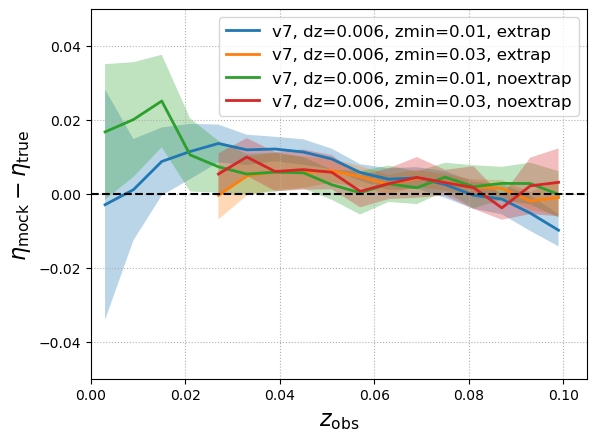

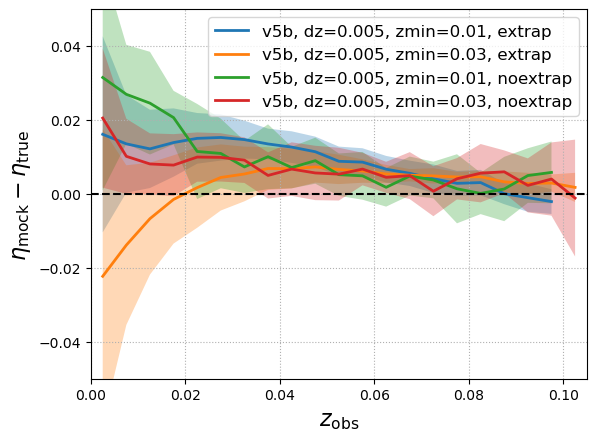

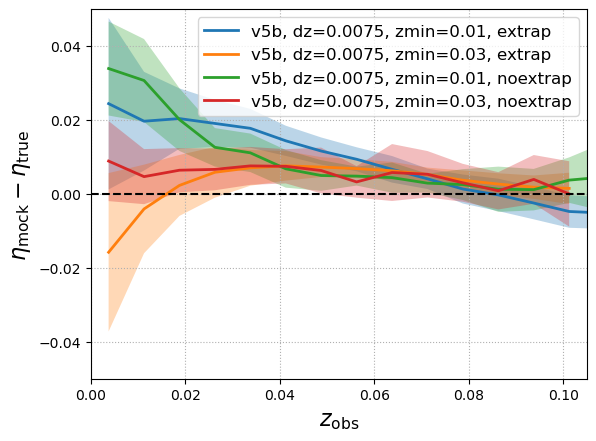

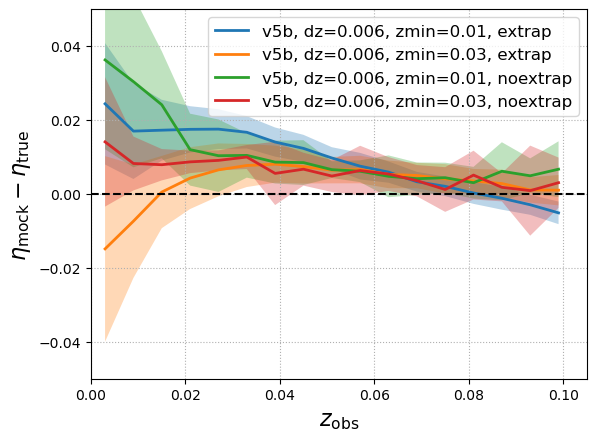

In [17]:
# fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])
cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
# plt.grid(ls=':')

for i in {'v5', 'v5b', 'v7'}:
    for width in {50, 60, 75}:
        plt.figure()
        plt.grid(ls=':')

        for j in {'extrap', 'noextrap'}:
            for k in {1,3}:
                dz=width/10000
                zmin = (k/100)
                zmax = zmin +  math.ceil(1+((0.1-zmin)/dz))*dz

                _zbins = np.arange(0, zmax, dz)
                # dz = 0.5*np.diff(_zbins)
                zc = 0.5*(_zbins[1:] + _zbins[:-1])
                _, eta_mean, eta_std = mean_delta_eta_z(f'mock_dz{width}_{i}_zmin{k}_{j}', n_mocks=10, zbins=_zbins)
                
                plt.plot(zc, eta_mean, lw=2, label=f'{i}, dz={dz}, zmin={zmin}, {j}')
                plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
            

        # Line at eta = 0
        plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
        # -------------------------------------------------------------------------------
        
        plt.legend(fontsize=12)
        # plt.title('Population density fits')
        plt.xlabel(r'$z_\mathrm{obs}$', fontsize=16)
        plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)
        
        plt.xlim(0,0.105)
        plt.ylim(-0.05, 0.05);
        # plt.show()

# fig.savefig('tfr_mock_eta.png', dpi=150);

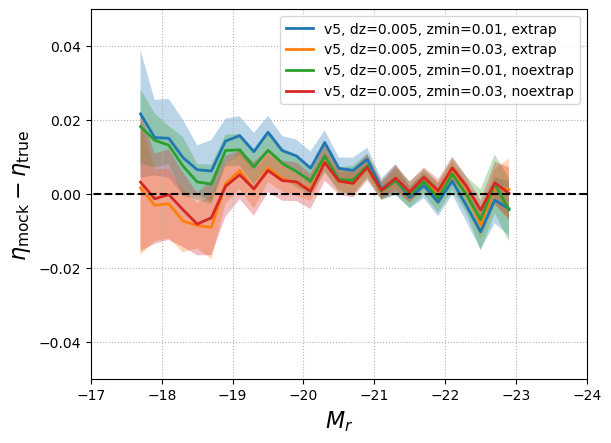

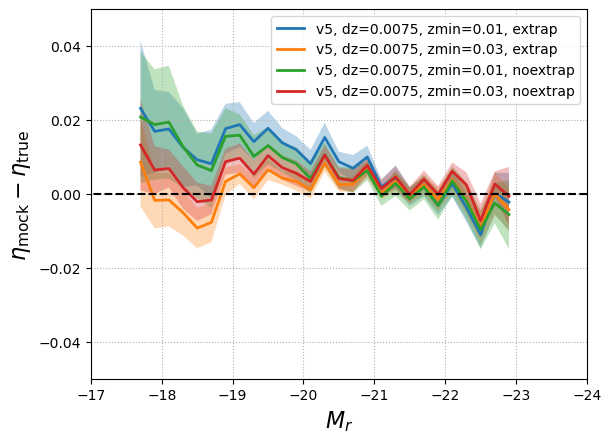

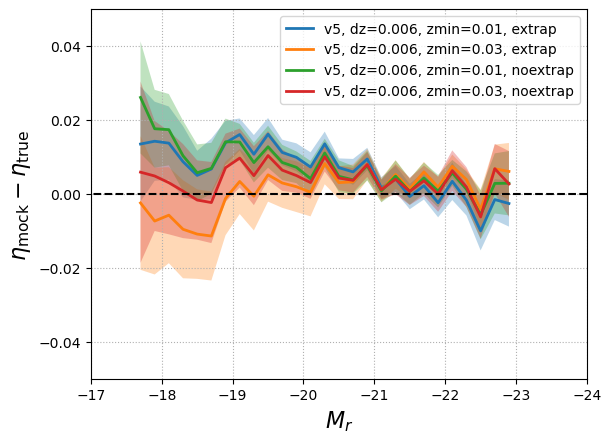

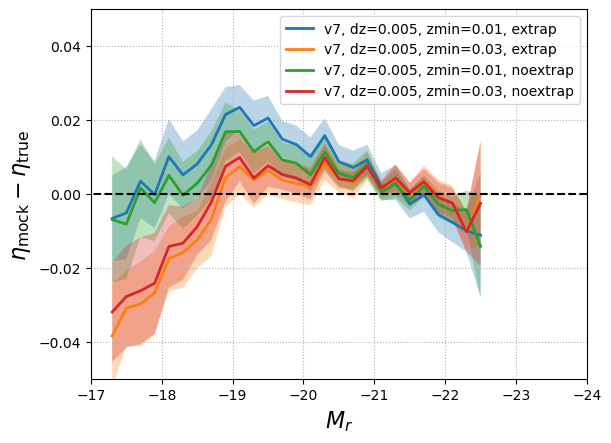

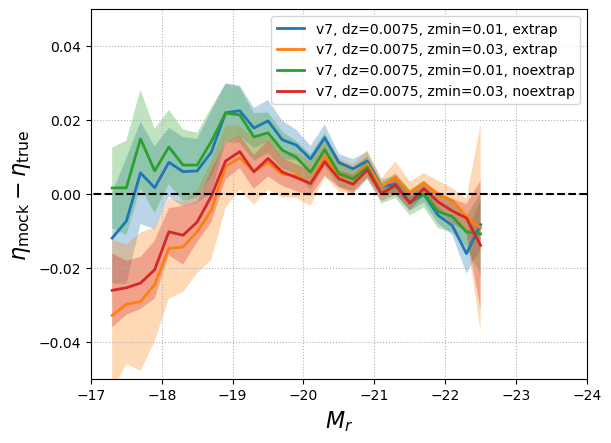

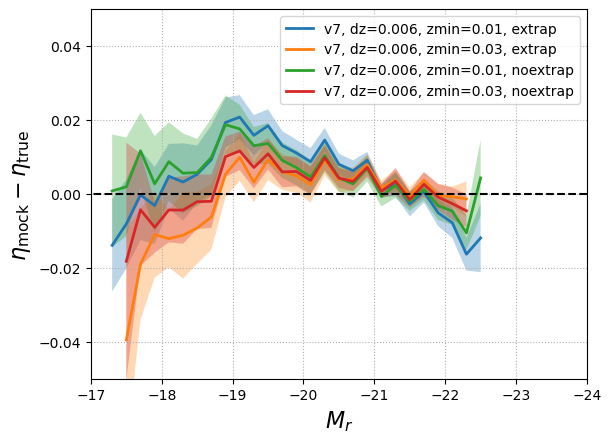

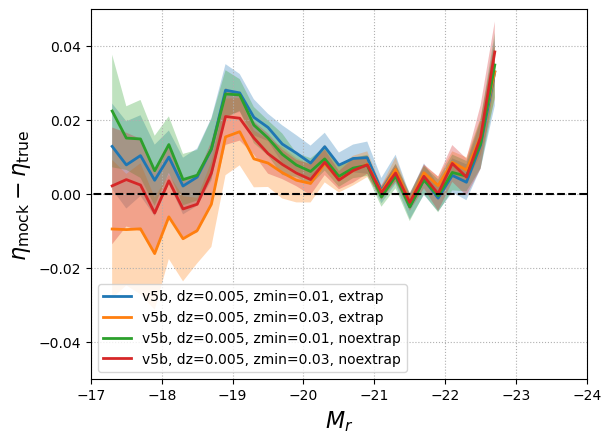

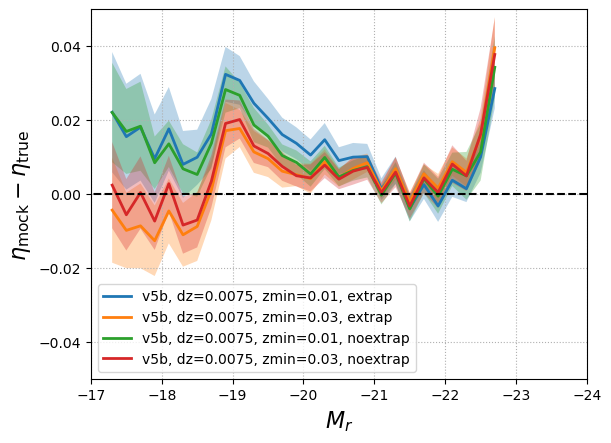

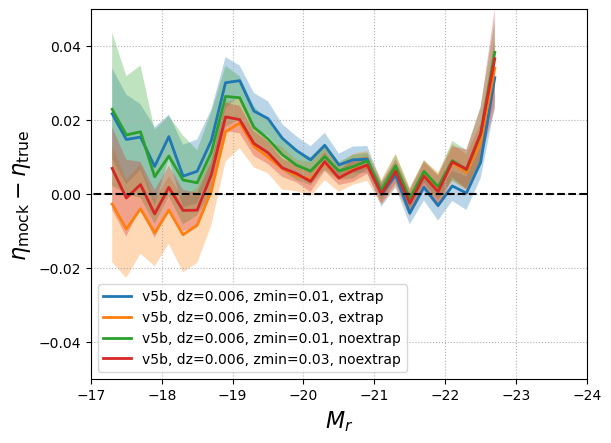

In [18]:
Mr_bins = np.arange(-24, -17, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])

for i in {'v5', 'v5b', 'v7'}:
    for width in {50, 60, 75}:
        plt.figure()
        plt.grid(ls=':')

        for j in {'extrap', 'noextrap'}:
            for k in {1,3}:
                dz=width/10000
                zmin = (k/100)
                mc, eta_mean, eta_std = mean_delta_eta_m(f'mock_dz{width}_{i}_zmin{k}_{j}', Mr_bins, n_mocks=10)
                
                plt.plot(mc, eta_mean, lw=2, label=f'{i}, dz={dz}, zmin={zmin}, {j}')
                plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
                
        plt.grid(ls=':')
        plt.hlines(0, -24, -17, linestyles='dashed', colors='k', zorder=5)
        plt.legend()
        plt.xlabel(r'$M_r$', fontsize=16)
        plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)
        plt.xlim(-17,-24)
        plt.ylim(-0.05,0.05)
            

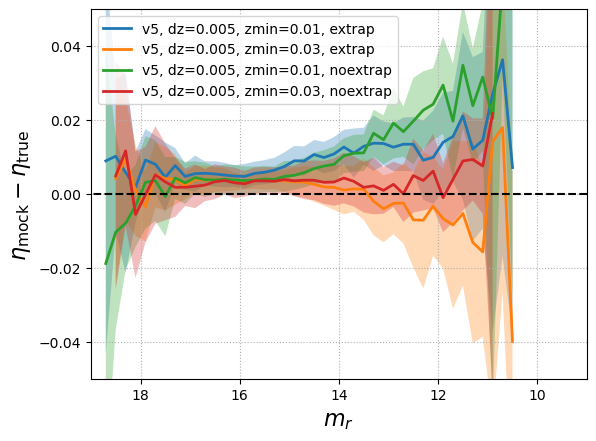

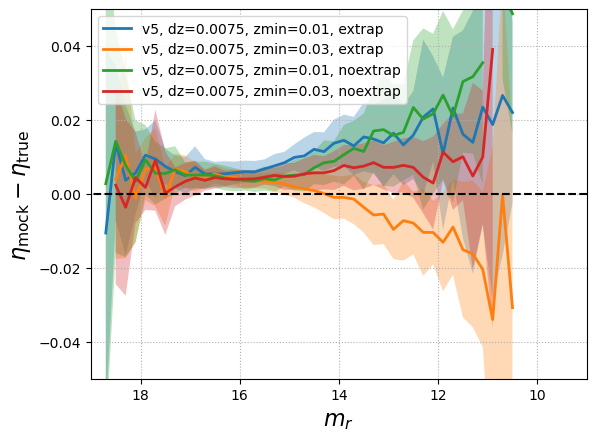

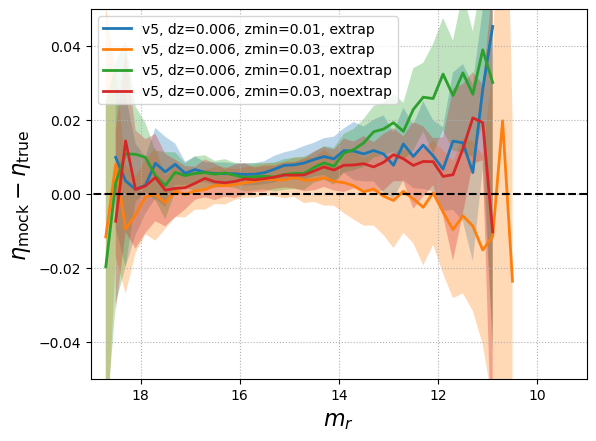

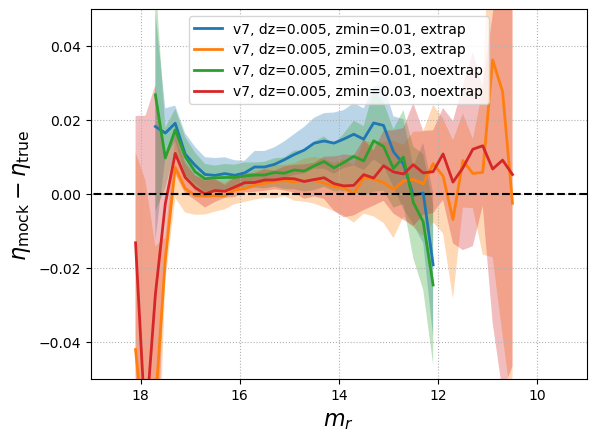

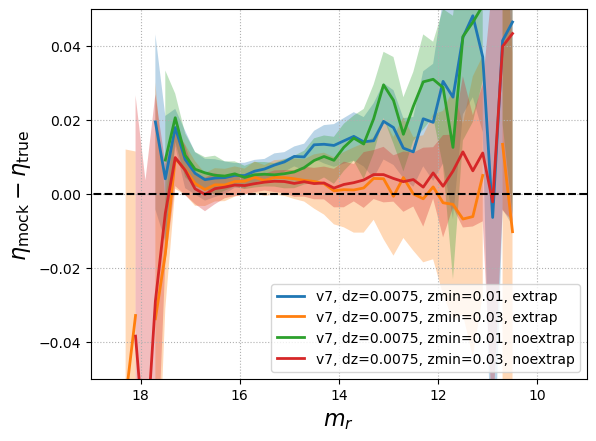

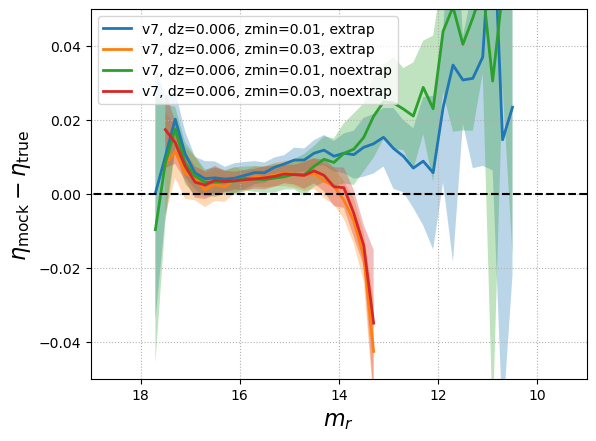

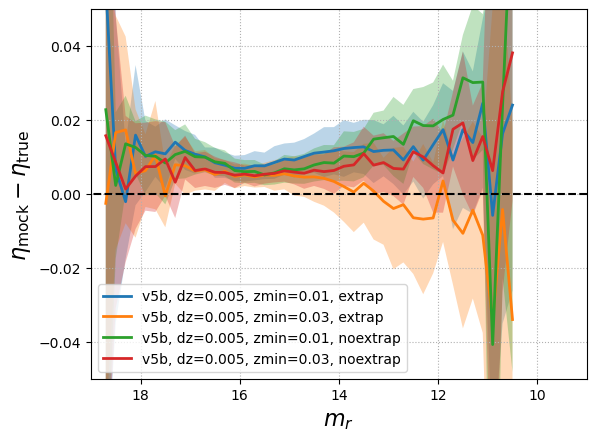

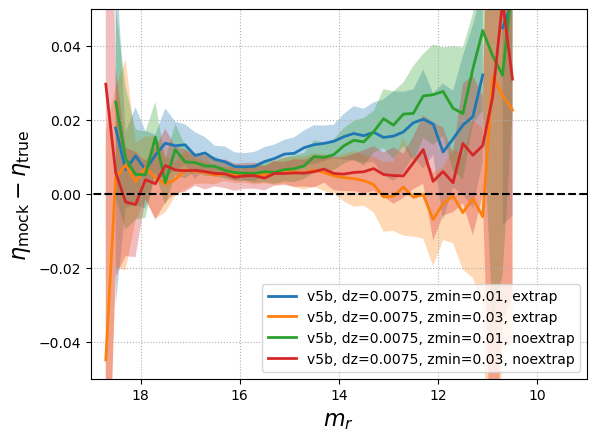

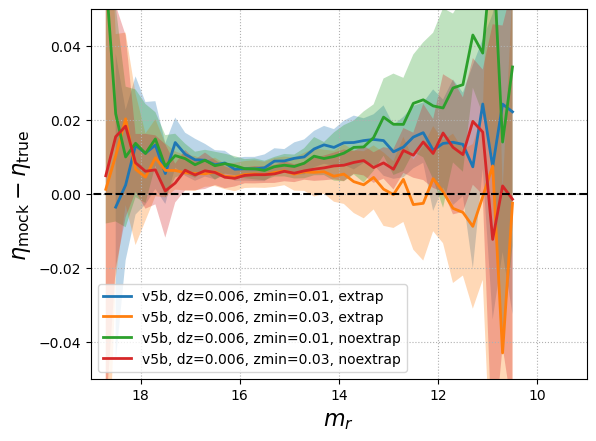

In [73]:
mr_bins = np.arange(9, 19, 0.2)
dmr = 0.5*np.diff(mr_bins)
mrc = 0.5*(mr_bins[1:] + mr_bins[:-1])

for i in {'v5', 'v5b', 'v7'}:
    for width in {50, 60, 75}:
        plt.figure()
        plt.grid(ls=':')

        for j in {'extrap', 'noextrap'}:
            for k in {1,3}:
                dz=width/10000
                zmin = (k/100)
                mc, eta_mean, eta_std = mean_delta_eta_appm(f'mock_dz{width}_{i}_zmin{k}_{j}', mr_bins, n_mocks=10)
                
                plt.plot(mc, eta_mean, lw=2, label=f'{i}, dz={dz}, zmin={zmin}, {j}')
                plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
                
        plt.grid(ls=':')
        plt.hlines(0, 9, 19, linestyles='dashed', colors='k', zorder=5)
        plt.legend()
        plt.xlabel(r'$m_r$', fontsize=16)
        plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)
        plt.xlim(19,9 )
        plt.ylim(-0.05,0.05)
            

## Look at how the different ellipse fits change the parameters

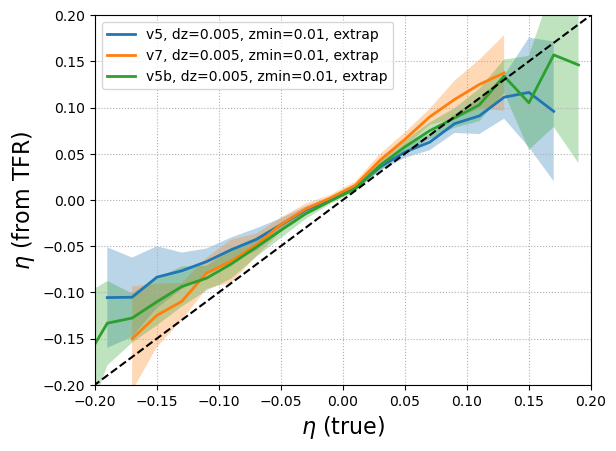

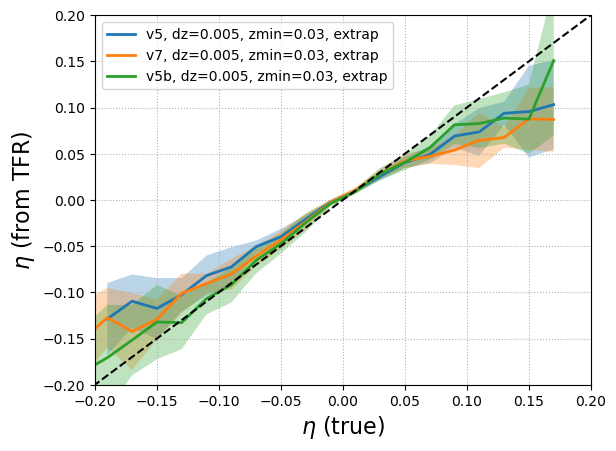

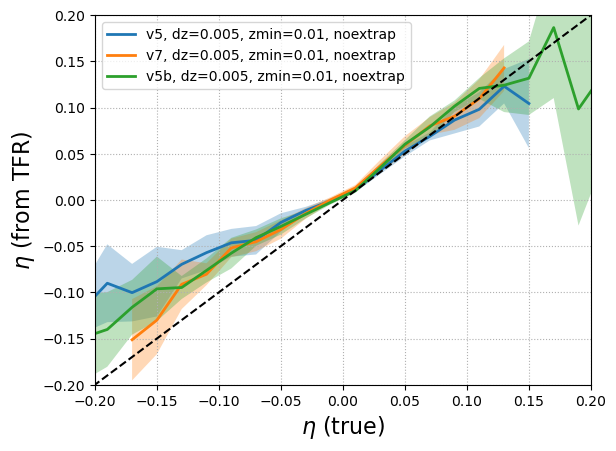

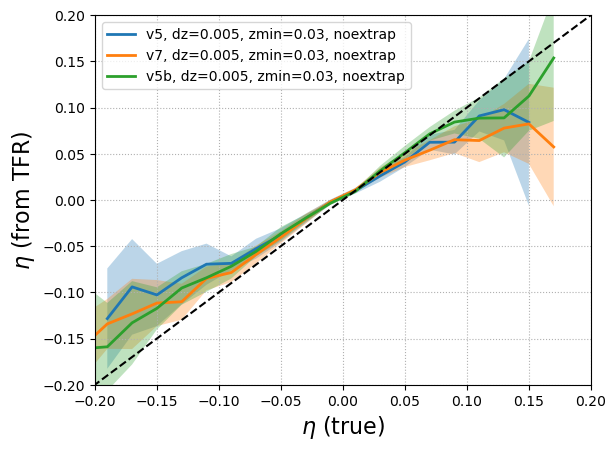

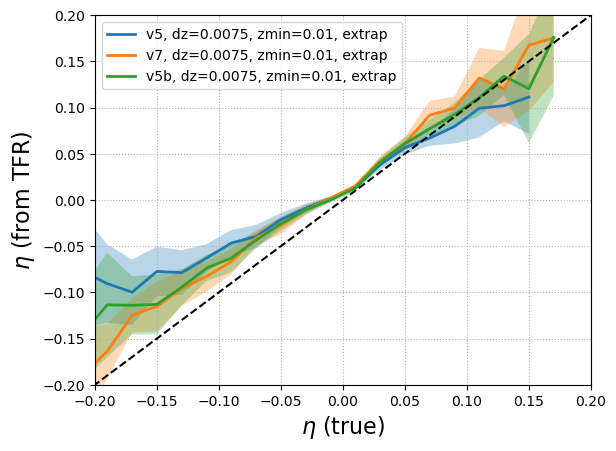

...

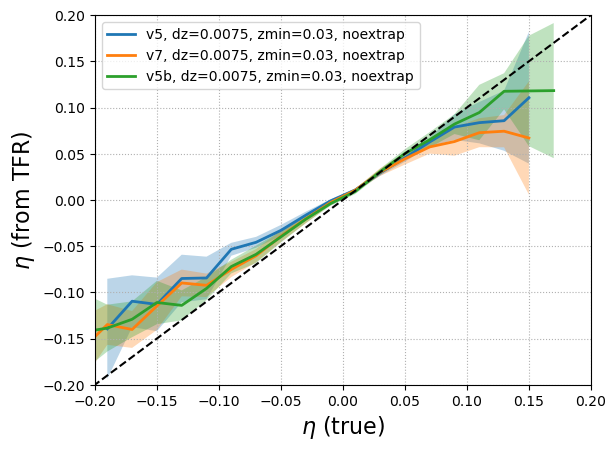

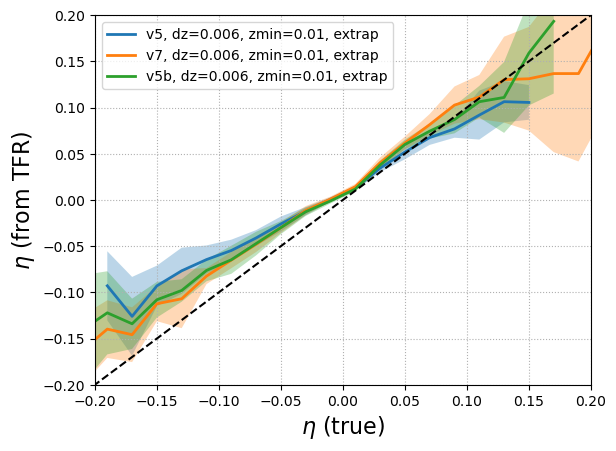

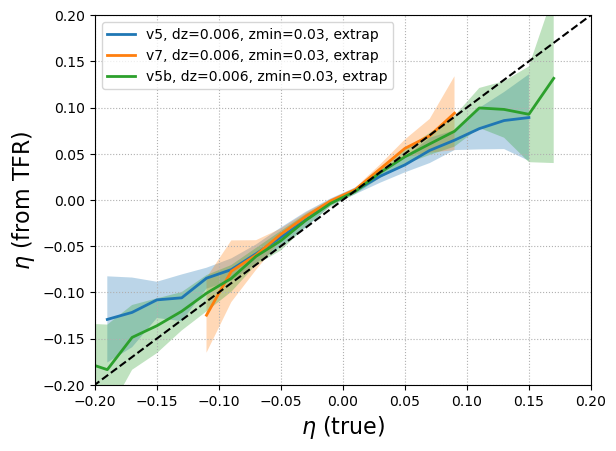

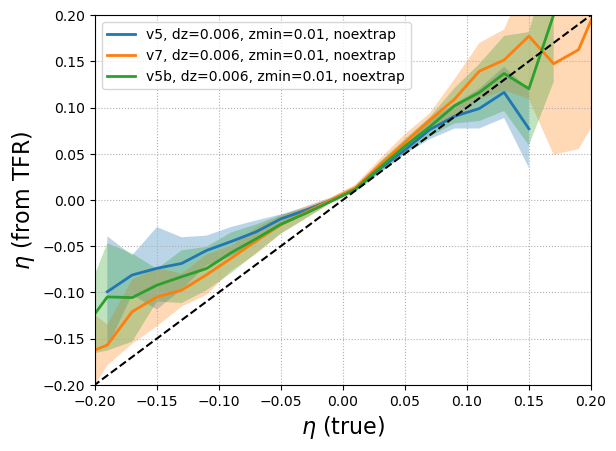

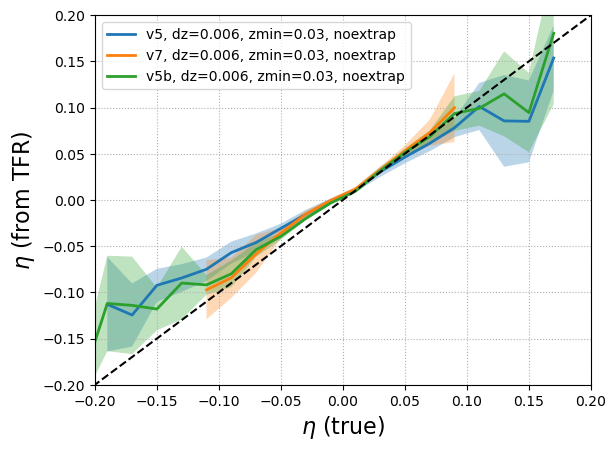

In [6]:
eta_bins = np.arange(-0.5, 0.3, 0.02)
d_eta = 0.5*np.diff(eta_bins)
eta_c = 0.5*(eta_bins[1:] + eta_bins[:-1])


for width in {50, 60, 75}:
    for j in {'extrap', 'noextrap'}:
        for k in {1,3}:
            plt.figure()
            plt.grid(ls=':')
    
            for i in {'v5', 'v5b', 'v7'}:
                    dz=width/10000
                    zmin = (k/100)
                    eta_c, eta_mean, eta_std = mean_eta_eta(f'mock_dz{width}_{i}_zmin{k}_{j}', eta_bins, n_mocks=10)
                    
                    plt.plot(eta_c, eta_mean, lw=2, label=f'{i}, dz={dz}, zmin={zmin}, {j}')
                    plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
                    
            plt.grid(ls=':')
            plt.plot([-5, 2], [-5, 2], '--', c='k')
            plt.xlim([-0.2, 0.2])
            plt.ylim([-0.2, 0.2])
            plt.legend()
            # plt.title('Population Fit', fontsize=16)
            plt.xlabel(r'$\eta$ (true)', fontsize=16)
            plt.ylabel(r'$\eta$ (from TFR)', fontsize=16);
            

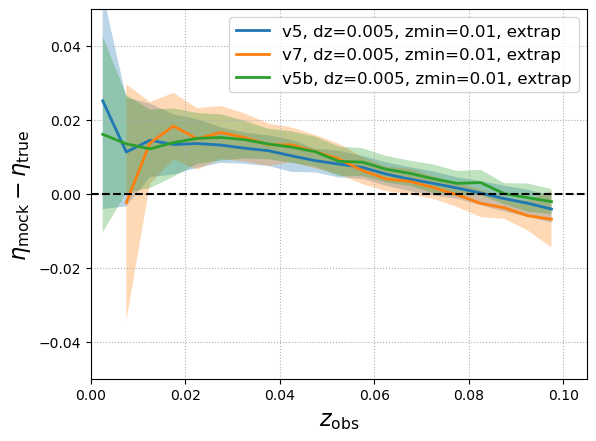

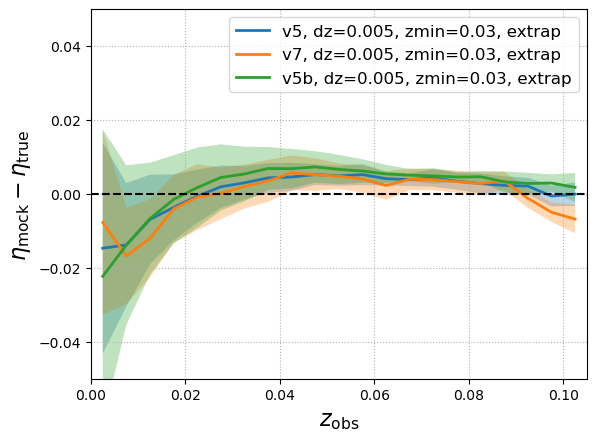

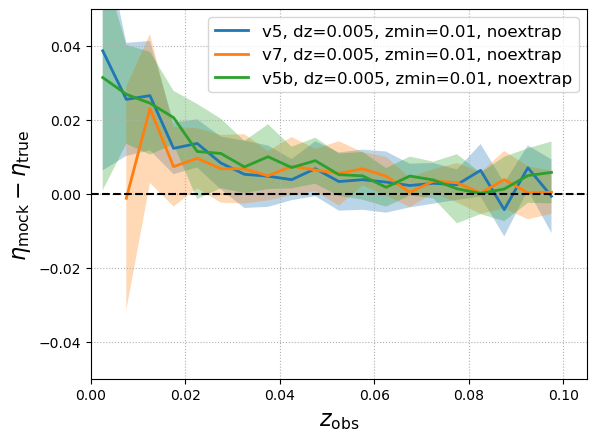

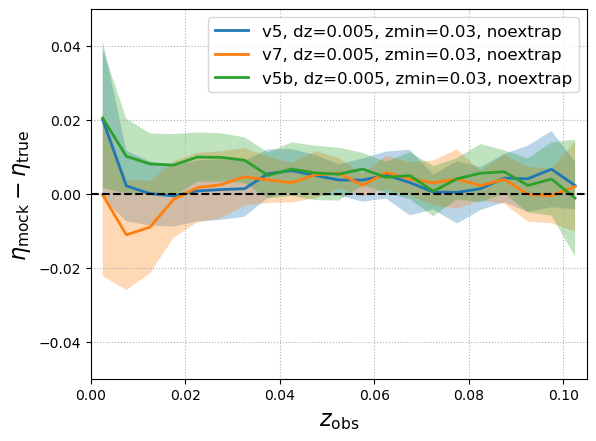

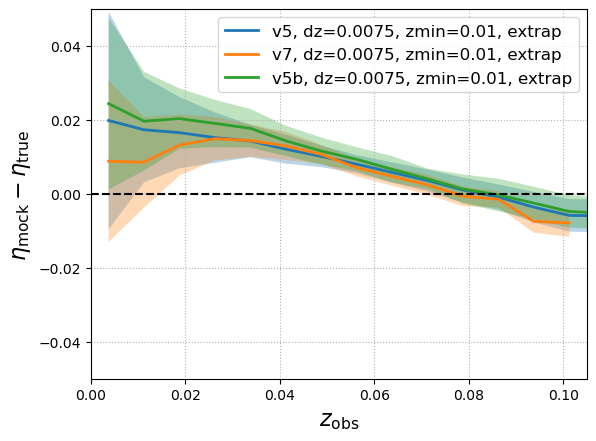

...

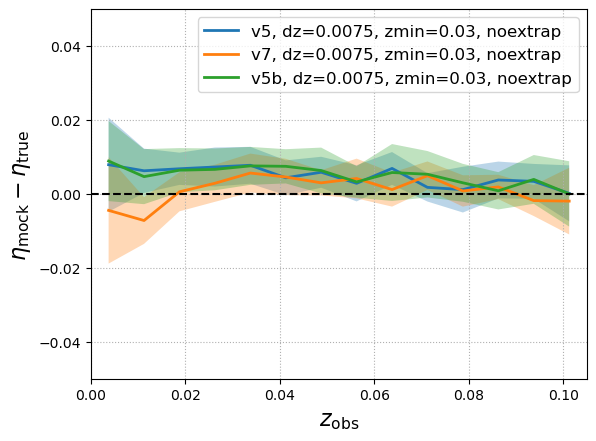

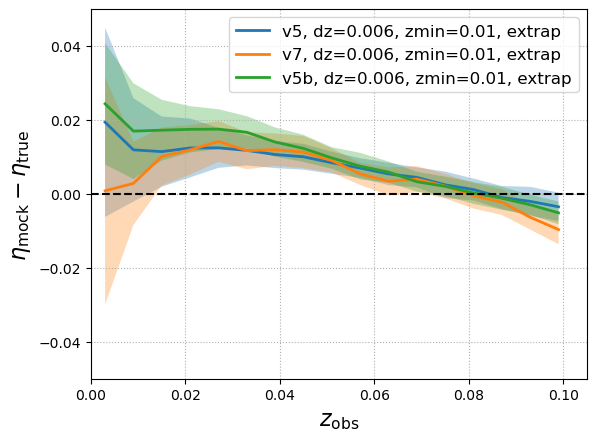

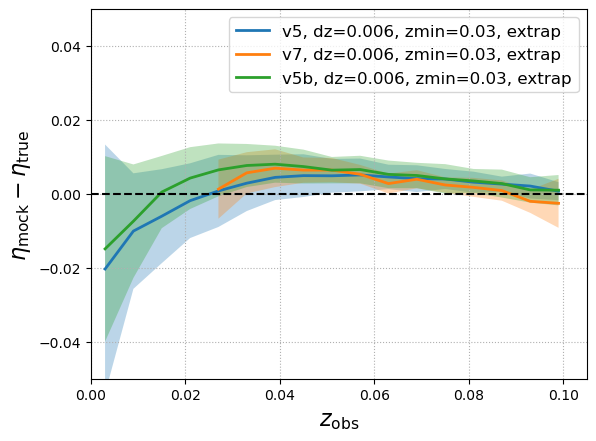

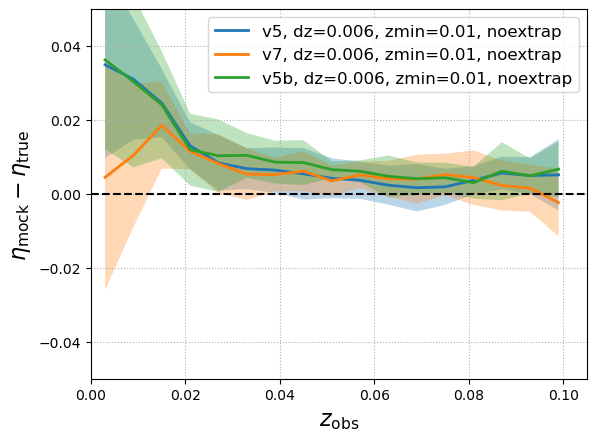

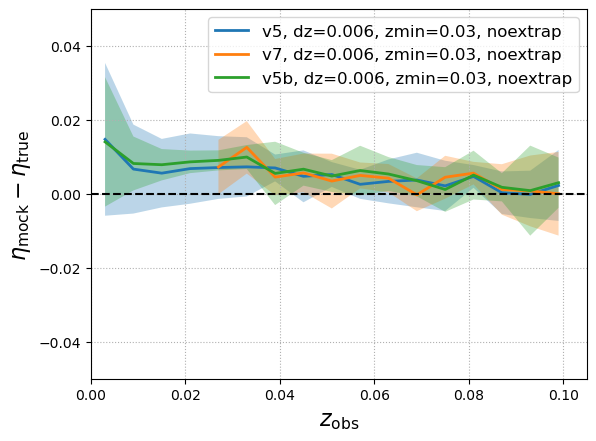

In [9]:
# fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])
cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
# plt.grid(ls=':')

for width in {50, 60, 75}:
    for j in {'extrap', 'noextrap'}:
        for k in {1,3}:
            plt.figure()
            plt.grid(ls=':')
    
            for i in {'v5', 'v5b', 'v7'}:
                dz=width/10000
                zmin = (k/100)
                zmax = zmin +  math.ceil(1+((0.1-zmin)/dz))*dz

                _zbins = np.arange(0, zmax, dz)
                # dz = 0.5*np.diff(_zbins)
                zc = 0.5*(_zbins[1:] + _zbins[:-1])
                _, eta_mean, eta_std = mean_delta_eta_z(f'mock_dz{width}_{i}_zmin{k}_{j}', n_mocks=10, zbins=_zbins)
                
                plt.plot(zc, eta_mean, lw=2, label=f'{i}, dz={dz}, zmin={zmin}, {j}')
                plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
            

            # Line at eta = 0
            plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
            # -------------------------------------------------------------------------------
            
            plt.legend(fontsize=12)
            # plt.title('Population density fits')
            plt.xlabel(r'$z_\mathrm{obs}$', fontsize=16)
            plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)
            
            plt.xlim(0,0.105)
            plt.ylim(-0.05, 0.05);
        # plt.show()

# fig.savefig('tfr_mock_eta.png', dpi=150);

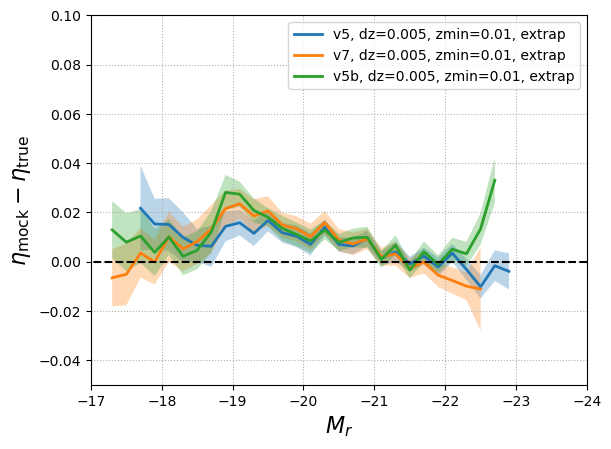

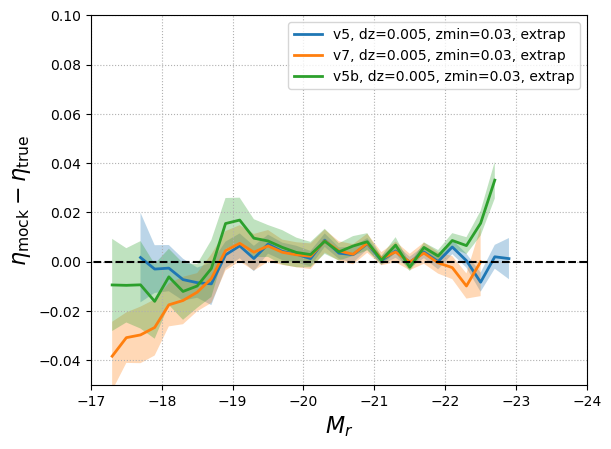

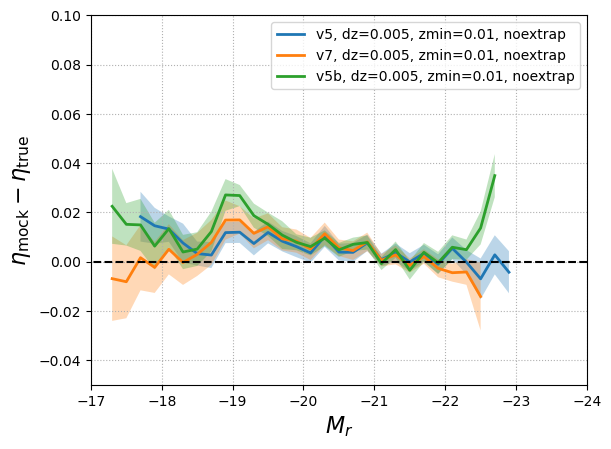

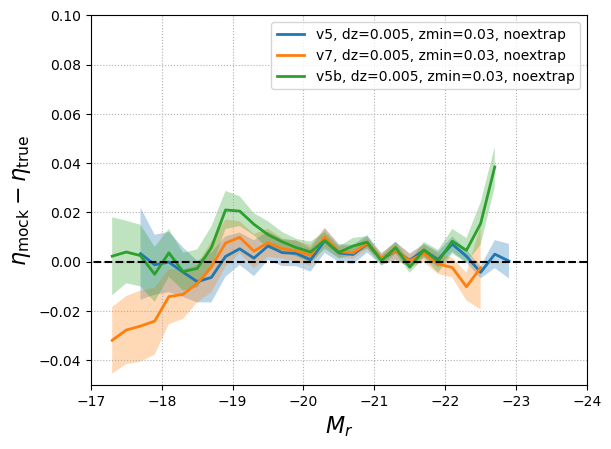

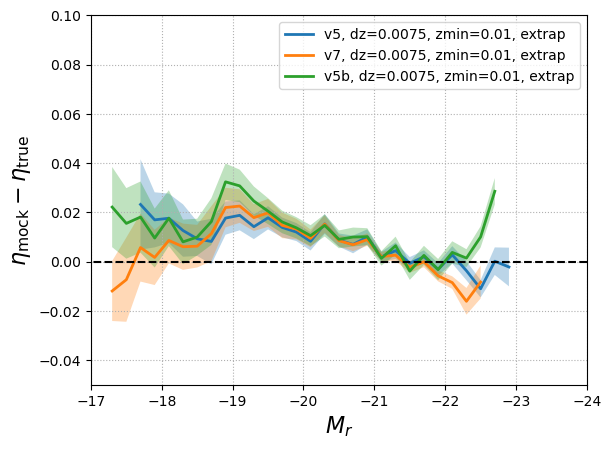

...

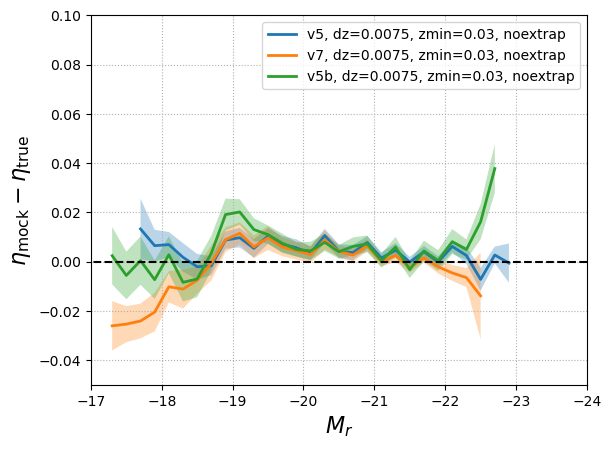

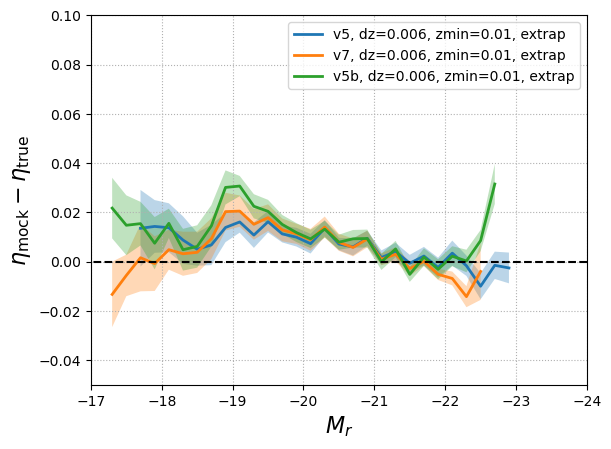

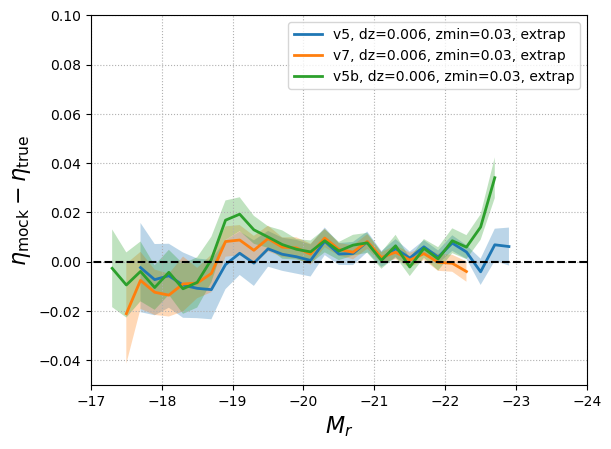

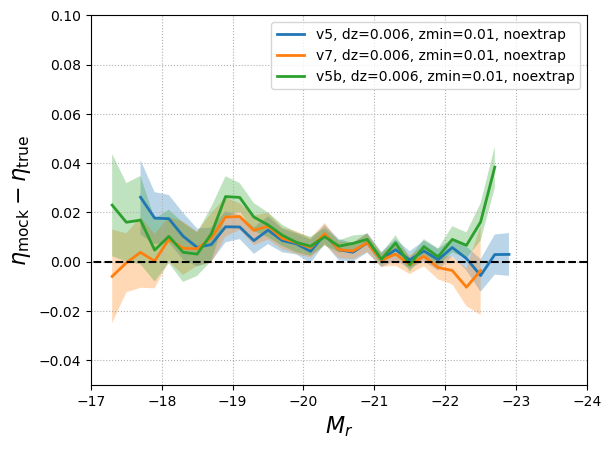

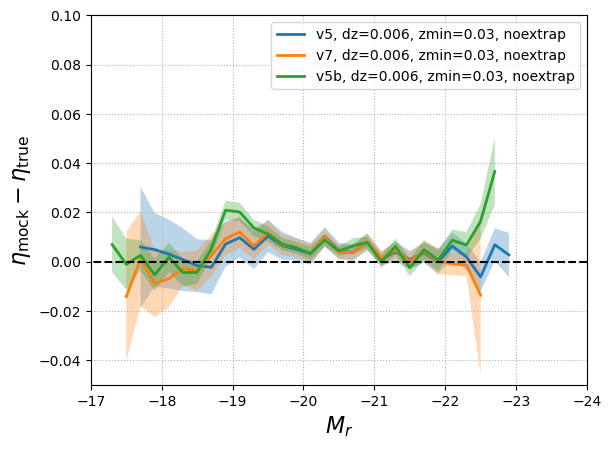

In [10]:
Mr_bins = np.arange(-24, -17, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])

for width in {50, 60, 75}:
    for j in {'extrap', 'noextrap'}:
        for k in {1,3}:
            plt.figure()
            plt.grid(ls=':')
    
            for i in {'v5', 'v5b', 'v7'}:
                dz=width/10000
                zmin = (k/100)
                mc, eta_mean, eta_std = mean_delta_eta_m(f'mock_dz{width}_{i}_zmin{k}_{j}', Mr_bins, n_mocks=10)
                
                plt.plot(mc, eta_mean, lw=2, label=f'{i}, dz={dz}, zmin={zmin}, {j}')
                plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
                
            plt.grid(ls=':')
            plt.hlines(0, -24, -17, linestyles='dashed', colors='k', zorder=5)
            plt.legend()
            plt.xlabel(r'$M_r$', fontsize=16)
            plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)
            plt.xlim(-17,-24)
            plt.ylim(-0.05,0.1)
            

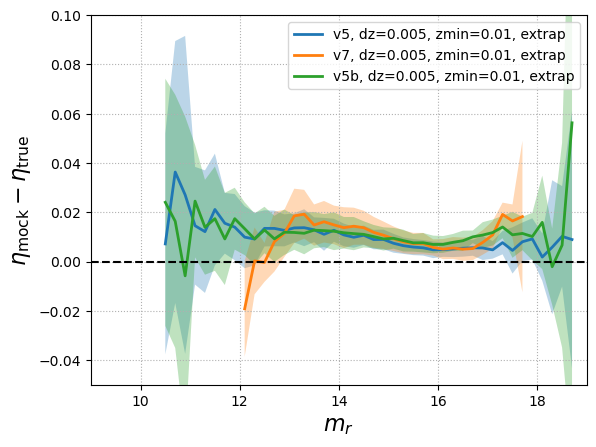

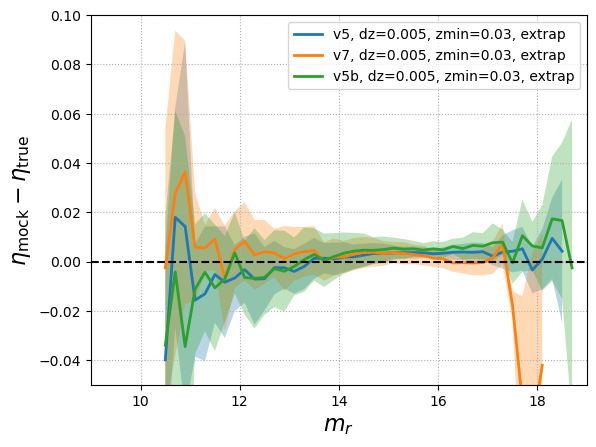

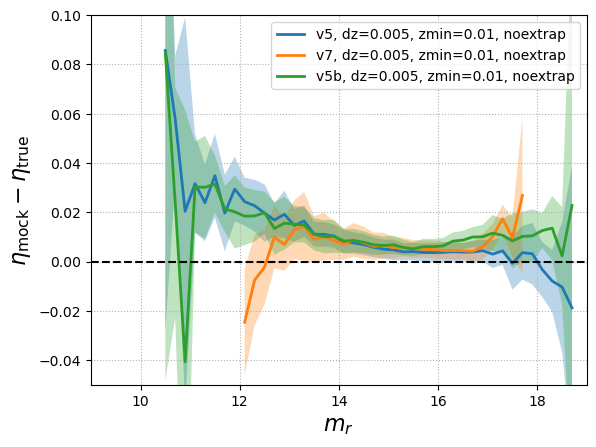

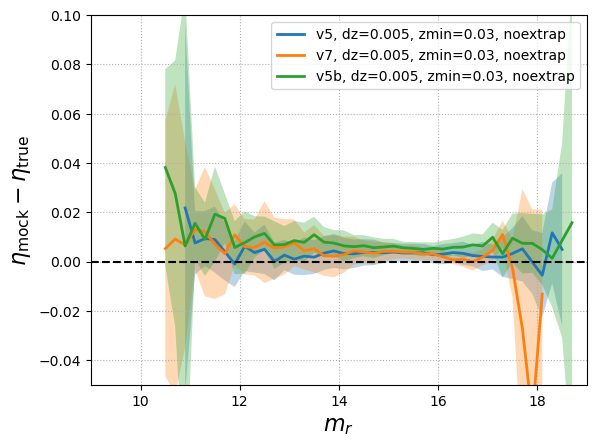

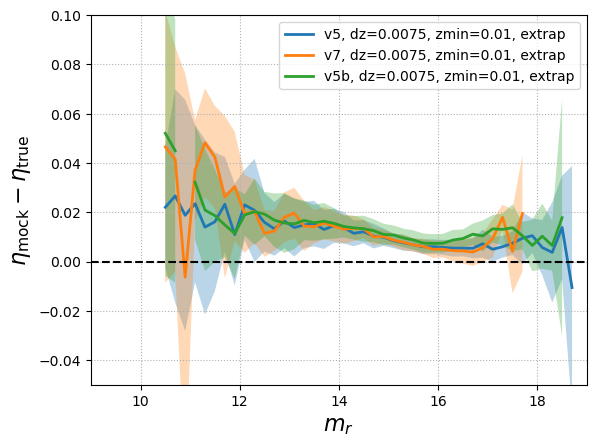

...

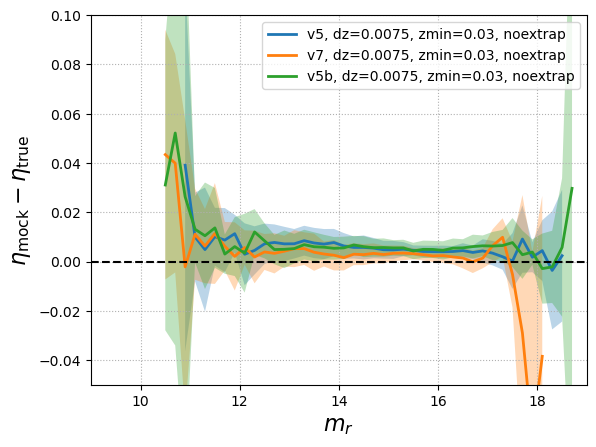

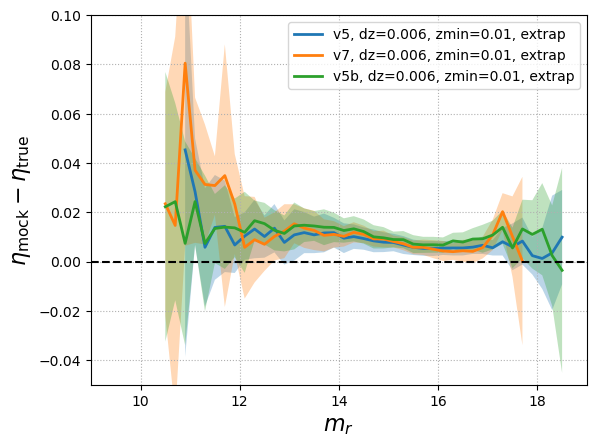

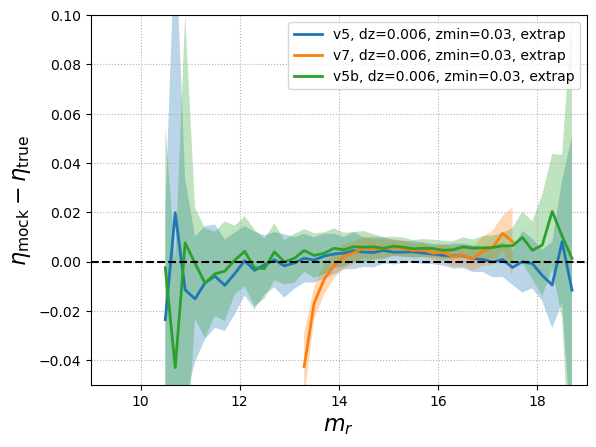

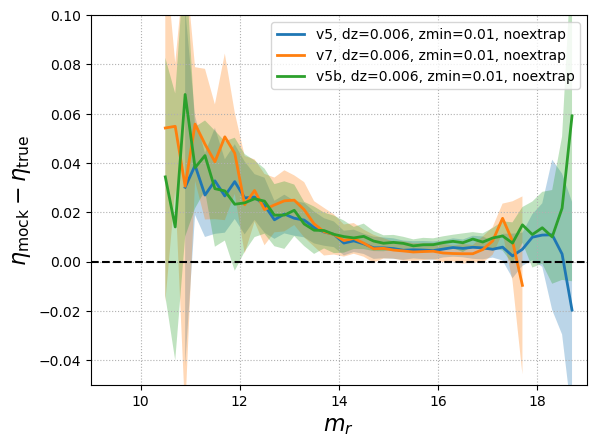

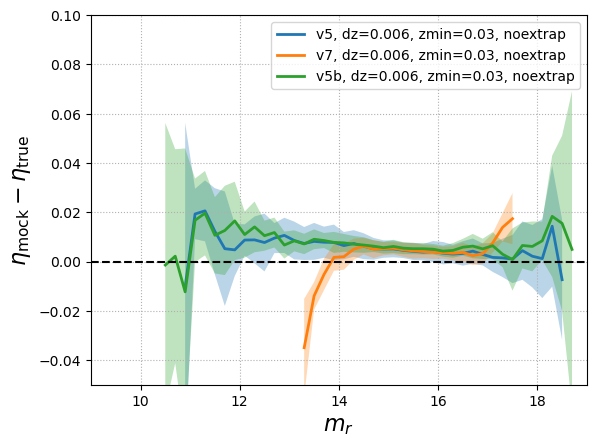

In [74]:
Mr_bins = np.arange(9, 19, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])

for width in {50, 60, 75}:
    for j in {'extrap', 'noextrap'}:
        for k in {1,3}:
            plt.figure(dpi=150, facecolor='none')
            plt.grid(ls=':')
    
            for i in {'v5', 'v5b', 'v7'}:
                dz=width/10000
                zmin = (k/100)
                mc, eta_mean, eta_std = mean_delta_eta_appm(f'mock_dz{width}_{i}_zmin{k}_{j}', Mr_bins, n_mocks=10)
                
                plt.plot(mc, eta_mean, lw=2, label=f'{i}, dz={dz}, zmin={zmin}, {j}')
                plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
                
            plt.grid(ls=':')
            plt.hlines(0, 9,19, linestyles='dashed', colors='k', zorder=5)
            plt.legend()
            plt.xlabel(r'$m_r$', fontsize=16)
            plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)
            plt.xlim(9,19)
            plt.ylim(-0.05,0.1)
            

## Look at how the binwidth changes across the fits
It seems that changing the width of the redshift bins does not have much of an impact on the eta trends

### Try one single case

(-0.05, 0.1)

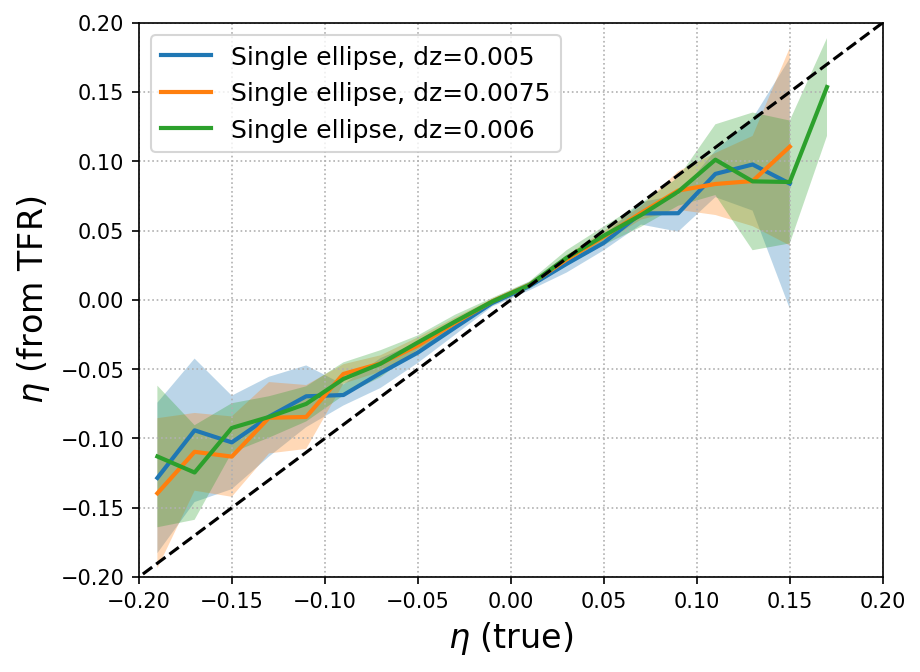

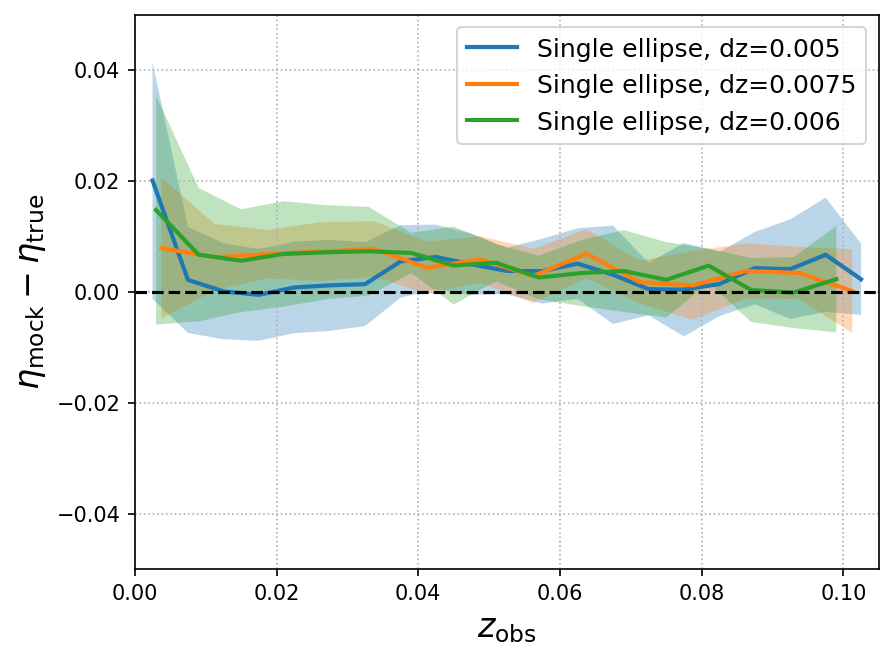

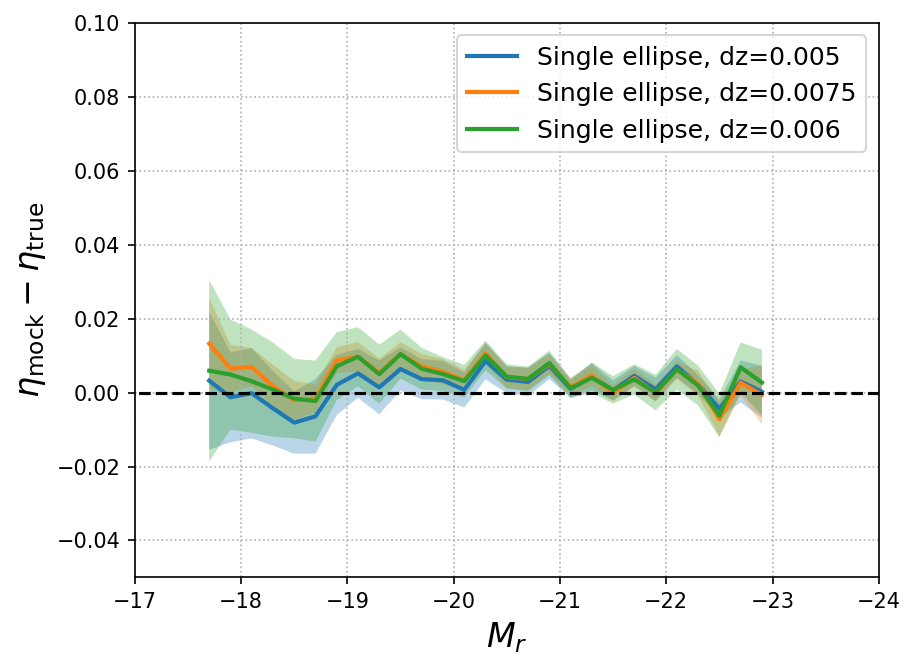

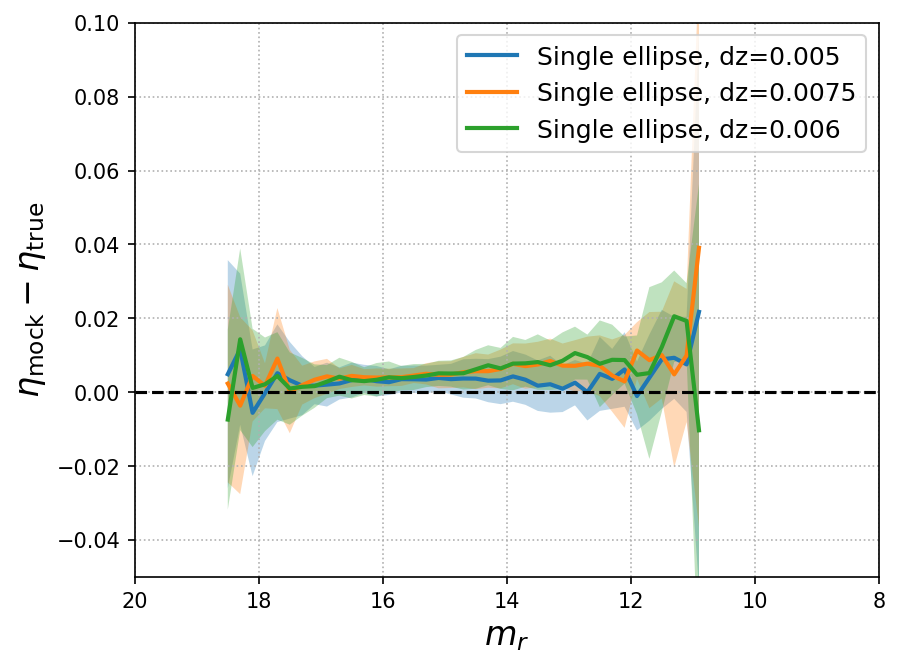

In [79]:
i='v5'
k=3
j='noextrap'

eta_bins = np.arange(-0.5, 0.3, 0.02)
d_eta = 0.5*np.diff(eta_bins)
eta_c = 0.5*(eta_bins[1:] + eta_bins[:-1])


plt.figure(dpi=150, facecolor='none')
plt.grid(ls=':')

for width in {50, 60, 75}:
    dz=width/10000
    zmin = (k/100)
    eta_c, eta_mean, eta_std = mean_eta_eta(f'mock_dz{width}_{i}_zmin{k}_{j}', eta_bins, n_mocks=10)
    
    plt.plot(eta_c, eta_mean, lw=2, label=f'Single ellipse, dz={dz}')
    plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
        
plt.grid(ls=':')
plt.plot([-5, 2], [-5, 2], '--', c='k')
plt.xlim([-0.2, 0.2])
plt.ylim([-0.2, 0.2])
plt.legend(fontsize=12)
# plt.title('Population Fit', fontsize=16)
plt.xlabel(r'$\eta$ (true)', fontsize=16)
plt.ylabel(r'$\eta$ (from TFR)', fontsize=16);
# fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])
cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
# plt.grid(ls=':')

plt.figure(dpi=150, facecolor='none')
plt.grid(ls=':')
    
for width in {50, 60, 75}:
    dz=width/10000
    zmin = (k/100)
    zmax = zmin +  math.ceil(1+((0.1-zmin)/dz))*dz

    _zbins = np.arange(0, zmax, dz)
    # dz = 0.5*np.diff(_zbins)
    zc = 0.5*(_zbins[1:] + _zbins[:-1])
    _, eta_mean, eta_std = mean_delta_eta_z(f'mock_dz{width}_{i}_zmin{k}_{j}', n_mocks=10, zbins=_zbins)
    
    plt.plot(zc, eta_mean, lw=2, label=f'Single ellipse, dz={dz}')
    plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
            

# Line at eta = 0
plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
# -------------------------------------------------------------------------------
            
plt.legend(fontsize=12)
# plt.title('Population density fits')
plt.xlabel(r'$z_\mathrm{obs}$', fontsize=16)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)

plt.xlim(0,0.105)
plt.ylim(-0.05, 0.05);

        # plt.show()

# fig.savefig('tfr_mock_eta.png', dpi=150);

Mr_bins = np.arange(-24, -17, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])

plt.figure(dpi=150, facecolor='none')
plt.grid(ls=':')

for width in {50, 60, 75}:
    dz=width/10000
    zmin = (k/100)
    mc, eta_mean, eta_std = mean_delta_eta_m(f'mock_dz{width}_{i}_zmin{k}_{j}', Mr_bins, n_mocks=10)
    
    plt.plot(mc, eta_mean, lw=2, label=f'Single ellipse, dz={dz}')
    plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
    
plt.grid(ls=':')
plt.hlines(0, -24, -17, linestyles='dashed', colors='k', zorder=5)
plt.legend(fontsize=12)
plt.xlabel(r'$M_r$', fontsize=16)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)
plt.xlim(-17,-24)
plt.ylim(-0.05,0.1)

Mr_bins = np.arange(9, 19, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])

plt.figure(dpi=150, facecolor='none')
plt.grid(ls=':')

for width in {50, 60, 75}:
    dz=width/10000
    zmin = (k/100)
    mc, eta_mean, eta_std = mean_delta_eta_appm(f'mock_dz{width}_{i}_zmin{k}_{j}', Mr_bins, n_mocks=10)
    
    plt.plot(mc, eta_mean, lw=2, label=f'Single ellipse, dz={dz}')
    plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
    
plt.grid(ls=':')
plt.hlines(0, 20, 8, linestyles='dashed', colors='k', zorder=5)
plt.legend(fontsize=12)
plt.xlabel(r'$m_r$', fontsize=16)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)
plt.xlim(20,8)
plt.ylim(-0.05,0.1)

            

### Generate for all the variations

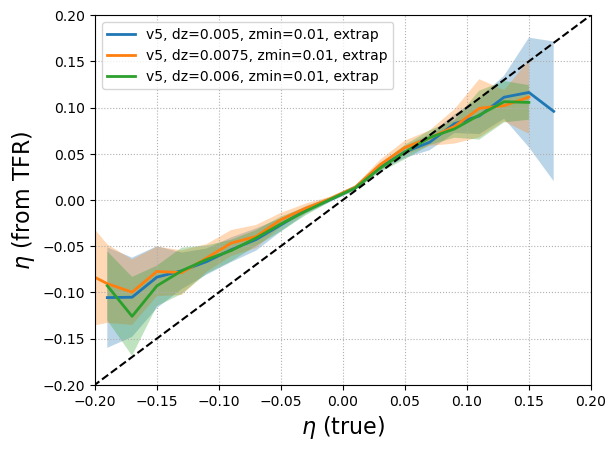

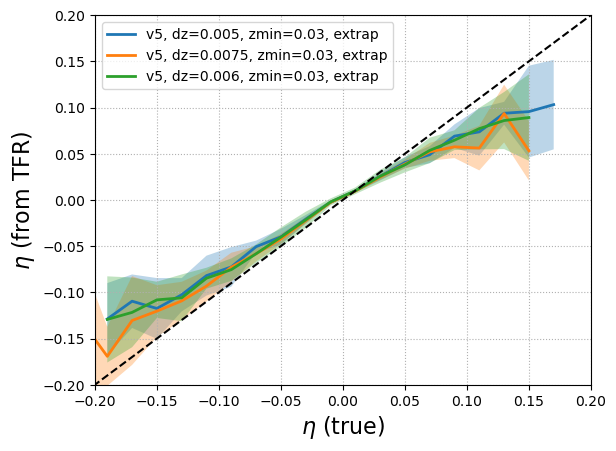

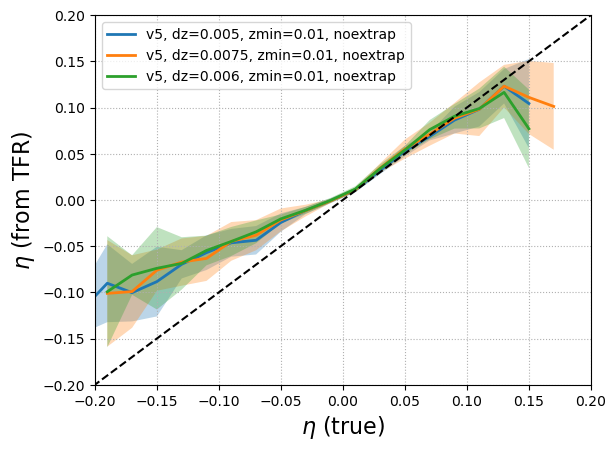

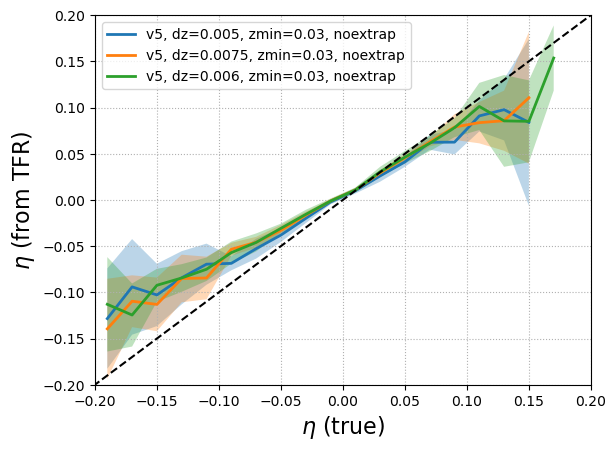

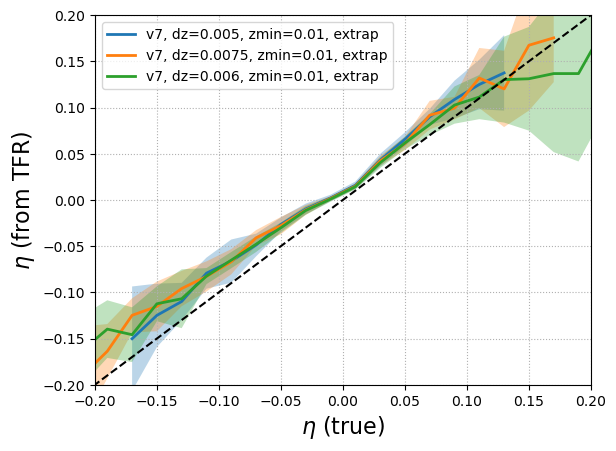

...

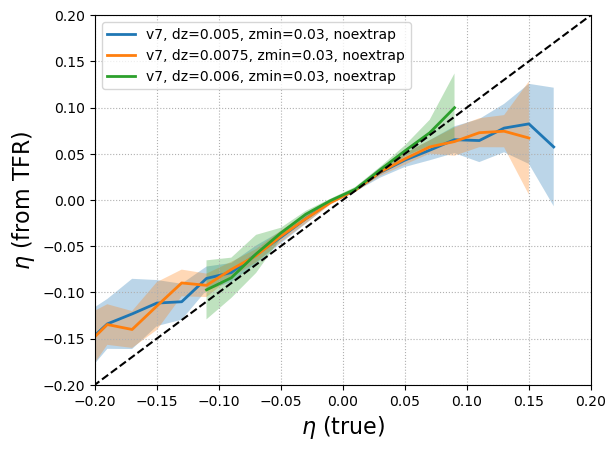

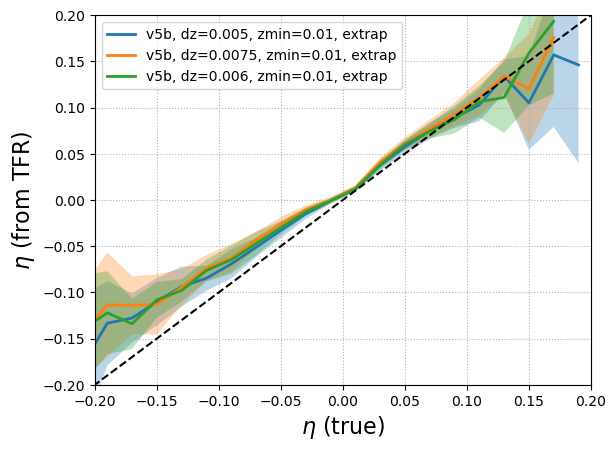

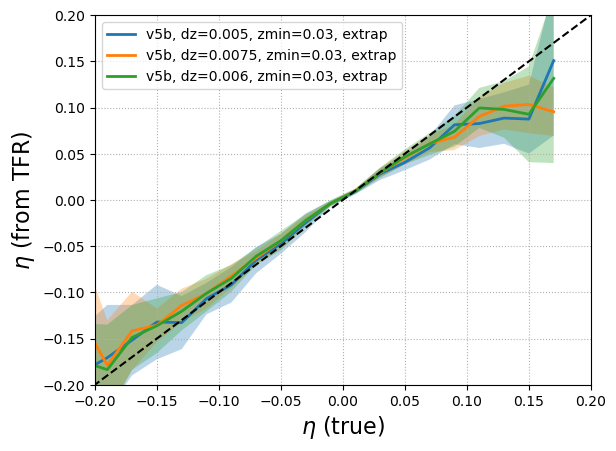

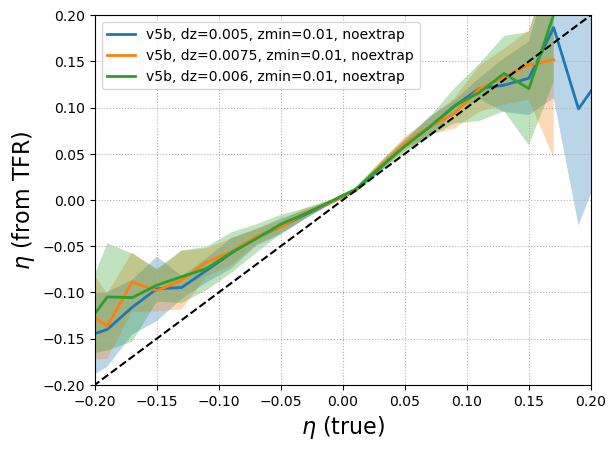

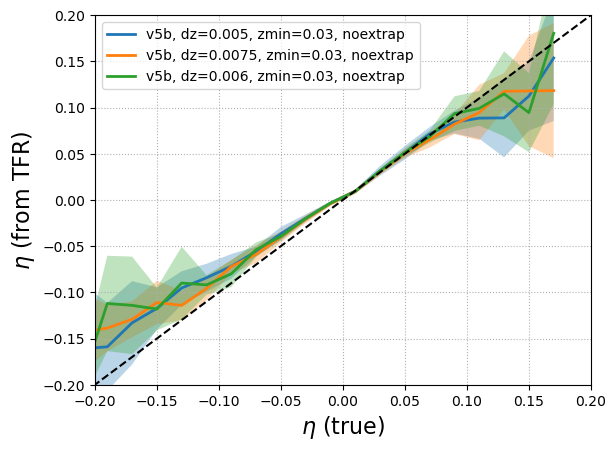

In [13]:
eta_bins = np.arange(-0.5, 0.3, 0.02)
d_eta = 0.5*np.diff(eta_bins)
eta_c = 0.5*(eta_bins[1:] + eta_bins[:-1])


for i in {'v5', 'v5b', 'v7'}:
    for j in {'extrap', 'noextrap'}:
        for k in {1,3}:
            plt.figure(dpi=150, facecolor='none')
            plt.grid(ls=':')
    
            for width in {50, 60, 75}:
                    dz=width/10000
                    zmin = (k/100)
                    eta_c, eta_mean, eta_std = mean_eta_eta(f'mock_dz{width}_{i}_zmin{k}_{j}', eta_bins, n_mocks=10)
                    
                    plt.plot(eta_c, eta_mean, lw=2, label=f'{i}, dz={dz}, zmin={zmin}, {j}')
                    plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
                    
            plt.grid(ls=':')
            plt.plot([-5, 2], [-5, 2], '--', c='k')
            plt.xlim([-0.2, 0.2])
            plt.ylim([-0.2, 0.2])
            plt.legend()
            # plt.title('Population Fit', fontsize=16)
            plt.xlabel(r'$\eta$ (true)', fontsize=16)
            plt.ylabel(r'$\eta$ (from TFR)', fontsize=16);
            

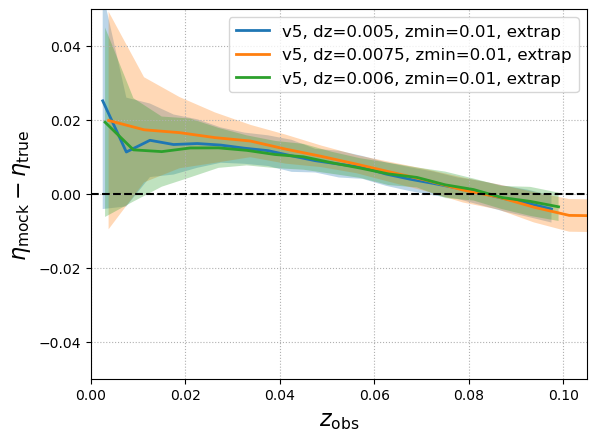

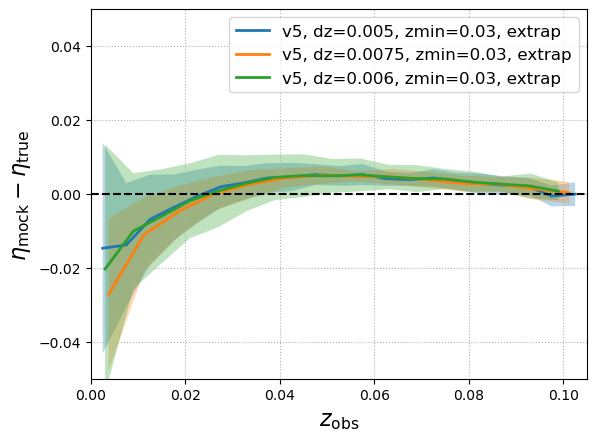

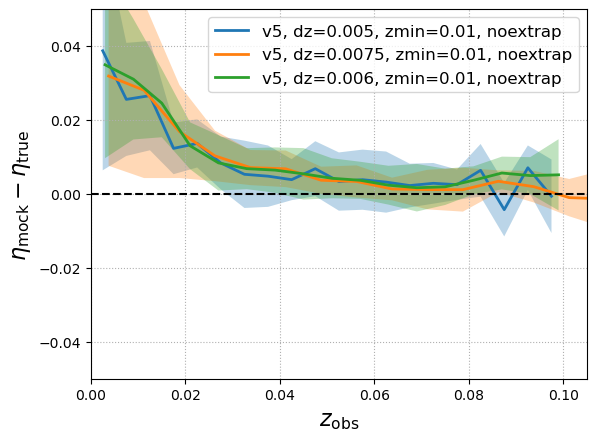

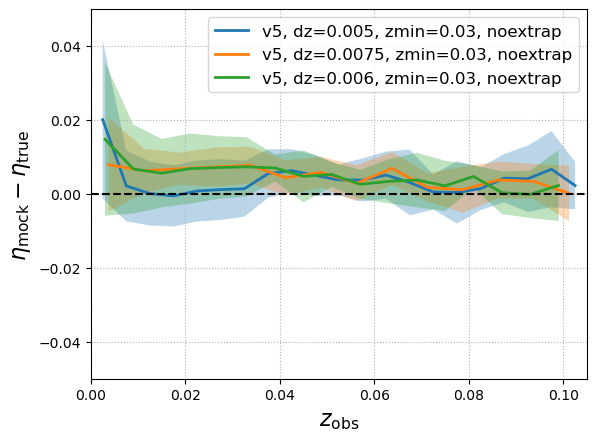

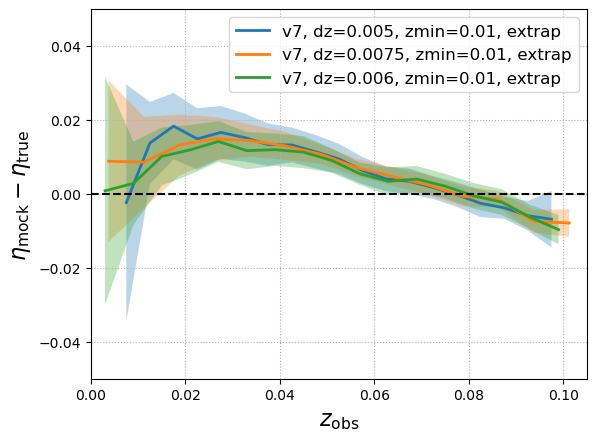

...

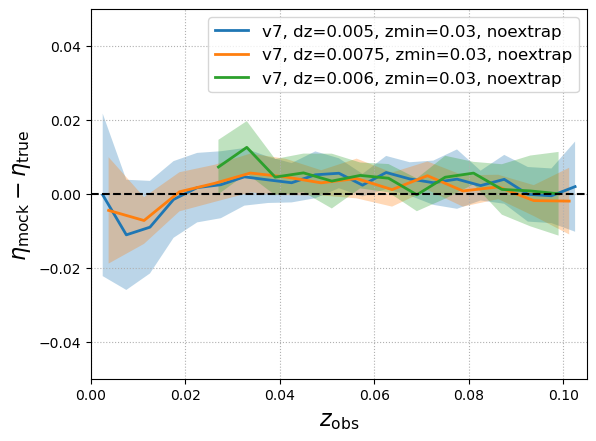

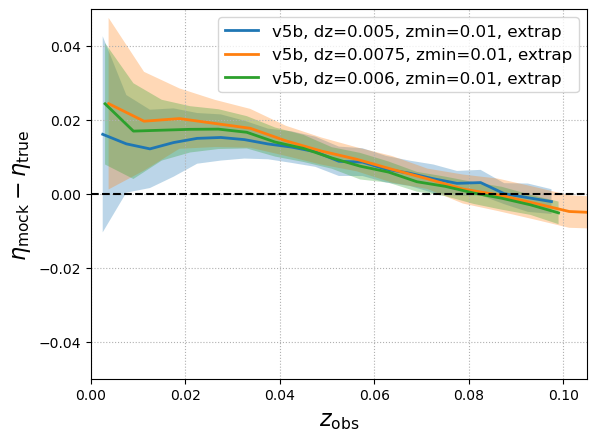

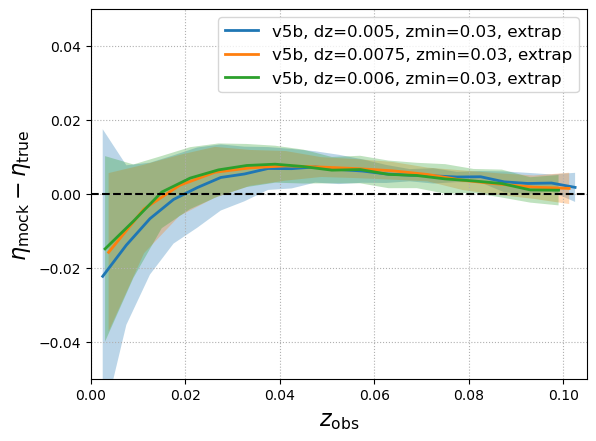

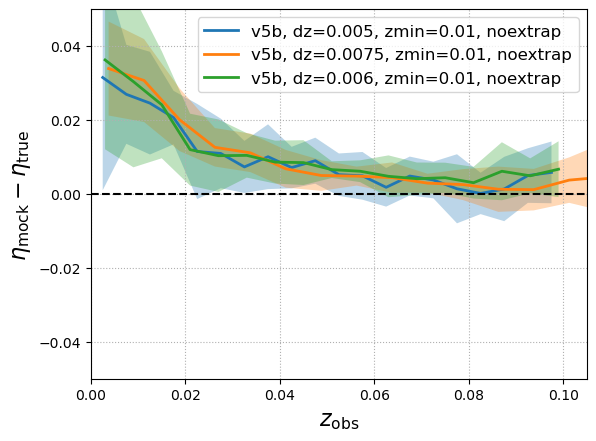

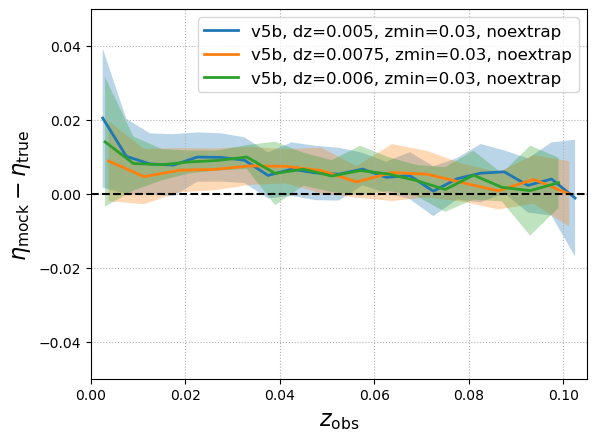

In [11]:
# fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])
cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
# plt.grid(ls=':')

for i in {'v5', 'v5b', 'v7'}:
    for j in {'extrap', 'noextrap'}:
        for k in {1,3}:
            plt.figure()
            plt.grid(ls=':')
    
            for width in {50, 60, 75}:
                dz=width/10000
                zmin = (k/100)
                zmax = zmin +  math.ceil(1+((0.1-zmin)/dz))*dz

                _zbins = np.arange(0, zmax, dz)
                # dz = 0.5*np.diff(_zbins)
                zc = 0.5*(_zbins[1:] + _zbins[:-1])
                _, eta_mean, eta_std = mean_delta_eta_z(f'mock_dz{width}_{i}_zmin{k}_{j}', n_mocks=10, zbins=_zbins)
                
                plt.plot(zc, eta_mean, lw=2, label=f'{i}, dz={dz}, zmin={zmin}, {j}')
                plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
            

            # Line at eta = 0
            plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
            # -------------------------------------------------------------------------------
            
            plt.legend(fontsize=12)
            # plt.title('Population density fits')
            plt.xlabel(r'$z_\mathrm{obs}$', fontsize=16)
            plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)
            
            plt.xlim(0,0.105)
            plt.ylim(-0.05, 0.05);
        # plt.show()

# fig.savefig('tfr_mock_eta.png', dpi=150);

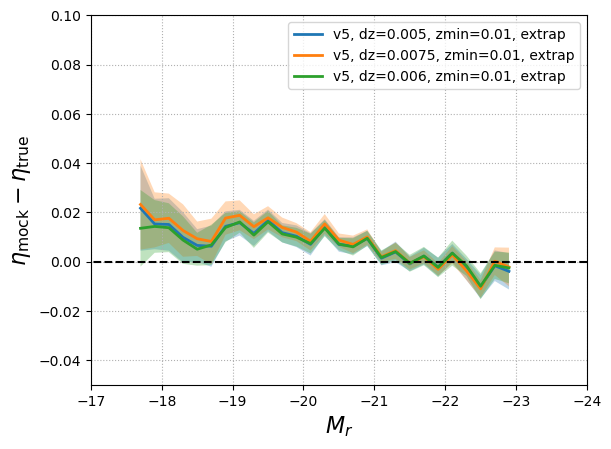

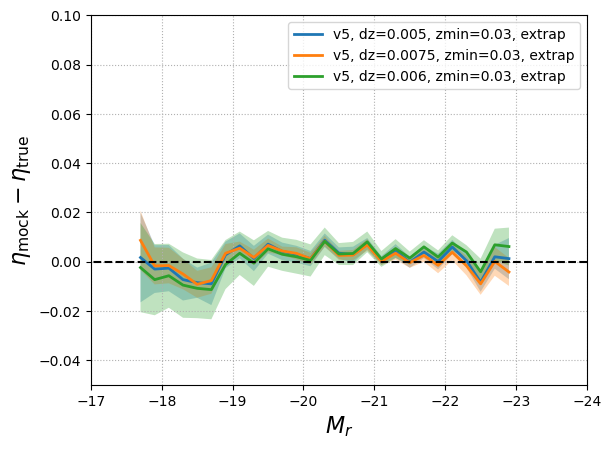

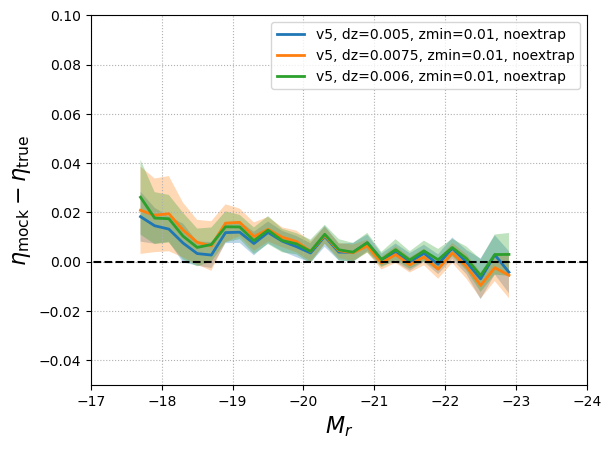

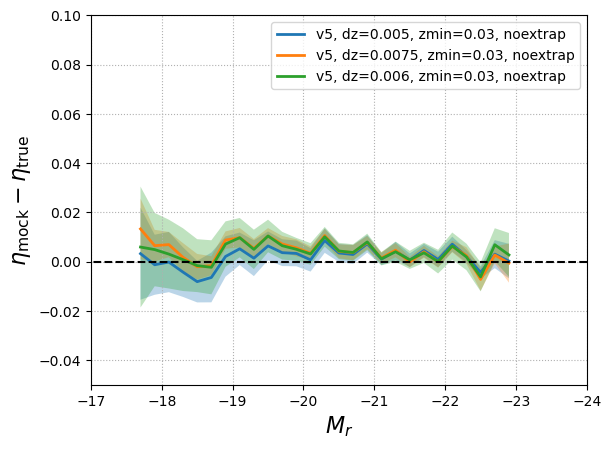

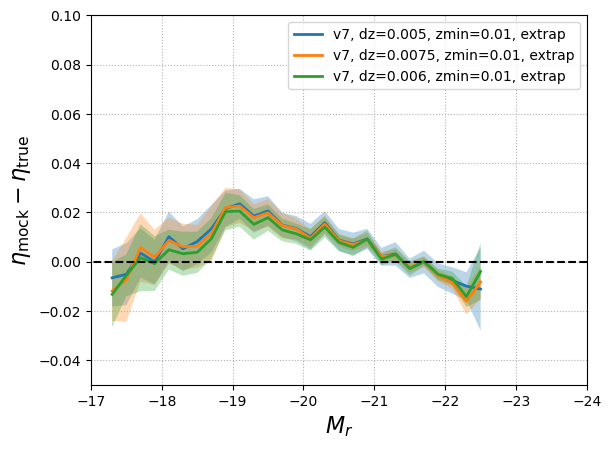

...

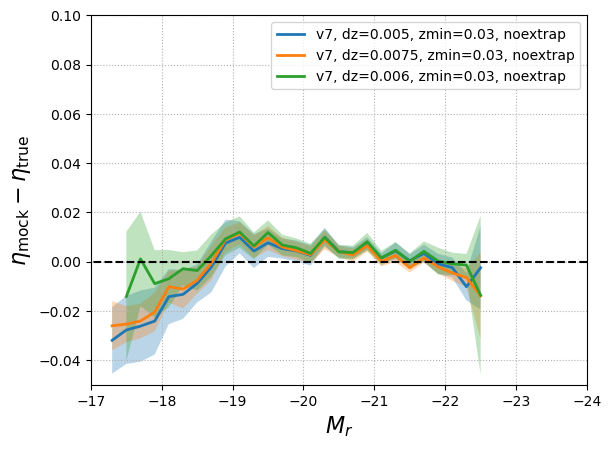

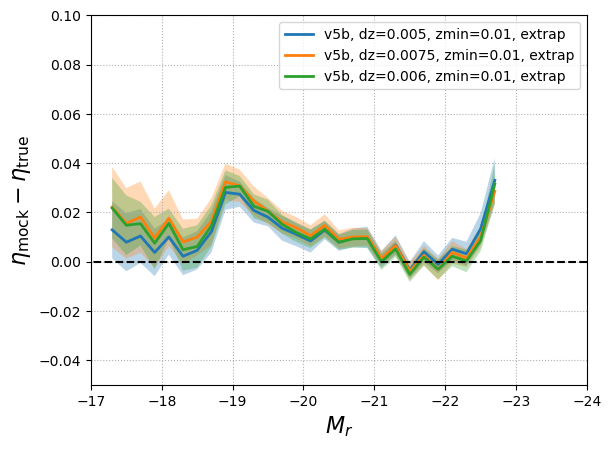

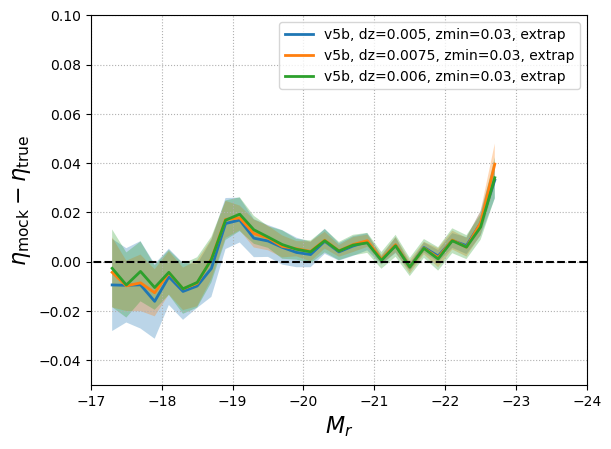

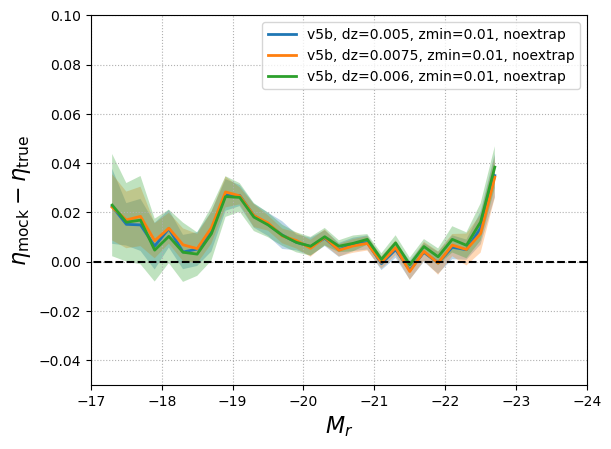

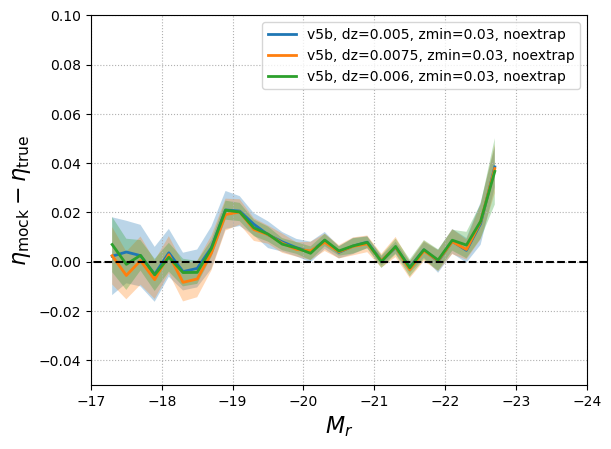

In [12]:
Mr_bins = np.arange(-24, -17, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])

for i in {'v5', 'v5b', 'v7'}:
    for j in {'extrap', 'noextrap'}:
        for k in {1,3}:
            plt.figure()
            plt.grid(ls=':')
    
            for width in {50, 60, 75}:
                dz=width/10000
                zmin = (k/100)
                mc, eta_mean, eta_std = mean_delta_eta_m(f'mock_dz{width}_{i}_zmin{k}_{j}', Mr_bins, n_mocks=10)
                
                plt.plot(mc, eta_mean, lw=2, label=f'{i}, dz={dz}, zmin={zmin}, {j}')
                plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
                
            plt.grid(ls=':')
            plt.hlines(0, -24, -17, linestyles='dashed', colors='k', zorder=5)
            plt.legend()
            plt.xlabel(r'$M_r$', fontsize=16)
            plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)
            plt.xlim(-17,-24)
            plt.ylim(-0.05,0.1)
            

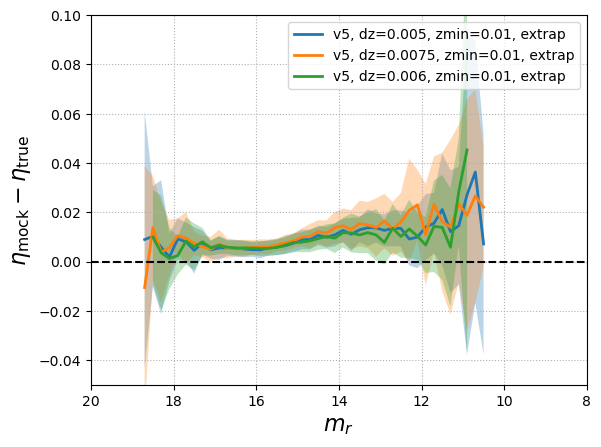

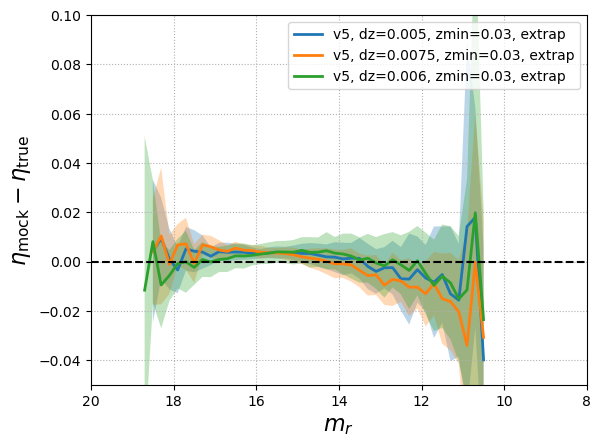

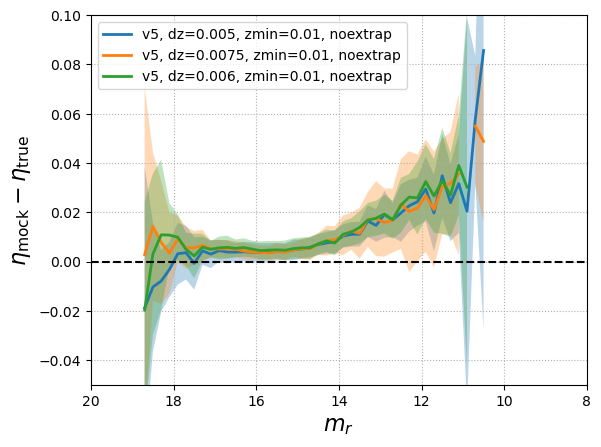

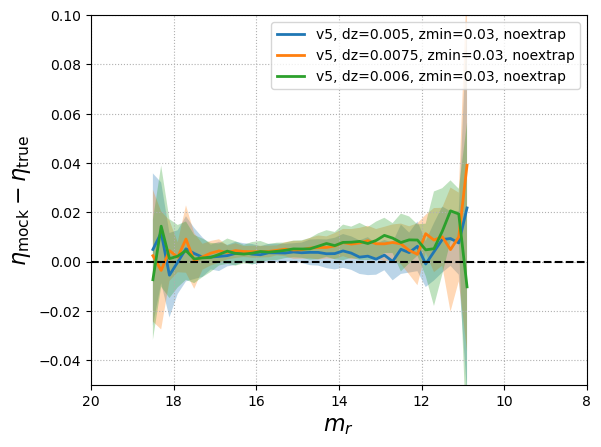

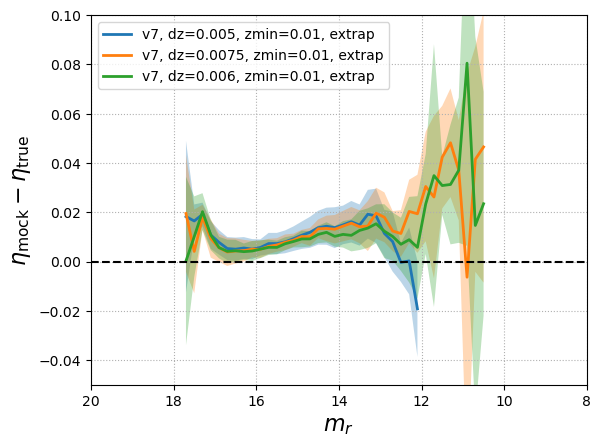

...

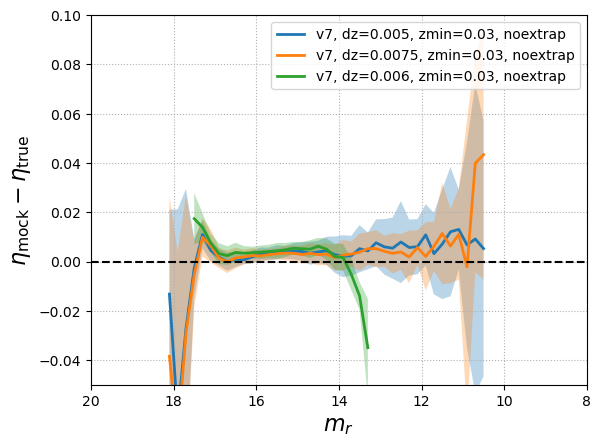

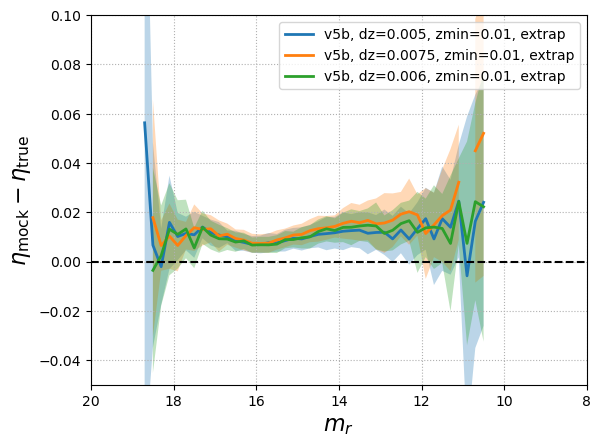

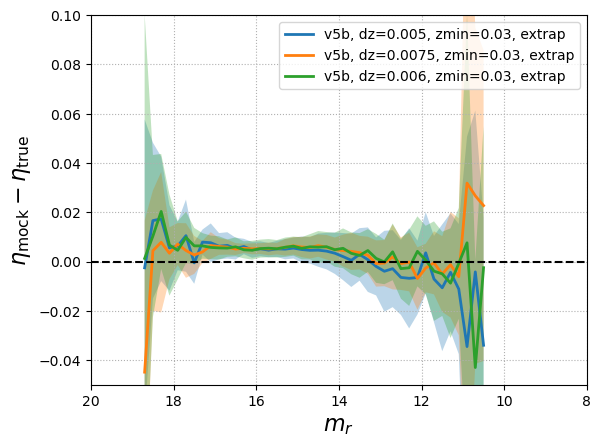

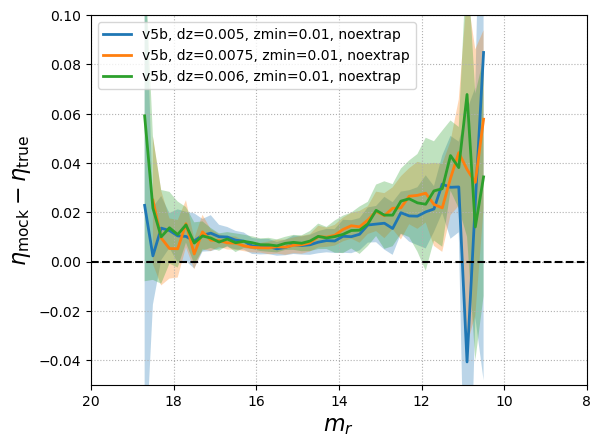

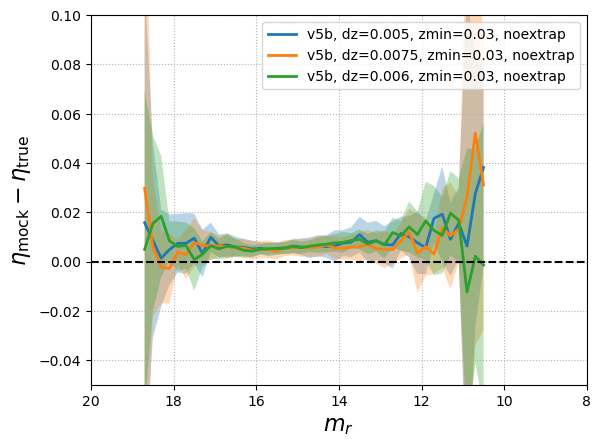

In [70]:
Mr_bins = np.arange(9, 19, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])

for i in {'v5', 'v5b', 'v7'}:
    for j in {'extrap', 'noextrap'}:
        for k in {1,3}:
            plt.figure()
            plt.grid(ls=':')
    
            for width in {50, 60, 75}:
                dz=width/10000
                zmin = (k/100)
                mc, eta_mean, eta_std = mean_delta_eta_appm(f'mock_dz{width}_{i}_zmin{k}_{j}', Mr_bins, n_mocks=10)
                
                plt.plot(mc, eta_mean, lw=2, label=f'{i}, dz={dz}, zmin={zmin}, {j}')
                plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
                
            plt.grid(ls=':')
            plt.hlines(0, 20, 8, linestyles='dashed', colors='k', zorder=5)
            plt.legend()
            plt.xlabel(r'$m_r$', fontsize=16)
            plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)
            plt.xlim(20,8)
            plt.ylim(-0.05,0.1)
            

In [62]:
cat = mock_dz50_v5_zmin1_extrap_0
app_m = cosmology.distmod(cat['ZOBS'][cat['MAIN']]).to_value('mag') + cat['R_ABSMAG_SB26'][cat['MAIN']]

## Look at how TFR parameters varied

In [ ]:
##### Read in all of the mock files

for i in range(10):
    ## population density fits
    for j in {0.005, 0.006, 0.0075}:
        version='v5'
        globals()[f'hdr_mock_dz{int(j*1e4)}_{version}_zmin1_extrap_{i}'] = fits.open(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2.5_dz={j}_zmin=0.01_mockidx={60*i}_extrap.fits')[1].header
        globals()[f'hdr_mock_dz{int(j*1e4)}_{version}_zmin1_noextrap_{i}'] = fits.open(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2.5_dz={j}_zmin=0.01_mockidx={60*i}_noextrap.fits')[1].header

        globals()[f'hdr_mock_dz{int(j*1e4)}_{version}_zmin3_extrap_{i}'] = fits.open(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2.5_dz={j}_zmin=0.03_mockidx={60*i}_extrap.fits')[1].header
        globals()[f'hdr_mock_dz{int(j*1e4)}_{version}_zmin3_noextrap_{i}'] = fits.open(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2.5_dz={j}_zmin=0.03_mockidx={60*i}_noextrap.fits')[1].header

        
        version='v5b'
        globals()[f'hdr_mock_dz{int(j*1e4)}_{version}_zmin1_extrap_{i}'] = fits.open(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2_dz={j}_zmin=0.01_mockidx={60*i}_extrap.fits')[1].header
        globals()[f'hdr_mock_dz{int(j*1e4)}_{version}_zmin1_noextrap_{i}'] = fits.open(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2_dz={j}_zmin=0.01_mockidx={60*i}_noextrap.fits')[1].header

        globals()[f'hdr_mock_dz{int(j*1e4)}_{version}_zmin3_extrap_{i}'] = fits.open(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2_dz={j}_zmin=0.03_mockidx={60*i}_extrap.fits')[1].header
        globals()[f'hdr_mock_dz{int(j*1e4)}_{version}_zmin3_noextrap_{i}'] = fits.open(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2_dz={j}_zmin=0.03_mockidx={60*i}_noextrap.fits')[1].header

        version='v7'
        globals()[f'hdr_mock_dz{int(j*1e4)}_{version}_zmin1_extrap_{i}'] = fits.open(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2.5_dz={j}_zmin=0.01_mockidx={60*i}_extrap.fits')[1].header
        globals()[f'hdr_mock_dz{int(j*1e4)}_{version}_zmin1_noextrap_{i}'] = fits.open(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2.5_dz={j}_zmin=0.01_mockidx={60*i}_noextrap.fits')[1].header

        globals()[f'hdr_mock_dz{int(j*1e4)}_{version}_zmin3_extrap_{i}'] = fits.open(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2.5_dz={j}_zmin=0.03_mockidx={60*i}_extrap.fits')[1].header
        globals()[f'hdr_mock_dz{int(j*1e4)}_{version}_zmin3_noextrap_{i}'] = fits.open(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2.5_dz={j}_zmin=0.03_mockidx={60*i}_noextrap.fits')[1].header


In [29]:
hdr_mock_dz50_v5_zmin1_extrap_0['sigma']

0.4254317061833863

In [51]:
def avg_params(hdr_prefix, n_mocks=10):
    a_vals = [] 
    sig_vals = []
    
    for num in range(n_mocks):
        # Get the catalog variable from globals()
        hdrs = globals()[f"{hdr_prefix}_{num}"]
        a_vals.append(hdrs['a'])
        sig_vals.append(hdrs['sigma'])
        
    slope = np.mean(a_vals)
    slope_err = np.std(sig_vals)
    
    sig = np.mean(a_vals)
    sig_err = np.std(sig_vals)

    print(f'slope = {slope:.4f} +/- {slope_err:.4f}')
    
    return slope, slope_err, sig, sig_err


In [54]:
for i in {'v5', 'v5b', 'v7'}:
    print(f'__________________________ version = {i}:')
    for j in {'extrap', 'noextrap'}:
        print(f'________ {j}:')
        for k in {1,3}:
            print(f'_____ zmin = {k/100}:')
            for width in {50, 60, 75}:
                print (f'binwidth={width/1e4}:')
                globals()[f'slope_mock_dz{width}_{i}_zmin{k}_{j}'],globals()[f'slope_err_mock_dz{width}_{i}_zmin{k}_{j}'], globals()[f'sig_mock_dz{width}_{i}_zmin{k}_{j}'],globals()[f'sig_err_mock_dz{width}_{i}_zmin{k}_{j}'], = avg_params(f'hdr_mock_dz{width}_{i}_zmin{k}_{j}')


__________________________ version = v5:
________ extrap:
_____ zmin = 0.01:
binwidth=0.005:
slope = -7.0512 +/- 0.0056
binwidth=0.0075:
slope = -7.0634 +/- 0.0065
binwidth=0.006:
slope = -7.0572 +/- 0.0068
_____ zmin = 0.03:
binwidth=0.005:
slope = -7.0142 +/- 0.0078
binwidth=0.0075:
slope = -7.0757 +/- 0.0062
binwidth=0.006:
slope = -6.9335 +/- 0.0083
________ noextrap:
_____ zmin = 0.01:
binwidth=0.005:
slope = -7.0301 +/- 0.0093
binwidth=0.0075:
slope = -7.0874 +/- 0.0096
binwidth=0.006:
slope = -7.0593 +/- 0.0068
_____ zmin = 0.03:
binwidth=0.005:
slope = -6.9856 +/- 0.0084
binwidth=0.0075:
slope = -7.0149 +/- 0.0098
binwidth=0.006:
slope = -6.9926 +/- 0.0085
__________________________ version = v7:
________ extrap:
_____ zmin = 0.01:
binwidth=0.005:
slope = -6.9452 +/- 0.0075
binwidth=0.0075:
slope = -6.9561 +/- 0.0079
binwidth=0.006:
slope = -6.9485 +/- 0.0085
_____ zmin = 0.03:
binwidth=0.005:
slope = -6.8301 +/- 0.0111
binwidth=0.0075:
slope = -6.8814 +/- 0.0093
binwidth=0.006

# Exploring effects of varying slopes

In [17]:
##### Read in all of the mock files

# for i in range(1):
for i in range(10):
    ## population density fits
    for z in {0.01, 0.03}:
        version='v5'
        globals()[f'mock_{version}_zmin{int(100*z)}_{i}'] = Table.read(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2.5_dz=0.005_zmin={z}_mockidx={60*i}_noextrap.fits')

        version='v8'
        globals()[f'mock_{version}_zmin{int(100*z)}_{i}'] = Table.read(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2.5_zmin={z}_mockidx={60*i}.fits')

        version='v8b'
        globals()[f'mock_{version}_zmin{int(100*z)}_{i}'] = Table.read(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2.5_zmin={z}_mockidx={60*i}.fits')

        version='v7'
        globals()[f'mock_{version}_zmin{int(100*z)}_{i}'] = Table.read(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2.5_dz=0.005_zmin={z}_mockidx={60*i}_noextrap.fits')

        version='v9'
        globals()[f'mock_{version}_zmin{int(100*z)}_{i}'] = Table.read(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2.5_dz=0.005_zmin={z}_mockidx={60*i}.fits')


## Fitting one TFR with absolute magnitude

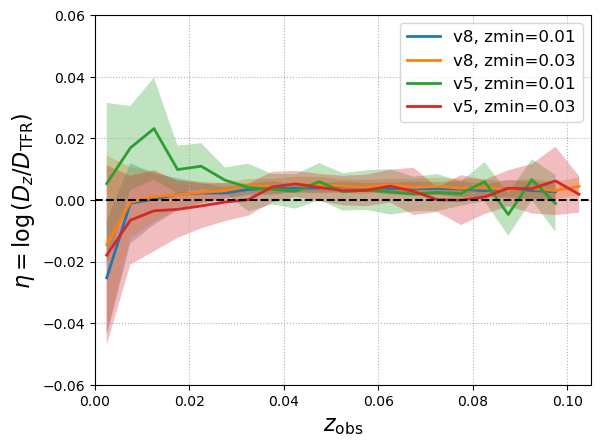

In [14]:
# fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])
cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
# plt.grid(ls=':')

plt.figure()
plt.grid(ls=':')
for i in {'v5', 'v8'}:
    for k in {1,3}:
        dz=0.005
        zmin = (k/100)
        zmax = zmin +  math.ceil(1+((0.1-zmin)/dz))*dz
        _zbins = np.arange(0, zmax, dz)
        zc = 0.5*(_zbins[1:] + _zbins[:-1])
        _, eta_mean, eta_std = mean_eta_z(f'mock_{i}_zmin{k}', n_mocks=10, zbins=_zbins)
        
        plt.plot(zc, eta_mean, lw=2, label=f'{i}, zmin={zmin}')
        plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

# Line at eta = 0
plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
# -------------------------------------------------------------------------------

plt.legend(fontsize=12)
# plt.title('Population density fits')
plt.xlabel(r'$z_\mathrm{obs}$', fontsize=16)
plt.ylabel(r'$\eta = \log{(D_z / D_\mathrm{TFR})}$', fontsize=16)

plt.xlim(0,0.105)
plt.ylim(-0.06, 0.06);
# plt.show()

# fig.savefig('tfr_mock_eta.png', dpi=150);

/global/u1/s/sgmoore1/DESI_SGA/TF/help_functions.py:68: RuntimeWarning: invalid value encountered in true_divide
  e = np.sqrt((mean2 - mean**2) / (N - 1))


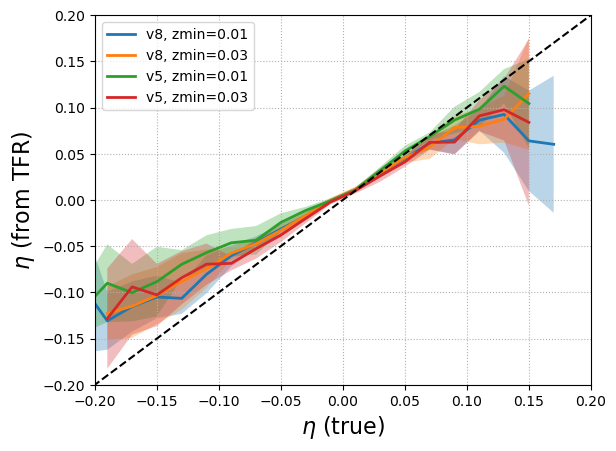

In [16]:
eta_bins = np.arange(-0.5, 0.3, 0.02)
d_eta = 0.5*np.diff(eta_bins)
eta_c = 0.5*(eta_bins[1:] + eta_bins[:-1])

plt.figure()
plt.grid(ls=':')
for i in {'v5', 'v8'}:
    for k in {1,3}:
        zmin = (k/100)
        eta_c, eta_mean, eta_std = mean_eta_eta(f'mock_{i}_zmin{k}', eta_bins, n_mocks=10)
                
        plt.plot(eta_c, eta_mean, lw=2, label=f'{i}, zmin={zmin}')
        plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
                
plt.grid(ls=':')
plt.plot([-5, 2], [-5, 2], '--', c='k')
plt.xlim([-0.2, 0.2])
plt.ylim([-0.2, 0.2])
plt.legend()
# plt.title('Population Fit', fontsize=16)
plt.xlabel(r'$\eta$ (true)', fontsize=16)
plt.ylabel(r'$\eta$ (from TFR)', fontsize=16);
            

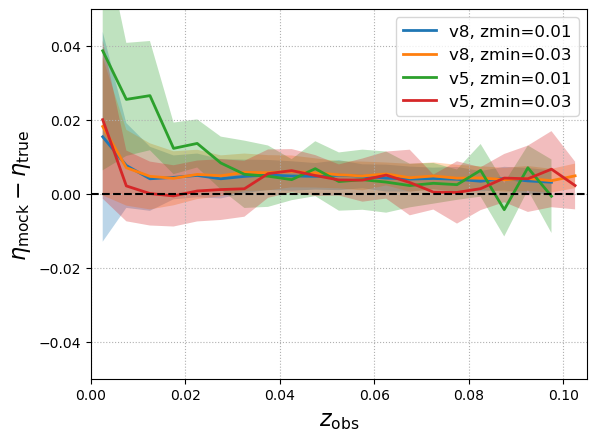

In [17]:
# fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])
cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
# plt.grid(ls=':')

plt.figure()
plt.grid(ls=':')
for i in {'v5', 'v8'}:
    for k in {1,3}:
        dz=0.005
        zmin = (k/100)
        zmax = zmin +  math.ceil(1+((0.1-zmin)/dz))*dz
        _zbins = np.arange(0, zmax, dz)
        zc = 0.5*(_zbins[1:] + _zbins[:-1])
        _, eta_mean, eta_std = mean_delta_eta_z(f'mock_{i}_zmin{k}', n_mocks=10, zbins=_zbins)
        
        plt.plot(zc, eta_mean, lw=2, label=f'{i}, zmin={zmin}')
        plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

# Line at eta = 0
plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
# -------------------------------------------------------------------------------

plt.legend(fontsize=12)
# plt.title('Population density fits')
plt.xlabel(r'$z_\mathrm{obs}$', fontsize=16)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)

plt.xlim(0,0.105)
plt.ylim(-0.05, 0.05);
        # plt.show()

# fig.savefig('tfr_mock_eta.png', dpi=150);

(-0.05, 0.05)

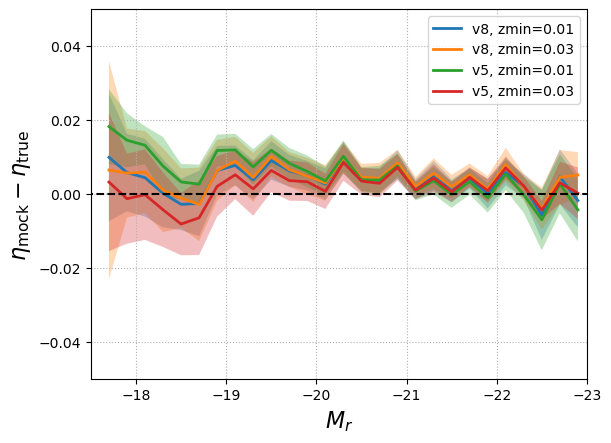

In [19]:
Mr_bins = np.arange(-24, -17, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])

plt.figure()
plt.grid(ls=':')
for i in {'v5', 'v8'}:
    for k in {1,3}:
        dz=0.005
        zmin = (k/100)
        mc, eta_mean, eta_std = mean_delta_eta_m(f'mock_{i}_zmin{k}', Mr_bins, n_mocks=10)
                
        plt.plot(mc, eta_mean, lw=2, label=f'{i}, zmin={zmin}')
        plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
                
plt.grid(ls=':')
plt.hlines(0, -24, -17, linestyles='dashed', colors='k', zorder=5)
plt.legend()
plt.xlabel(r'$M_r$', fontsize=16)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)
plt.xlim(-17.5,-23)
plt.ylim(-0.05,0.05)
            

(-0.05, 0.1)

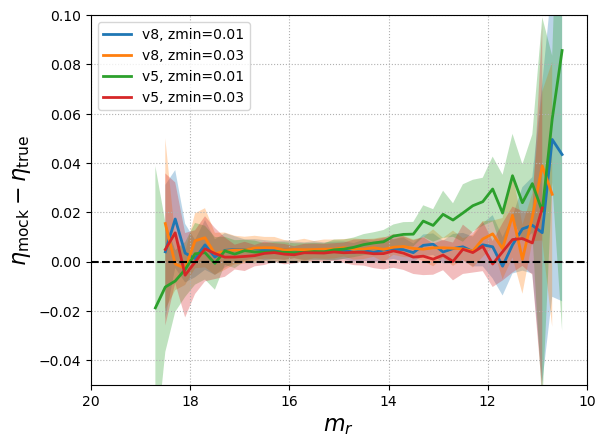

In [21]:
Mr_bins = np.arange(9, 19, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])

plt.figure()
plt.grid(ls=':')
for i in {'v5', 'v8'}:
    for k in {1,3}:
        dz=0.005
        zmin = (k/100)
        mc, eta_mean, eta_std = mean_delta_eta_appm(f'mock_{i}_zmin{k}', Mr_bins, n_mocks=10)
                
        plt.plot(mc, eta_mean, lw=2, label=f'{i}, zmin={zmin}')
        plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
                
plt.grid(ls=':')
plt.hlines(0, 20, 8, linestyles='dashed', colors='k', zorder=5)
plt.legend()
plt.xlabel(r'$m_r$', fontsize=16)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)
plt.xlim(20,10)
plt.ylim(-0.05,0.1)
            

## Fitting an independent TFR in each bin

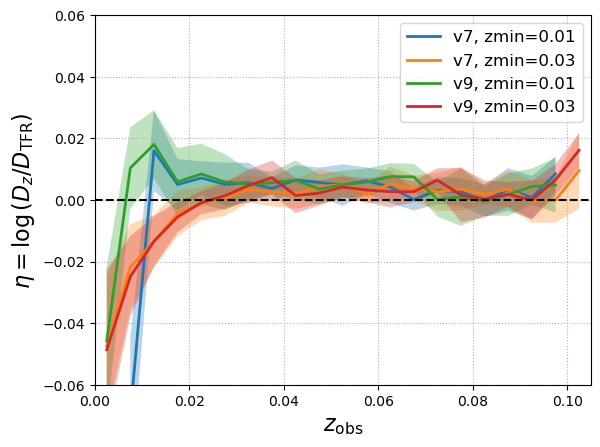

In [65]:
# fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])
cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
# plt.grid(ls=':')

plt.figure()
plt.grid(ls=':')
for i in {'v7', 'v9'}:
    for k in {1,3}:
        dz=0.005
        zmin = (k/100)
        zmax = zmin +  math.ceil(1+((0.1-zmin)/dz))*dz
        _zbins = np.arange(0, zmax, dz)
        zc = 0.5*(_zbins[1:] + _zbins[:-1])
        _, eta_mean, eta_std = mean_eta_z(f'mock_{i}_zmin{k}', n_mocks=10, zbins=_zbins)
        
        plt.plot(zc, eta_mean, lw=2, label=f'{i}, zmin={zmin}')
        plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

# Line at eta = 0
plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
# -------------------------------------------------------------------------------

plt.legend(fontsize=12)
# plt.title('Population density fits')
plt.xlabel(r'$z_\mathrm{obs}$', fontsize=16)
plt.ylabel(r'$\eta = \log{(D_z / D_\mathrm{TFR})}$', fontsize=16)

plt.xlim(0,0.105)
plt.ylim(-0.06, 0.06);
# plt.show()

# fig.savefig('tfr_mock_eta.png', dpi=150);

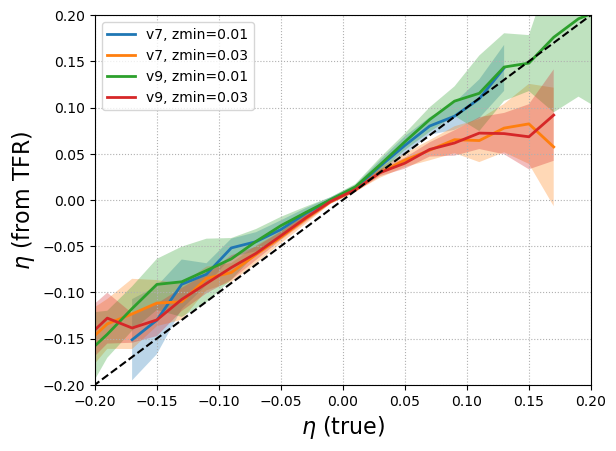

In [66]:
eta_bins = np.arange(-0.5, 0.3, 0.02)
d_eta = 0.5*np.diff(eta_bins)
eta_c = 0.5*(eta_bins[1:] + eta_bins[:-1])

plt.figure()
plt.grid(ls=':')
for i in {'v7', 'v9'}:
    for k in {1,3}:
        zmin = (k/100)
        eta_c, eta_mean, eta_std = mean_eta_eta(f'mock_{i}_zmin{k}', eta_bins, n_mocks=10)
                
        plt.plot(eta_c, eta_mean, lw=2, label=f'{i}, zmin={zmin}')
        plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
                
plt.grid(ls=':')
plt.plot([-5, 2], [-5, 2], '--', c='k')
plt.xlim([-0.2, 0.2])
plt.ylim([-0.2, 0.2])
plt.legend()
# plt.title('Population Fit', fontsize=16)
plt.xlabel(r'$\eta$ (true)', fontsize=16)
plt.ylabel(r'$\eta$ (from TFR)', fontsize=16);
            

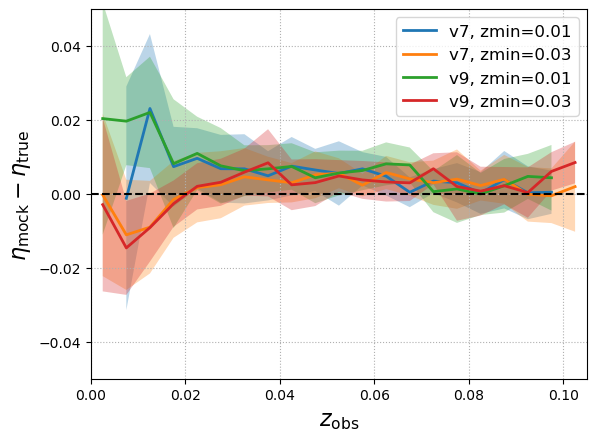

In [67]:
# fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])
cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
# plt.grid(ls=':')

plt.figure()
plt.grid(ls=':')
for i in {'v7', 'v9'}:
    for k in {1,3}:
        dz=0.005
        zmin = (k/100)
        zmax = zmin +  math.ceil(1+((0.1-zmin)/dz))*dz
        _zbins = np.arange(0, zmax, dz)
        zc = 0.5*(_zbins[1:] + _zbins[:-1])
        _, eta_mean, eta_std = mean_delta_eta_z(f'mock_{i}_zmin{k}', n_mocks=10, zbins=_zbins)
        
        plt.plot(zc, eta_mean, lw=2, label=f'{i}, zmin={zmin}')
        plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

# Line at eta = 0
plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
# -------------------------------------------------------------------------------

plt.legend(fontsize=12)
# plt.title('Population density fits')
plt.xlabel(r'$z_\mathrm{obs}$', fontsize=16)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)

plt.xlim(0,0.105)
plt.ylim(-0.05, 0.05);
        # plt.show()

# fig.savefig('tfr_mock_eta.png', dpi=150);

(-0.05, 0.05)

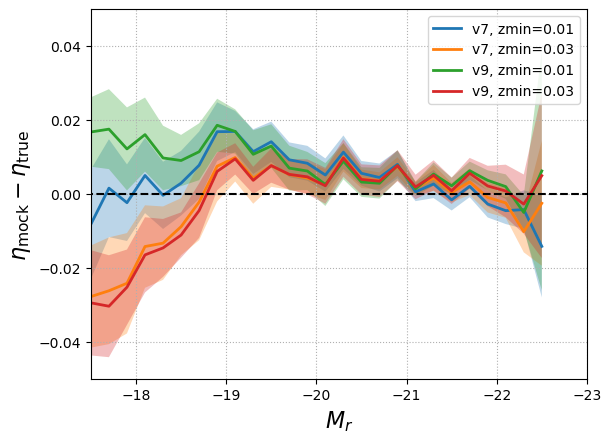

In [68]:
Mr_bins = np.arange(-24, -17, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])

plt.figure()
plt.grid(ls=':')
for i in {'v7', 'v9'}:
    for k in {1,3}:
        dz=0.005
        zmin = (k/100)
        mc, eta_mean, eta_std = mean_delta_eta_m(f'mock_{i}_zmin{k}', Mr_bins, n_mocks=10)
                
        plt.plot(mc, eta_mean, lw=2, label=f'{i}, zmin={zmin}')
        plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
                
plt.grid(ls=':')
plt.hlines(0, -24, -17, linestyles='dashed', colors='k', zorder=5)
plt.legend()
plt.xlabel(r'$M_r$', fontsize=16)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)
plt.xlim(-17.5,-23)
plt.ylim(-0.05,0.05)
            

(-0.05, 0.1)

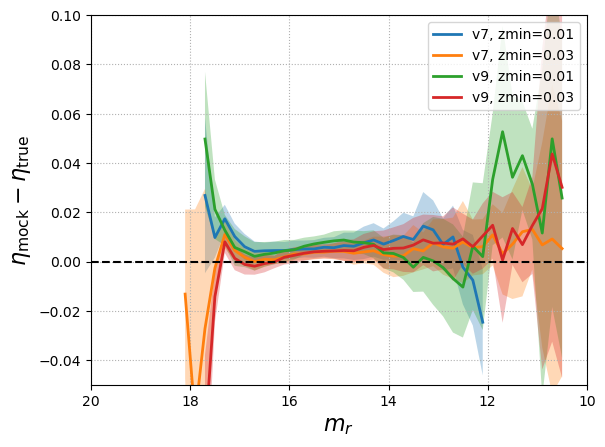

In [69]:
Mr_bins = np.arange(9, 19, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])

plt.figure()
plt.grid(ls=':')
for i in {'v7', 'v9'}:
    for k in {1,3}:
        dz=0.005
        zmin = (k/100)
        mc, eta_mean, eta_std = mean_delta_eta_appm(f'mock_{i}_zmin{k}', Mr_bins, n_mocks=10)
                
        plt.plot(mc, eta_mean, lw=2, label=f'{i}, zmin={zmin}')
        plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
                
plt.grid(ls=':')
plt.hlines(0, 20, 8, linestyles='dashed', colors='k', zorder=5)
plt.legend()
plt.xlabel(r'$m_r$', fontsize=16)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)
plt.xlim(20,10)
plt.ylim(-0.05,0.1)
plt.show()
            

### Look at how these slopes evolve with redshift

In [41]:
for i in range(10):
    version='v8b'
    z=0.01
    globals()[f'hdr_mock_{version}_zmin{int(100*z)}_{i}'] = fits.open(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2.5_zmin={z}_mockidx={60*i}.fits')[1].header
    # globals()[f'hdr_mock_{version}_zmin{int(100*z)}_{i}'] = fits.open(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2.5_dz=0.005_zmin={z}_mockidx={60*i}.fits')[1].header

In [44]:
slopes = np.array([
    [globals()[f'hdr_mock_v8b_zmin1_{j}'][f'a{i}'] for i in range(1, 18)]
    for j in range(10)
])

intercepts = np.array([
    [globals()[f'hdr_mock_v8b_zmin1_{j}'][f'b{i}'] for i in range(1, 18)]
    for j in range(10)
])

a_mean = slopes.mean(axis=0)
a_std  = slopes.std(axis=0, ddof=1)
b_mean = intercepts.mean(axis=0)
b_std  = intercepts.std(axis=0, ddof=1)

Text(0.5, 0, '$z$')

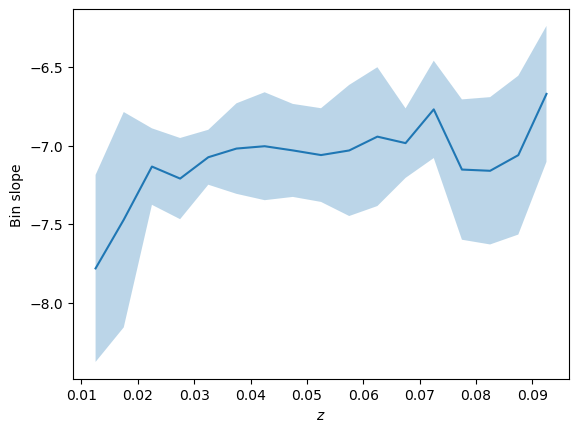

In [46]:
zbins = np.arange(0.01, 0.1, 0.005)
dz = 0.5*np.diff(zbins)
zc = 0.5*(zbins[1:] + zbins[:-1])

plt.figure()
plt.plot(zc, a_mean)
plt.fill_between(zc, a_mean - a_std, a_mean + a_std, alpha=0.3)
plt.ylabel('Bin slope')
plt.xlabel(r'$z$')

In [47]:
##### grabbed from v9 notebook for plotting sake
logV0 = 2.178618969360148
cosmo = FlatLambdaCDM(H0=H0, Om0=0.3151)
mu_zc = cosmo.distmod(zc)
B_mean = b_mean - mu_zc.value

In [48]:
B_mean

array([-20.51614105, -20.46979066, -20.46528219, -20.48793277,
       -20.46750522, -20.47254349, -20.46767528, -20.48457903,
       -20.47887983, -20.4800393 , -20.47963016, -20.48097852,
       -20.50916428, -20.44929571, -20.45271316, -20.46602363,
       -20.51686316])

Text(0, 0.5, '$M_r$')

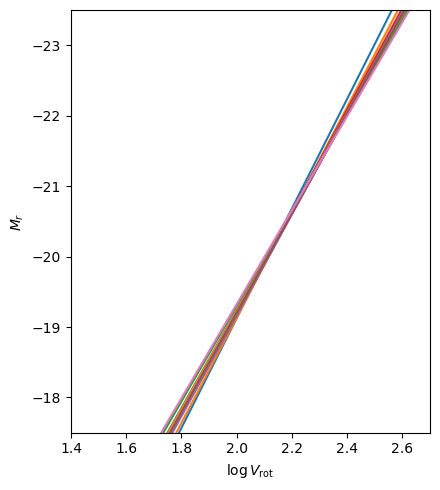

In [61]:
x = np.linspace(10, 200, 500)
# v = np.linspace(-1*np.ones(len(zbins)-1), 3.5*np.ones(len(zbins)-1), 100)
v=np.linspace(-1,3.5,100)
plt.figure(figsize=(4.5,5), tight_layout=True)
for i in range(17):
    y = a_mean[i] * (v-logV0) + B_mean[i]
    yerr = np.sqrt((v * a_std[i])**2 + b_std[i]**2)
    plt.plot(v, y)
    # plt.fill_between(
    #     v,
    #     y - yerr,
    #     y + yerr,
    #     alpha=0.3,
    # )


# plt.fill_between(v,y - yerr, y + yerr,alpha=0.3, label='Uncertainty')
# plt.legend()
plt.xlim([1.4, 2.7])
plt.ylim([-17.5, -23.5])
plt.xlabel(r'$\log V_{\rm rot}$')
plt.ylabel(r'$M_r$')

In [122]:
#### Now check how these correlate with the ellipse tilts

ellipses = Table.read('/pscratch/sd/s/sgmoore1/TF/TF_Y1_v7_ellipse_fit_mr_dz=0.005_zmin=0_params.fits')
ellipse_phi = 0.5*np.arctan(2*ellipses['COV_XY']/(ellipses['COV_XX'] - ellipses['COV_YY']))

ellipse_phi = ellipse_phi[2:]
len(ellipse_phi)

18

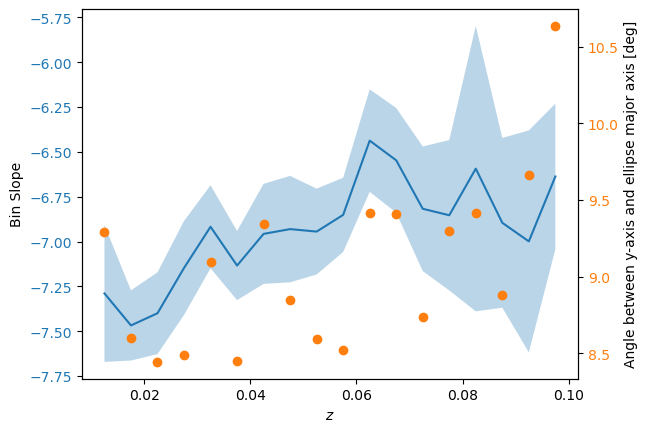

In [130]:
fig, ax1 = plt.subplots()

ax2 = ax1.twinx()  # second y-axis sharing the same x

ax1.plot(zc, a_mean)
ax1.fill_between(zc, a_mean - a_std, a_mean + a_std, alpha=0.3)

ax2.scatter(zc, np.degrees(ellipse_phi), color='tab:orange')

ax1.set_xlabel(r'$z$')
ax1.set_ylabel('Bin Slope')
ax2.set_ylabel('Angle between y-axis and ellipse major axis [deg]')

ax1.tick_params(axis='y', labelcolor='tab:blue')
ax2.tick_params(axis='y', labelcolor='tab:orange')

plt.show()

## Compare these two methods to each other (single ellipse)

### At fixed zmin=0.03

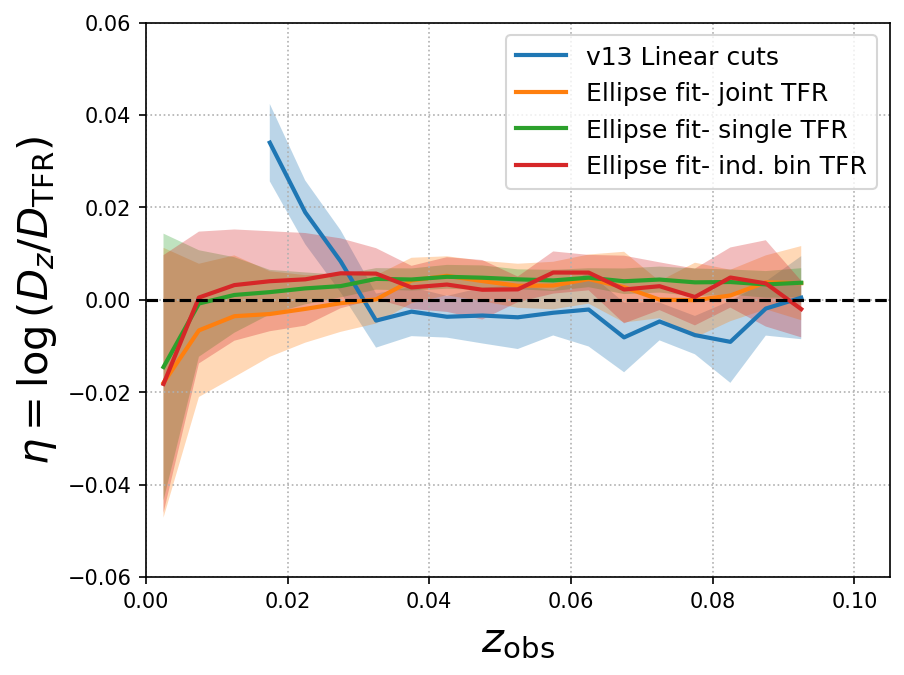

In [49]:
# fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])
cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
# plt.grid(ls=':')

plt.figure(dpi=150, facecolor='none')
plt.grid(ls=':')
dz=0.005
zmin = 0.03
zmax = 0.1

_zbins = np.arange(0, zmax, dz)
zc = 0.5*(_zbins[1:] + _zbins[:-1])

# --------------------------------------------------- plot each fit
## v13 mock fit
_, eta_mean, eta_std = mean_eta_z(f'mock_v13', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='v13 Linear cuts')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

## v5 fit (pop ellipse)
_, eta_mean, eta_std = mean_eta_z(f'mock_v5_zmin3', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='Ellipse fit- joint TFR')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


_, eta_mean, eta_std = mean_eta_z(f'mock_v8_zmin3', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='Ellipse fit- single TFR')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


_, eta_mean, eta_std = mean_eta_z(f'mock_v8b_zmin3', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='Ellipse fit- ind. bin TFR')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)



    
# Line at eta = 0
plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
# -------------------------------------------------------------------------------

plt.legend(fontsize=12)
# plt.title('Population density fits')
plt.xlabel(r'$z_\mathrm{obs}$', fontsize=20)
plt.ylabel(r'$\eta = \log{(D_z / D_\mathrm{TFR})}$', fontsize=20)

plt.xlim(0,0.105)
plt.ylim(-0.06, 0.06);
# plt.show()

# fig.savefig('tfr_mock_eta.png', dpi=150);

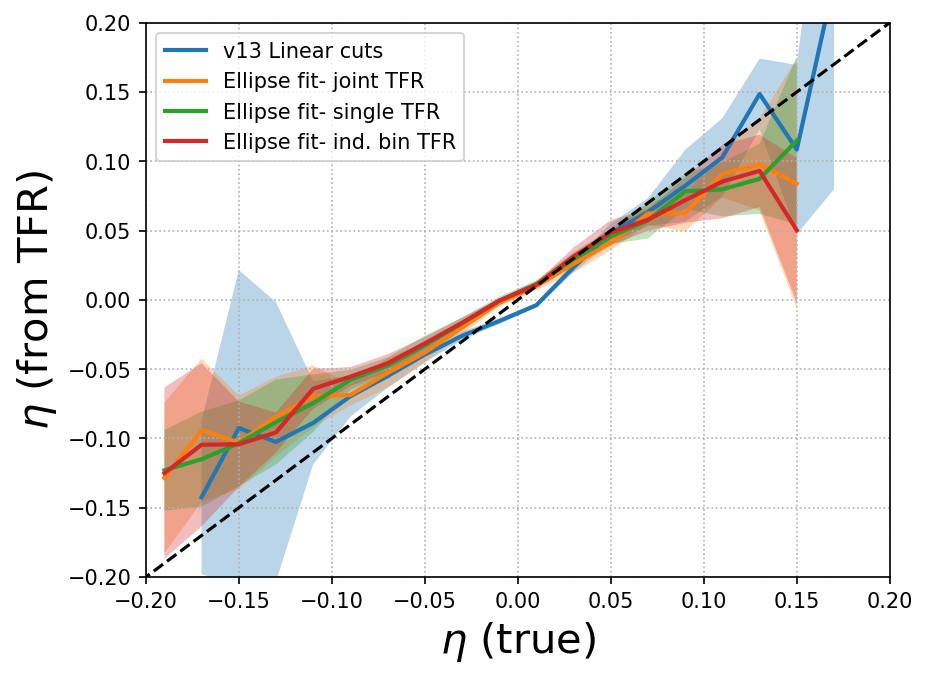

In [48]:
eta_bins = np.arange(-0.5, 0.3, 0.02)
d_eta = 0.5*np.diff(eta_bins)
eta_c = 0.5*(eta_bins[1:] + eta_bins[:-1])

plt.figure(dpi=150, facecolor='none')
# --------------------------------------------------- plot each fit
## v13 mock fit
eta_c, eta_mean, eta_std = mean_eta_eta(f'mock_v13', n_mocks=10, eta_bins=eta_bins)

plt.plot(eta_c, eta_mean, lw=2, label='v13 Linear cuts')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

## v5 fit (pop ellipse)
eta_c, eta_mean, eta_std = mean_eta_eta(f'mock_v5_zmin3', n_mocks=10, eta_bins=eta_bins)

plt.plot(eta_c, eta_mean, lw=2, label='Ellipse fit- joint TFR')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


eta_c, eta_mean, eta_std = mean_eta_eta(f'mock_v8_zmin3', n_mocks=10, eta_bins=eta_bins)

plt.plot(eta_c, eta_mean, lw=2, label='Ellipse fit- single TFR')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


eta_c, eta_mean, eta_std = mean_eta_eta(f'mock_v8b_zmin3', n_mocks=10, eta_bins=eta_bins)

plt.plot(eta_c, eta_mean, lw=2, label='Ellipse fit- ind. bin TFR')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

                
plt.grid(ls=':')
plt.plot([-5, 2], [-5, 2], '--', c='k')
plt.xlim([-0.2, 0.2])
plt.ylim([-0.2, 0.2])
plt.legend()
# plt.title('Population Fit', fontsize=16)
plt.xlabel(r'$\eta$ (true)', fontsize=20)
plt.ylabel(r'$\eta$ (from TFR)', fontsize=20);
            

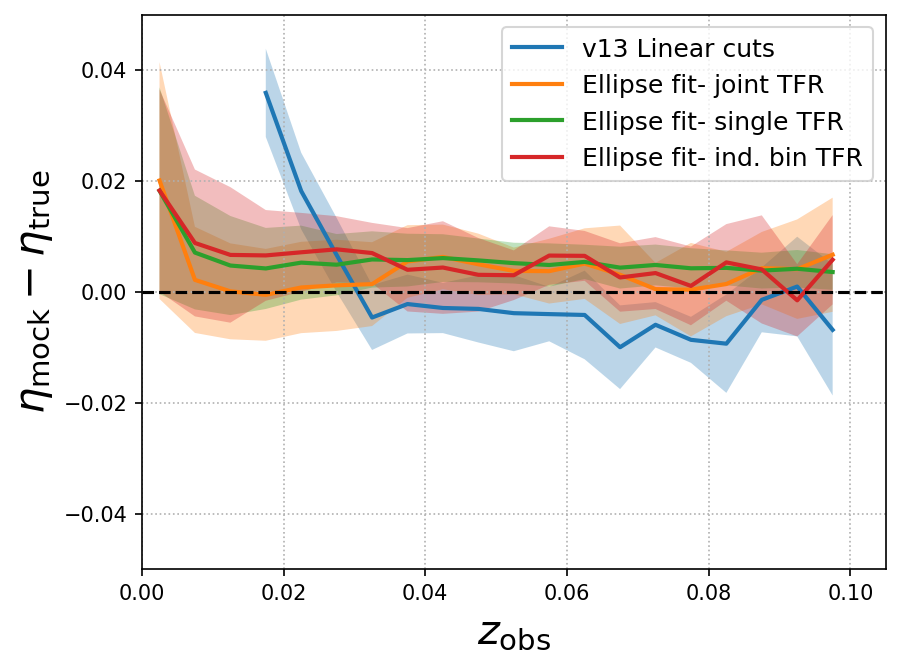

In [47]:
# fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])
cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
plt.figure(dpi=150, facecolor='none')
plt.grid(ls=':')


# --------------------------------------------------- plot each fit
## v13 mock fit
_, eta_mean, eta_std = mean_delta_eta_z(f'mock_v13', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='v13 Linear cuts')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

## v5 fit (pop ellipse)
_, eta_mean, eta_std = mean_delta_eta_z(f'mock_v5_zmin3', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='Ellipse fit- joint TFR')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


_, eta_mean, eta_std = mean_delta_eta_z(f'mock_v8_zmin3', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='Ellipse fit- single TFR')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


_, eta_mean, eta_std = mean_delta_eta_z(f'mock_v8b_zmin3', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='Ellipse fit- ind. bin TFR')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)



# Line at eta = 0
plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
# -------------------------------------------------------------------------------

plt.legend(fontsize=12)
# plt.title('Population density fits')
plt.xlabel(r'$z_\mathrm{obs}$', fontsize=20)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=20)

plt.xlim(0,0.105)
plt.ylim(-0.05, 0.05);
            # plt.show()

# fig.savefig('tfr_mock_eta.png', dpi=150);

(-0.2, 0.2)

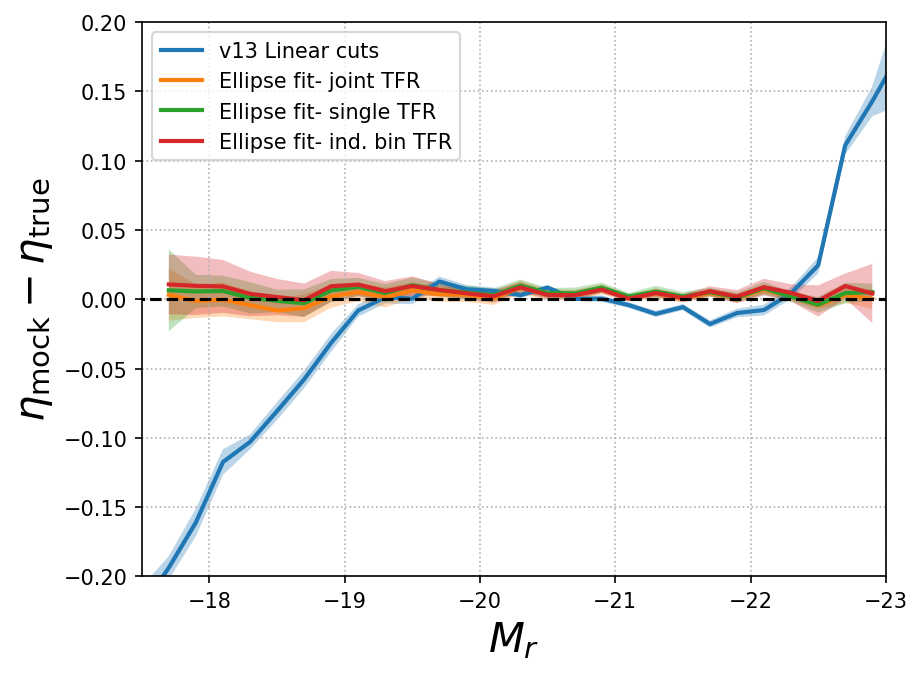

In [50]:
Mr_bins = np.arange(-24, -17, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])
plt.figure(dpi=150, facecolor='none')
# --------------------------------------------------- plot each fit
## v13 mock fit
_, eta_mean, eta_std = mean_delta_eta_m(f'mock_v13', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='v13 Linear cuts')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

## v5 fit (pop ellipse)
_, eta_mean, eta_std = mean_delta_eta_m(f'mock_v5_zmin3', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='Ellipse fit- joint TFR')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


_, eta_mean, eta_std = mean_delta_eta_m(f'mock_v8_zmin3', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='Ellipse fit- single TFR')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


_, eta_mean, eta_std = mean_delta_eta_m(f'mock_v8b_zmin3', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='Ellipse fit- ind. bin TFR')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


                
plt.grid(ls=':')
plt.hlines(0, -24, -17, linestyles='dashed', colors='k', zorder=5)
plt.legend()
plt.xlabel(r'$M_r$', fontsize=20)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=20)
plt.xlim(-17.5,-23)
plt.ylim(-0.2,0.2)
                

(-0.05, 0.1)

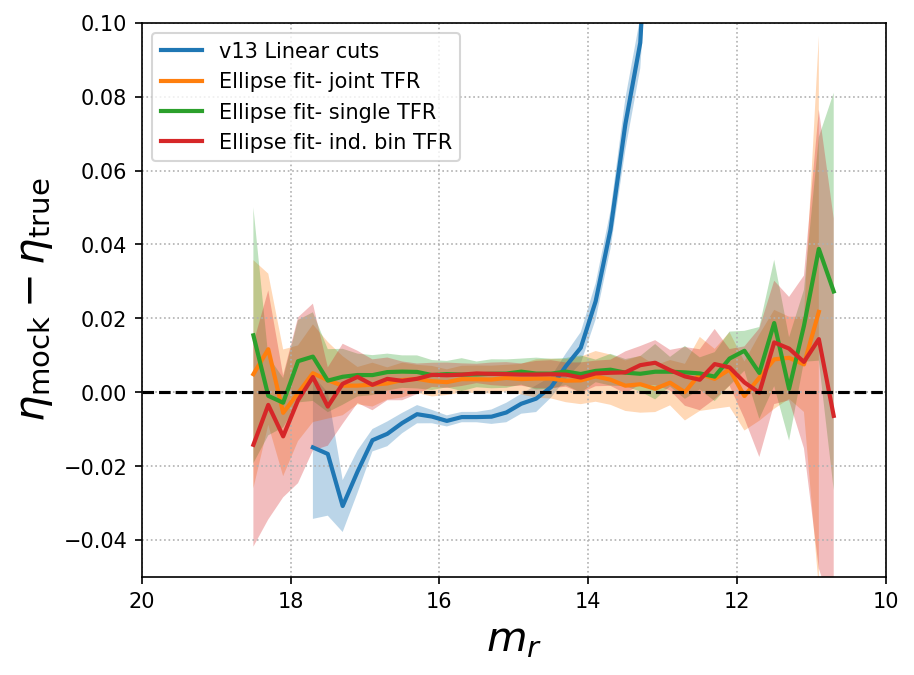

In [51]:
Mr_bins = np.arange(9, 19, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])
plt.figure(dpi=150, facecolor='none')
# --------------------------------------------------- plot each fit
## v13 mock fit
_, eta_mean, eta_std = mean_delta_eta_appm(f'mock_v13', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='v13 Linear cuts')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

## v5 fit (pop ellipse)
_, eta_mean, eta_std = mean_delta_eta_appm(f'mock_v5_zmin3', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='Ellipse fit- joint TFR')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


_, eta_mean, eta_std = mean_delta_eta_appm(f'mock_v8_zmin3', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='Ellipse fit- single TFR')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


_, eta_mean, eta_std = mean_delta_eta_appm(f'mock_v8b_zmin3', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='Ellipse fit- ind. bin TFR')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


plt.grid(ls=':')
plt.hlines(0, 20, 8, linestyles='dashed', colors='k', zorder=5)
plt.legend()
plt.xlabel(r'$m_r$', fontsize=20)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=20)
plt.xlim(20,10)
plt.ylim(-0.05,0.1)
            

### At varying zmin=0.01 or zmin=0.03

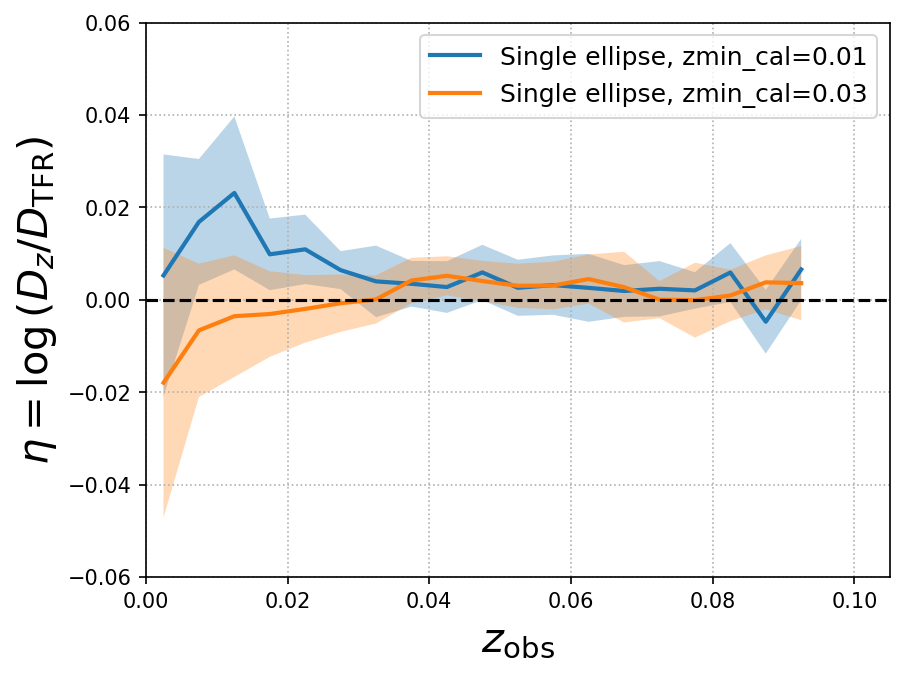

In [81]:
# fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])
cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
# plt.grid(ls=':')

plt.figure(dpi=150, facecolor='none')
plt.grid(ls=':')
dz=0.005
zmin = 0.03
zmax = 0.1

_zbins = np.arange(0, zmax, dz)
zc = 0.5*(_zbins[1:] + _zbins[:-1])

# --------------------------------------------------- plot each fit
## v5 fit (pop ellipse)
_, eta_mean, eta_std = mean_eta_z(f'mock_v5_zmin1', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='Single ellipse, zmin_cal=0.01')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

_, eta_mean, eta_std = mean_eta_z(f'mock_v5_zmin3', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='Single ellipse, zmin_cal=0.03')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


    
# Line at eta = 0
plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
# -------------------------------------------------------------------------------

plt.legend(fontsize=12)
# plt.title('Population density fits')
plt.xlabel(r'$z_\mathrm{obs}$', fontsize=20)
plt.ylabel(r'$\eta = \log{(D_z / D_\mathrm{TFR})}$', fontsize=20)

plt.xlim(0,0.105)
plt.ylim(-0.06, 0.06);
# plt.show()

# fig.savefig('tfr_mock_eta.png', dpi=150);

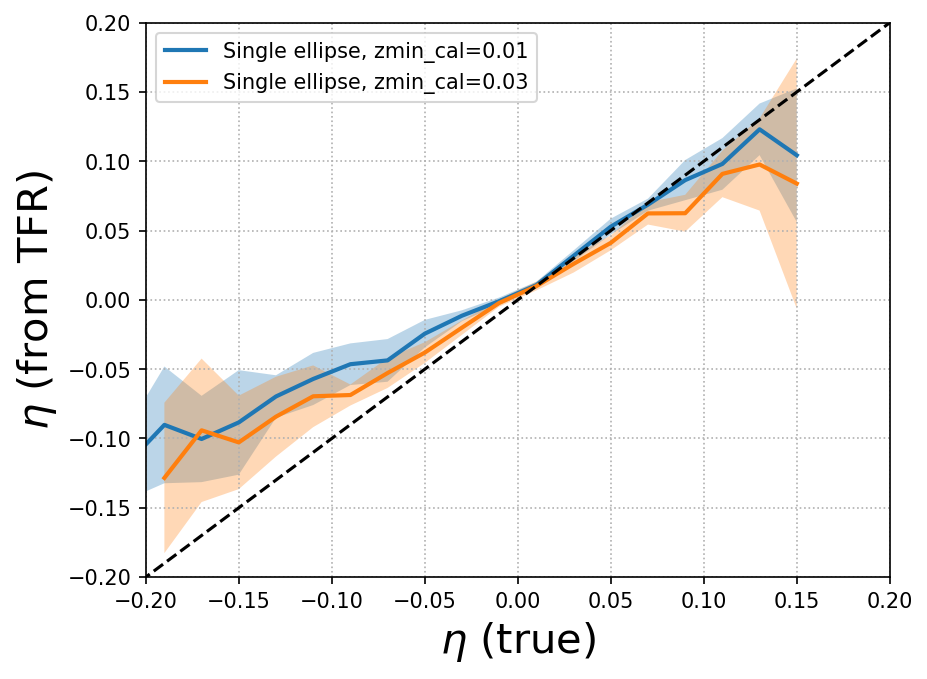

In [84]:
eta_bins = np.arange(-0.5, 0.3, 0.02)
d_eta = 0.5*np.diff(eta_bins)
eta_c = 0.5*(eta_bins[1:] + eta_bins[:-1])

plt.figure(dpi=150, facecolor='none')
# --------------------------------------------------- plot each fit
eta_c, eta_mean, eta_std = mean_eta_eta(f'mock_v5_zmin1', n_mocks=10, eta_bins=eta_bins)

plt.plot(eta_c, eta_mean, lw=2, label='Single ellipse, zmin_cal=0.01')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


eta_c, eta_mean, eta_std = mean_eta_eta(f'mock_v5_zmin3', n_mocks=10, eta_bins=eta_bins)

plt.plot(eta_c, eta_mean, lw=2, label='Single ellipse, zmin_cal=0.03')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

                
plt.grid(ls=':')
plt.plot([-5, 2], [-5, 2], '--', c='k')
plt.xlim([-0.2, 0.2])
plt.ylim([-0.2, 0.2])
plt.legend()
# plt.title('Population Fit', fontsize=16)
plt.xlabel(r'$\eta$ (true)', fontsize=20)
plt.ylabel(r'$\eta$ (from TFR)', fontsize=20);
            

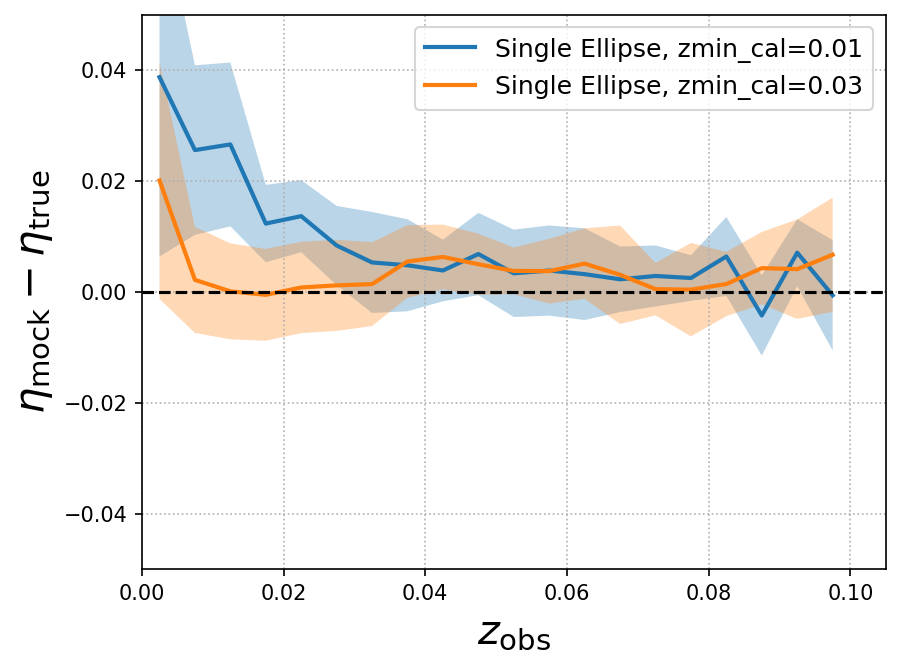

In [83]:
# fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])
cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
plt.figure(dpi=150, facecolor='none')
plt.grid(ls=':')


# --------------------------------------------------- plot each fit
_, eta_mean, eta_std = mean_delta_eta_z(f'mock_v5_zmin1', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='Single Ellipse, zmin_cal=0.01')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


_, eta_mean, eta_std = mean_delta_eta_z(f'mock_v5_zmin3', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='Single Ellipse, zmin_cal=0.03')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)





# Line at eta = 0
plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
# -------------------------------------------------------------------------------

plt.legend(fontsize=12)
# plt.title('Population density fits')
plt.xlabel(r'$z_\mathrm{obs}$', fontsize=20)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=20)

plt.xlim(0,0.105)
plt.ylim(-0.05, 0.05);
            # plt.show()

# fig.savefig('tfr_mock_eta.png', dpi=150);

(-0.05, 0.05)

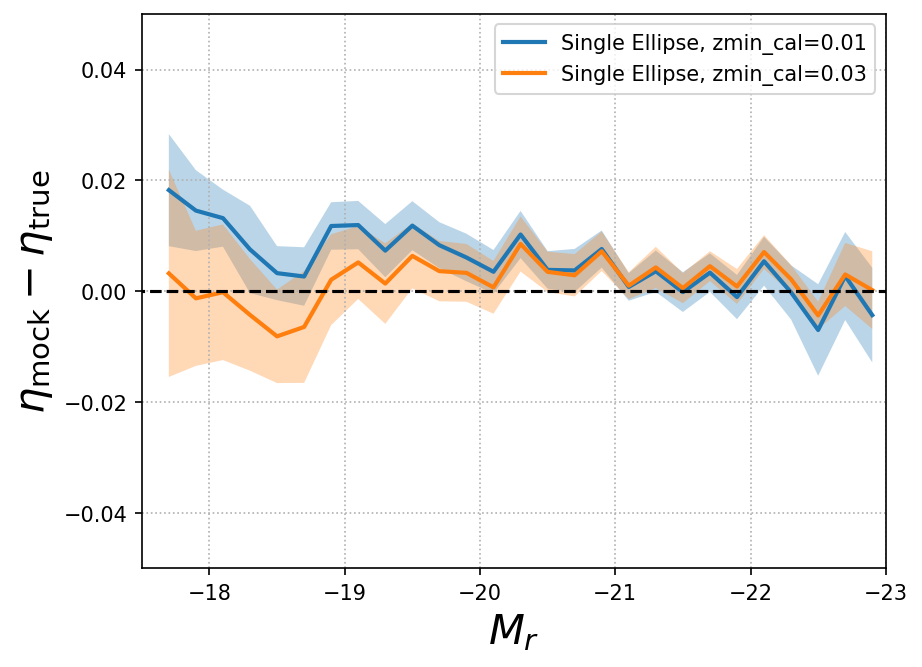

In [86]:
Mr_bins = np.arange(-24, -17, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])
plt.figure(dpi=150, facecolor='none')
# --------------------------------------------------- plot each fit
_, eta_mean, eta_std = mean_delta_eta_m(f'mock_v5_zmin1', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='Single Ellipse, zmin_cal=0.01')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


_, eta_mean, eta_std = mean_delta_eta_m(f'mock_v5_zmin3', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='Single Ellipse, zmin_cal=0.03')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

                
plt.grid(ls=':')
plt.hlines(0, -24, -17, linestyles='dashed', colors='k', zorder=5)
plt.legend()
plt.xlabel(r'$M_r$', fontsize=20)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=20)
plt.xlim(-17.5,-23)
# plt.ylim(-0.2,0.2)
plt.ylim(-0.05,0.05)
                

(-0.05, 0.1)

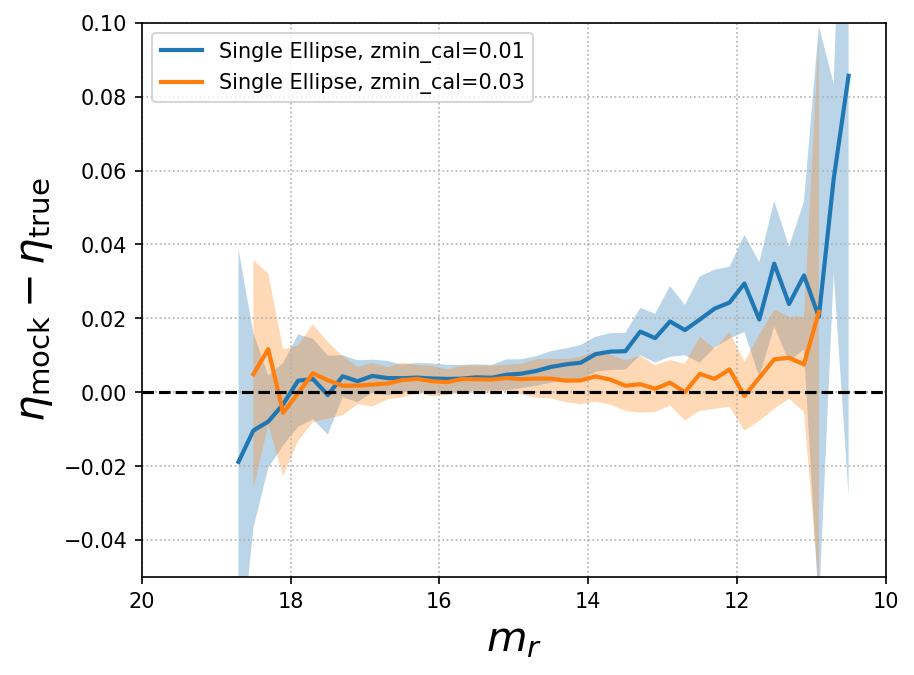

In [87]:
Mr_bins = np.arange(9, 19, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])
plt.figure(dpi=150, facecolor='none')
# --------------------------------------------------- plot each fit
_, eta_mean, eta_std = mean_delta_eta_appm(f'mock_v5_zmin1', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='Single Ellipse, zmin_cal=0.01')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


_, eta_mean, eta_std = mean_delta_eta_appm(f'mock_v5_zmin3', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='Single Ellipse, zmin_cal=0.03')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


plt.grid(ls=':')
plt.hlines(0, 20, 8, linestyles='dashed', colors='k', zorder=5)
plt.legend()
plt.xlabel(r'$m_r$', fontsize=20)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=20)
plt.xlim(20,10)
plt.ylim(-0.05,0.1)
            

## Compare these two methods to each other (binned ellipses)

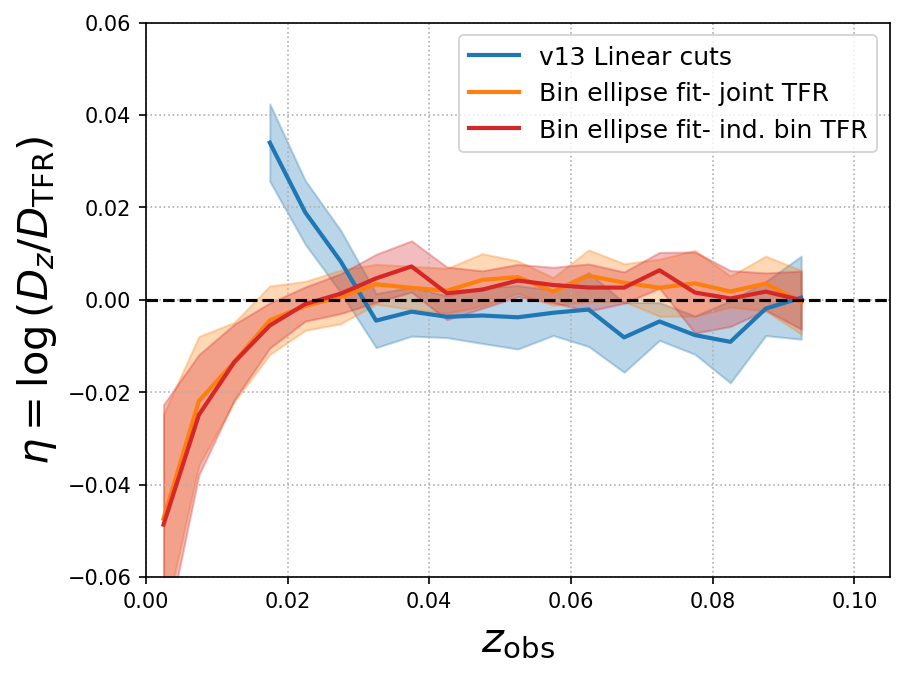

In [57]:
# fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])
cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
# plt.grid(ls=':')

plt.figure(dpi=150, facecolor='none')
plt.grid(ls=':')
dz=0.005
zmin = 0.03
zmax = 0.1

_zbins = np.arange(0, zmax, dz)
zc = 0.5*(_zbins[1:] + _zbins[:-1])

# --------------------------------------------------- plot each fit
## v13 mock fit
_, eta_mean, eta_std = mean_eta_z(f'mock_v13', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='v13 Linear cuts', color='tab:blue')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3, color='tab:blue')

## v5 fit (pop ellipse)
_, eta_mean, eta_std = mean_eta_z(f'mock_v7_zmin3', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='Bin ellipse fit- joint TFR', color='tab:orange')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3, color='tab:orange')


_, eta_mean, eta_std = mean_eta_z(f'mock_v9_zmin3', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='Bin ellipse fit- ind. bin TFR', color='tab:red')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3, color='tab:red')



    
# Line at eta = 0
plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
# -------------------------------------------------------------------------------

plt.legend(fontsize=12)
# plt.title('Population density fits')
plt.xlabel(r'$z_\mathrm{obs}$', fontsize=20)
plt.ylabel(r'$\eta = \log{(D_z / D_\mathrm{TFR})}$', fontsize=20)

plt.xlim(0,0.105)
plt.ylim(-0.06, 0.06);
# plt.show()

# fig.savefig('tfr_mock_eta.png', dpi=150);

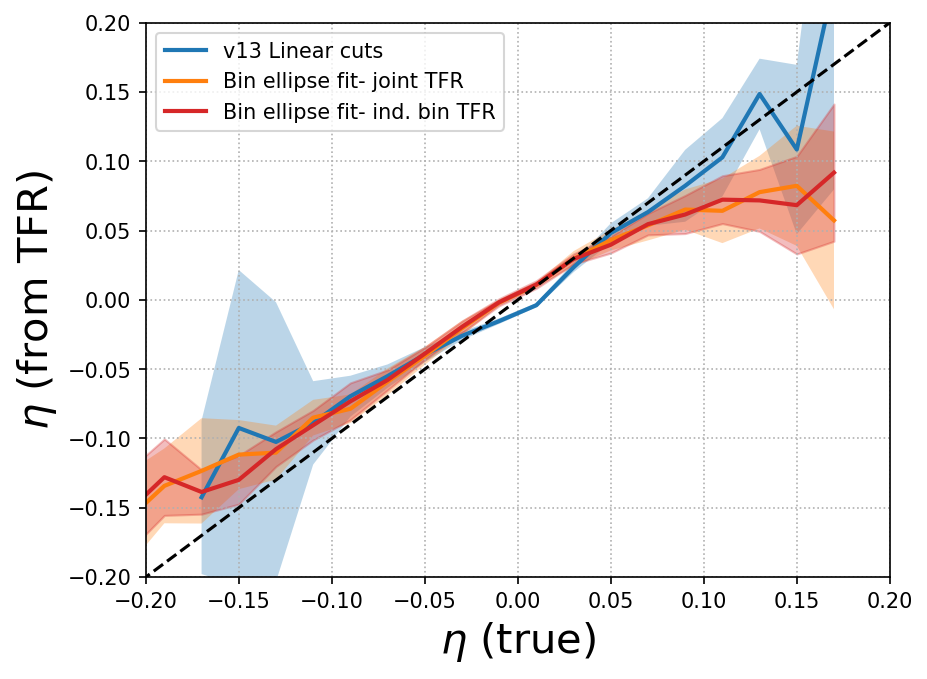

In [62]:
eta_bins = np.arange(-0.5, 0.3, 0.02)
d_eta = 0.5*np.diff(eta_bins)
eta_c = 0.5*(eta_bins[1:] + eta_bins[:-1])

plt.figure(dpi=150, facecolor='none')
# --------------------------------------------------- plot each fit
## v13 mock fit
eta_c, eta_mean, eta_std = mean_eta_eta(f'mock_v13', n_mocks=10, eta_bins=eta_bins)

plt.plot(eta_c, eta_mean, lw=2, label='v13 Linear cuts')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

## v5 fit (pop ellipse)
eta_c, eta_mean, eta_std = mean_eta_eta(f'mock_v7_zmin3', n_mocks=10, eta_bins=eta_bins)

plt.plot(eta_c, eta_mean, lw=2, label='Bin ellipse fit- joint TFR')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


eta_c, eta_mean, eta_std = mean_eta_eta(f'mock_v9_zmin3', n_mocks=10, eta_bins=eta_bins)

plt.plot(eta_c, eta_mean, lw=2, label='Bin ellipse fit- ind. bin TFR', color='tab:red')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3, color='tab:red')

                
plt.grid(ls=':')
plt.plot([-5, 2], [-5, 2], '--', c='k')
plt.xlim([-0.2, 0.2])
plt.ylim([-0.2, 0.2])
plt.legend()
# plt.title('Population Fit', fontsize=16)
plt.xlabel(r'$\eta$ (true)', fontsize=20)
plt.ylabel(r'$\eta$ (from TFR)', fontsize=20);
            

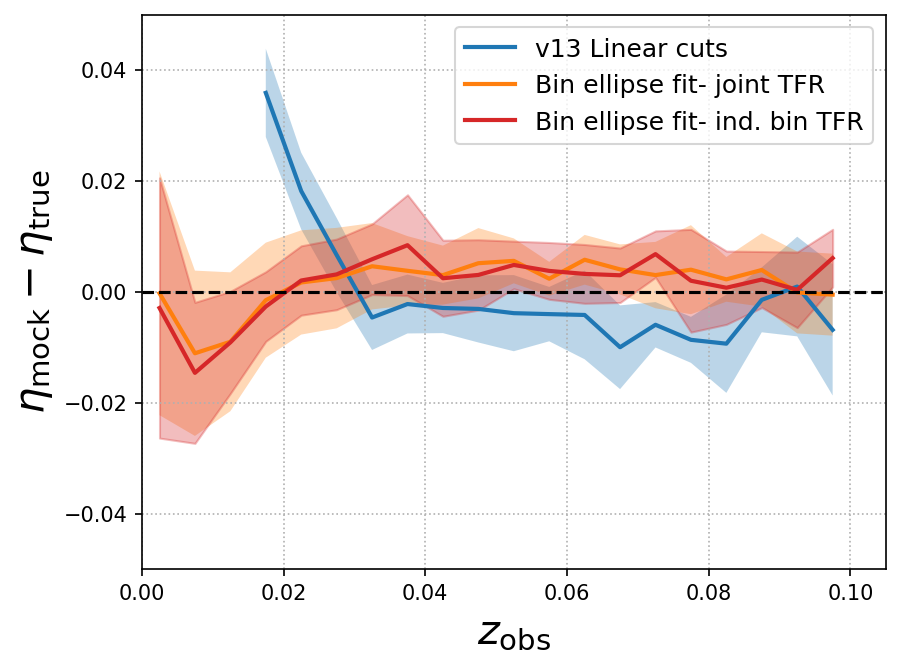

In [59]:
# fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])
cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
plt.figure(dpi=150, facecolor='none')
plt.grid(ls=':')


# --------------------------------------------------- plot each fit
## v13 mock fit
_, eta_mean, eta_std = mean_delta_eta_z(f'mock_v13', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='v13 Linear cuts')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

## v5 fit (pop ellipse)
_, eta_mean, eta_std = mean_delta_eta_z(f'mock_v7_zmin3', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='Bin ellipse fit- joint TFR')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)



_, eta_mean, eta_std = mean_delta_eta_z(f'mock_v9_zmin3', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='Bin ellipse fit- ind. bin TFR', color='tab:red')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3, color='tab:red')



# Line at eta = 0
plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
# -------------------------------------------------------------------------------

plt.legend(fontsize=12)
# plt.title('Population density fits')
plt.xlabel(r'$z_\mathrm{obs}$', fontsize=20)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=20)

plt.xlim(0,0.105)
plt.ylim(-0.05, 0.05);
            # plt.show()

# fig.savefig('tfr_mock_eta.png', dpi=150);

(-0.2, 0.2)

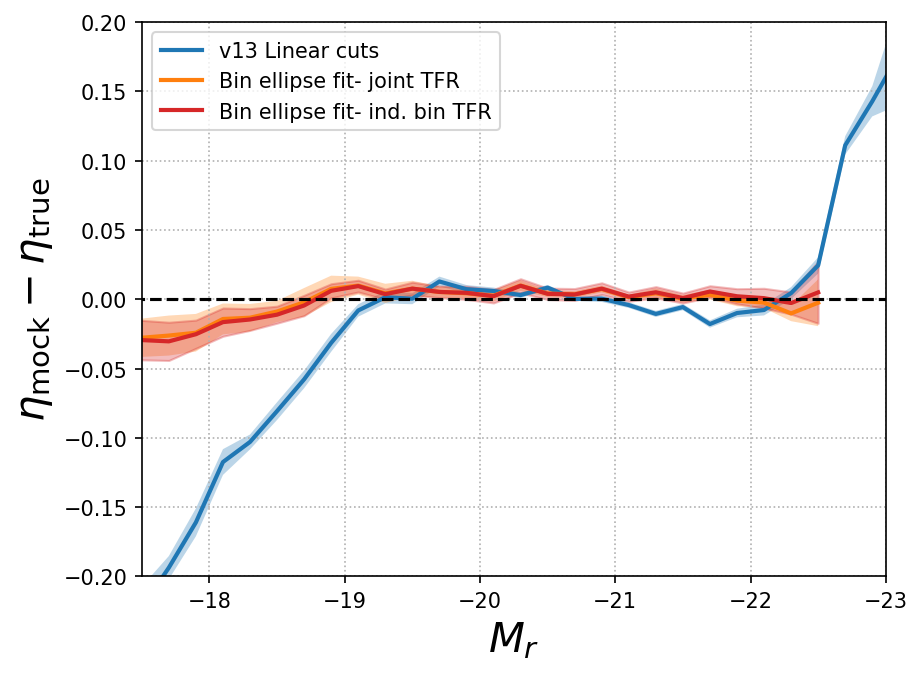

In [60]:
Mr_bins = np.arange(-24, -17, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])
plt.figure(dpi=150, facecolor='none')
# --------------------------------------------------- plot each fit
## v13 mock fit
_, eta_mean, eta_std = mean_delta_eta_m(f'mock_v13', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='v13 Linear cuts')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

## v5 fit (pop ellipse)
_, eta_mean, eta_std = mean_delta_eta_m(f'mock_v7_zmin3', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='Bin ellipse fit- joint TFR')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


_, eta_mean, eta_std = mean_delta_eta_m(f'mock_v9_zmin3', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='Bin ellipse fit- ind. bin TFR', color='tab:red')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3, color='tab:red')


                
plt.grid(ls=':')
plt.hlines(0, -24, -17, linestyles='dashed', colors='k', zorder=5)
plt.legend()
plt.xlabel(r'$M_r$', fontsize=20)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=20)
plt.xlim(-17.5,-23)
plt.ylim(-0.2,0.2)
                

(-0.05, 0.1)

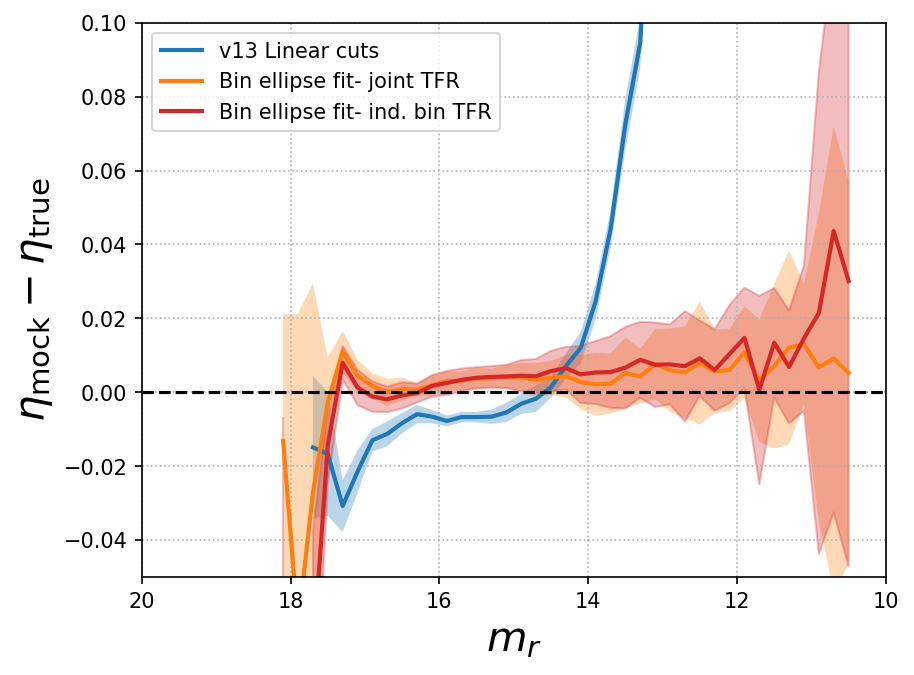

In [61]:
Mr_bins = np.arange(9, 19, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])
plt.figure(dpi=150, facecolor='none')
# --------------------------------------------------- plot each fit
## v13 mock fit
_, eta_mean, eta_std = mean_delta_eta_appm(f'mock_v13', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='v13 Linear cuts')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

## v5 fit (pop ellipse)
_, eta_mean, eta_std = mean_delta_eta_appm(f'mock_v7_zmin3', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='Bin ellipse fit- joint TFR')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


_, eta_mean, eta_std = mean_delta_eta_appm(f'mock_v9_zmin3', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='Bin ellipse fit- ind. bin TFR', color='tab:red')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3, color='tab:red')


plt.grid(ls=':')
plt.hlines(0, 20, 8, linestyles='dashed', colors='k', zorder=5)
plt.legend()
plt.xlabel(r'$m_r$', fontsize=20)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=20)
plt.xlim(20,10)
plt.ylim(-0.05,0.1)
            

## Compare these methods across ellipse types

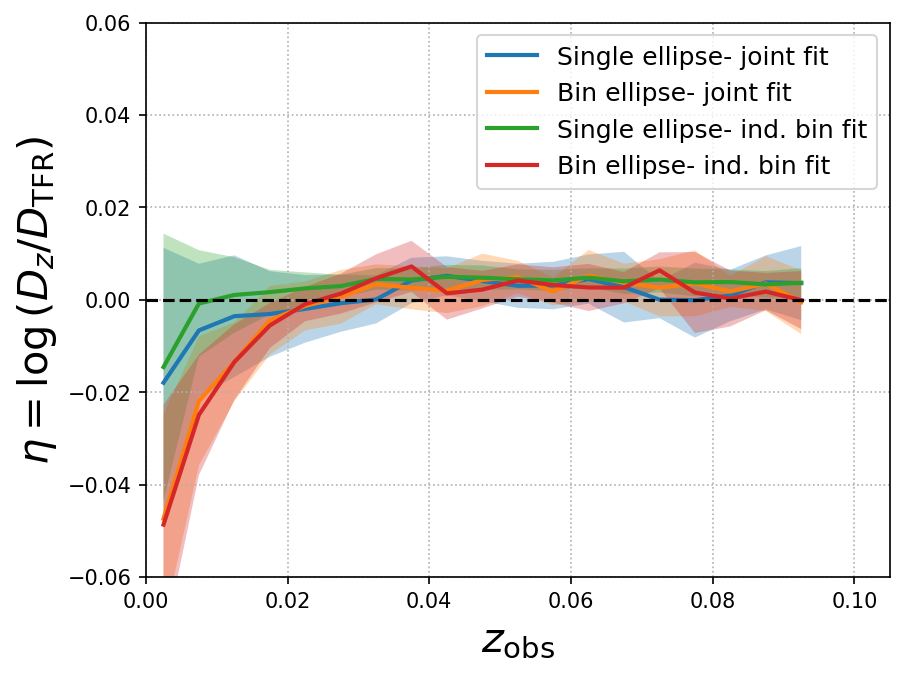

In [64]:
# fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])
cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
# plt.grid(ls=':')

plt.figure(dpi=150, facecolor='none')
plt.grid(ls=':')
dz=0.005
zmin = 0.03
zmax = 0.1

_zbins = np.arange(0, zmax, dz)
zc = 0.5*(_zbins[1:] + _zbins[:-1])

# --------------------------------------------------- plot each fit
_, eta_mean, eta_std = mean_eta_z(f'mock_v5_zmin3', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='Single ellipse- joint fit')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

_, eta_mean, eta_std = mean_eta_z(f'mock_v7_zmin3', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='Bin ellipse- joint fit')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

_, eta_mean, eta_std = mean_eta_z(f'mock_v8_zmin3', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='Single ellipse- ind. bin fit')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

_, eta_mean, eta_std = mean_eta_z(f'mock_v9_zmin3', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='Bin ellipse- ind. bin fit')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)



    
# Line at eta = 0
plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
# -------------------------------------------------------------------------------

plt.legend(fontsize=12)
# plt.title('Population density fits')
plt.xlabel(r'$z_\mathrm{obs}$', fontsize=20)
plt.ylabel(r'$\eta = \log{(D_z / D_\mathrm{TFR})}$', fontsize=20)

plt.xlim(0,0.105)
plt.ylim(-0.06, 0.06);
# plt.show()

# fig.savefig('tfr_mock_eta.png', dpi=150);

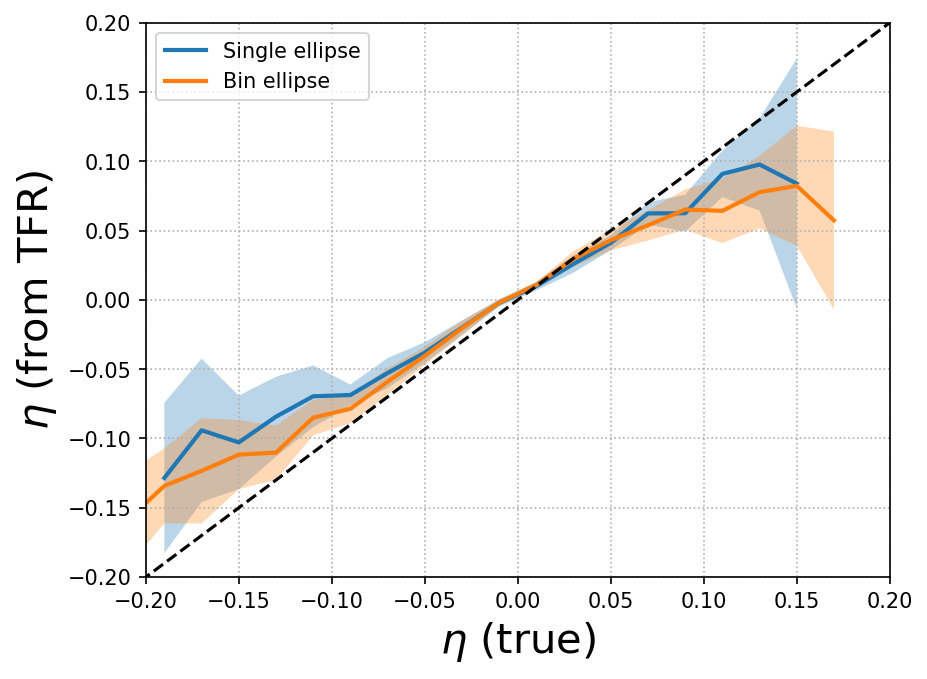

In [88]:
eta_bins = np.arange(-0.5, 0.3, 0.02)
d_eta = 0.5*np.diff(eta_bins)
eta_c = 0.5*(eta_bins[1:] + eta_bins[:-1])

plt.figure(dpi=150, facecolor='none')
# --------------------------------------------------- plot each fit
eta_c, eta_mean, eta_std = mean_eta_eta(f'mock_v5_zmin3', n_mocks=10, eta_bins=eta_bins)

plt.plot(eta_c, eta_mean, lw=2, label='Single ellipse- joint fit')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

eta_c, eta_mean, eta_std = mean_eta_eta(f'mock_v7_zmin3', n_mocks=10, eta_bins=eta_bins)

plt.plot(eta_c, eta_mean, lw=2, label='Bin ellipse- joint fit')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


eta_c, eta_mean, eta_std = mean_eta_eta(f'mock_v8_zmin3', n_mocks=10, eta_bins=eta_bins)

plt.plot(eta_c, eta_mean, lw=2, label='Single ellipse- ind. bin fit')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

eta_c, eta_mean, eta_std = mean_eta_eta(f'mock_v9_zmin3', n_mocks=10, eta_bins=eta_bins)

plt.plot(eta_c, eta_mean, lw=2, label='Bin ellipse- ind. bin fit')
plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

                
plt.grid(ls=':')
plt.plot([-5, 2], [-5, 2], '--', c='k')
plt.xlim([-0.2, 0.2])
plt.ylim([-0.2, 0.2])
plt.legend()
# plt.title('Population Fit', fontsize=16)
plt.xlabel(r'$\eta$ (true)', fontsize=20)
plt.ylabel(r'$\eta$ (from TFR)', fontsize=20);
            

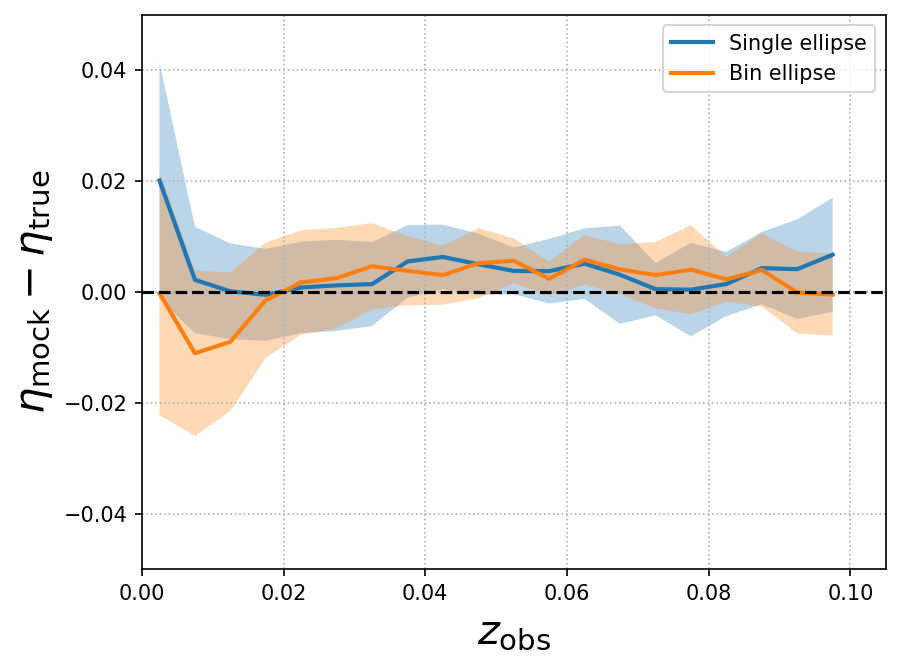

In [89]:
# fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])
cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
plt.figure(dpi=150, facecolor='none')
plt.grid(ls=':')


# --------------------------------------------------- plot each fit
_, eta_mean, eta_std = mean_delta_eta_z(f'mock_v5_zmin3', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='Single ellipse- joint fit')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

_, eta_mean, eta_std = mean_delta_eta_z(f'mock_v7_zmin3', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='Bin ellipse- joint fit')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


_, eta_mean, eta_std = mean_delta_eta_z(f'mock_v8_zmin3', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='Single ellipse- ind. bin fit')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


_, eta_mean, eta_std = mean_delta_eta_z(f'mock_v9_zmin3', n_mocks=10, zbins=_zbins)

plt.plot(zc, eta_mean, lw=2, label='Bin ellipse- ind. bin fit')
plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)



# Line at eta = 0
plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
# -------------------------------------------------------------------------------

plt.legend()
# plt.title('Population density fits')
plt.xlabel(r'$z_\mathrm{obs}$', fontsize=20)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=20)

plt.xlim(0,0.105)
plt.ylim(-0.05, 0.05);
            # plt.show()

# fig.savefig('tfr_mock_eta.png', dpi=150);

(-0.2, 0.2)

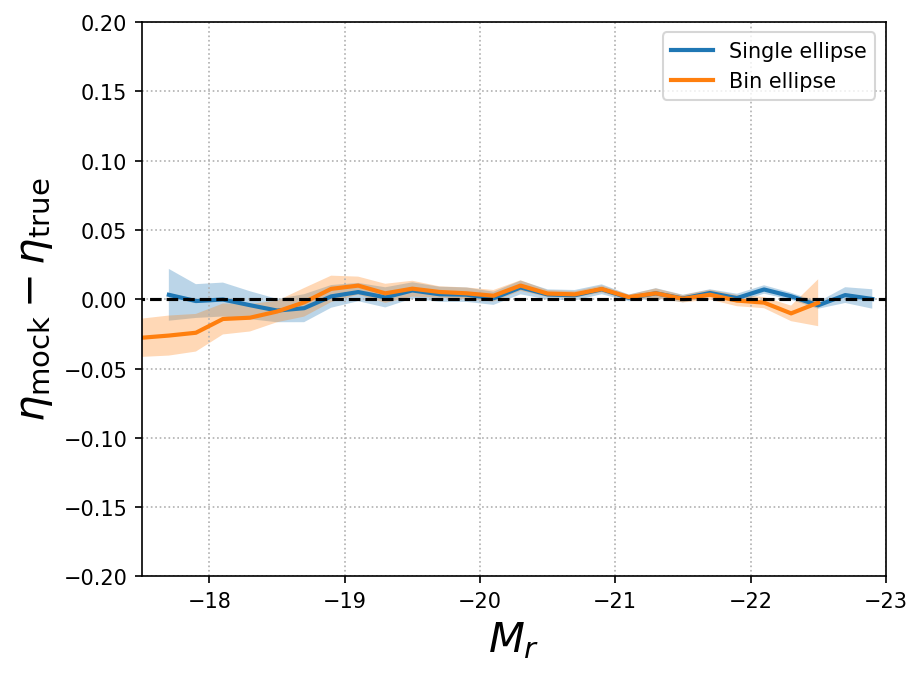

In [90]:
Mr_bins = np.arange(-24, -17, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])
plt.figure(dpi=150, facecolor='none')
# --------------------------------------------------- plot each fit
_, eta_mean, eta_std = mean_delta_eta_m(f'mock_v5_zmin3', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='Single ellipse- joint fit')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

_, eta_mean, eta_std = mean_delta_eta_m(f'mock_v7_zmin3', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='Bin ellipse- joint fit')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


_, eta_mean, eta_std = mean_delta_eta_m(f'mock_v8_zmin3', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='Single ellipse- ind. bin fit')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


_, eta_mean, eta_std = mean_delta_eta_m(f'mock_v9_zmin3', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='Bin ellipse- ind. bin fit')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


                
plt.grid(ls=':')
plt.hlines(0, -24, -17, linestyles='dashed', colors='k', zorder=5)
plt.legend()
plt.xlabel(r'$M_r$', fontsize=20)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=20)
plt.xlim(-17.5,-23)
plt.ylim(-0.2,0.2)
                

(-0.05, 0.1)

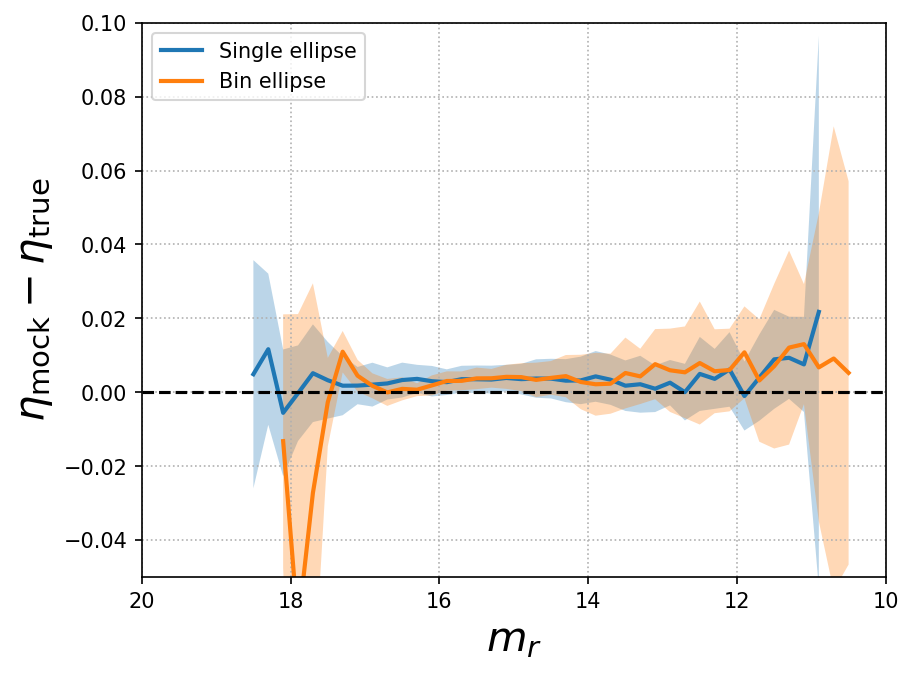

In [91]:
Mr_bins = np.arange(9, 19, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])
plt.figure(dpi=150, facecolor='none')
# --------------------------------------------------- plot each fit
_, eta_mean, eta_std = mean_delta_eta_appm(f'mock_v5_zmin3', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='Single ellipse- joint fit')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

_, eta_mean, eta_std = mean_delta_eta_appm(f'mock_v7_zmin3', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='Bin ellipse- joint fit')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


_, eta_mean, eta_std = mean_delta_eta_appm(f'mock_v8_zmin3', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='Single ellipse- ind. bin fit')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)


_, eta_mean, eta_std = mean_delta_eta_appm(f'mock_v9_zmin3', Mr_bins, n_mocks=10)

plt.plot(Mrc, eta_mean, lw=2, label='Bin ellipse- ind. bin fit')
plt.fill_between(Mrc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)



plt.grid(ls=':')
plt.hlines(0, 20, 8, linestyles='dashed', colors='k', zorder=5)
plt.legend(loc='upper left')
plt.xlabel(r'$m_r$', fontsize=20)
plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=20)
plt.xlim(20,10)
plt.ylim(-0.05,0.1)
            

# Try to correct for eta vs eta true offset

## Read in the files from version 5

In [11]:
for i in range(10):
    ## population density fits
    for j in {0.005, 0.006, 0.0075}:
        for z in {1,3}:
            version='v5'
            globals()[f'mock_dz{int(j*1e4)}_{version}_zmin{z}_extrap_{i}'] = Table.read(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2.5_dz={j}_zmin={z/100}_mockidx={60*i}_extrap.fits')
            globals()[f'mock_dz{int(j*1e4)}_{version}_zmin{z}_noextrap_{i}'] = Table.read(f'/pscratch/sd/s/sgmoore1/TF/mocks/TF_Y1_mock_test_{version}_pop_ell_std=2.5_dz={j}_zmin={z/100}_mockidx={60*i}_noextrap.fits')

## Define a relation of the form y=a*x to relate the offset between the true eta and the fit eta

In [21]:
def fit_y_eq_ax(x, y, yerr):
    mask = np.isfinite(y) & np.isfinite(yerr)  # keep only valid points
    (a,), cov = curve_fit(lambda x, a: a*x, x[mask], y[mask], sigma=yerr[mask], absolute_sigma=True)
    return a, np.sqrt(cov[0,0])

## Fit a relation for $a$ and plot it

0.7334235210734386 0.03502766996746077


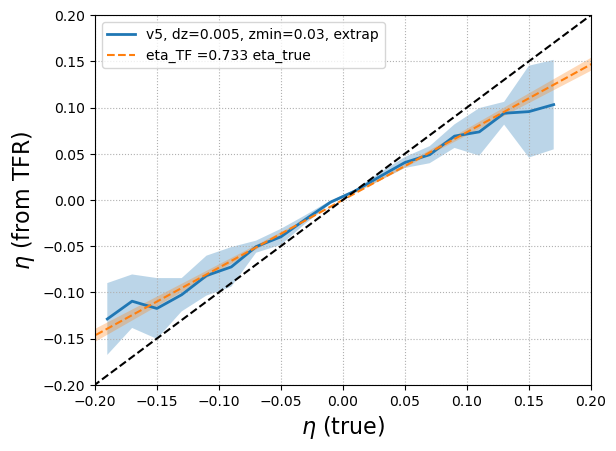

In [32]:
eta_bins = np.arange(-0.5, 0.3, 0.02)
d_eta = 0.5*np.diff(eta_bins)
eta_c = 0.5*(eta_bins[1:] + eta_bins[:-1])

for i in {'v5'}:
    for width in {50}:
        plt.figure()
        plt.grid(ls=':')

        for j in {'extrap'}:
        # for j in {'extrap', 'noextrap'}:
            for k in {3}:
                dz=width/10000
                zmin = (k/100)
                eta_c, eta_mean, eta_std = mean_eta_eta(f'mock_dz{width}_{i}_zmin{k}_{j}', eta_bins, n_mocks=10)

                a, a_err = fit_y_eq_ax(x=eta_c, y=eta_mean, yerr=eta_std)
                print(a, a_err)
                
                plt.plot(eta_c, eta_mean, lw=2, label=f'{i}, dz={dz}, zmin={zmin}, {j}')
                plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
                plt.plot([-5, 2], [-5*a, 2*a], '--', label=f'eta_TF ={a:.3f} eta_true')
                plt.fill_between([-5, 2], [-5*(a-a_err), 2*(a-a_err)], [-5*(a+a_err), 2*(a+a_err)], alpha=0.3)
                
        plt.grid(ls=':')
        plt.plot([-5, 2], [-5, 2], '--', c='k')
        plt.xlim([-0.2, 0.2])
        plt.ylim([-0.2, 0.2])
        plt.legend()
        # plt.title('Population Fit', fontsize=16)
        plt.xlabel(r'$\eta$ (true)', fontsize=16)
        plt.ylabel(r'$\eta$ (from TFR)', fontsize=16);
            

## Define a "corrected eta"

In [51]:
for i in range(10):
    # Get the catalog variable from globals()
    cat = globals()[f"mock_dz50_v5_zmin3_extrap_{i}"]
    cat['LOGDIST_CORR'] = cat['LOGDIST']/a
    cat['LOGDIST_ERR_CORR'] = cat['LOGDIST_CORR']*np.sqrt((cat['LOGDIST_ERR']/cat['LOGDIST'])**2 + (a_err/a)**2)

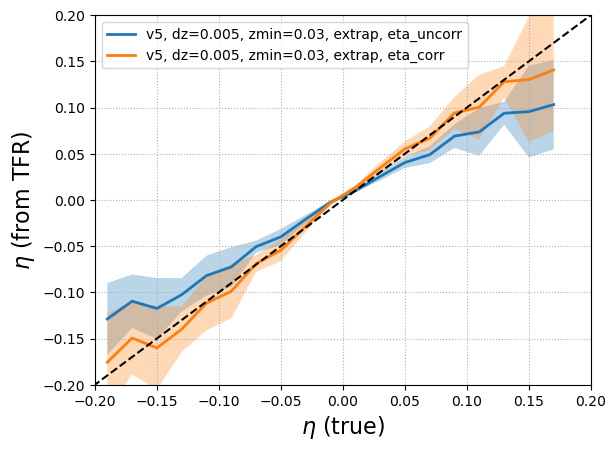

In [52]:
#### Plot to make sure it is now 1-1

eta_bins = np.arange(-0.5, 0.3, 0.02)
d_eta = 0.5*np.diff(eta_bins)
eta_c = 0.5*(eta_bins[1:] + eta_bins[:-1])

for i in {'v5'}:
    for width in {50}:
        plt.figure()
        plt.grid(ls=':')

        for j in {'extrap'}:
        # for j in {'extrap', 'noextrap'}:
            for k in {3}:
                dz=width/10000
                zmin = (k/100)
                
                eta_c, eta_mean, eta_std = mean_eta_eta(f'mock_dz{width}_{i}_zmin{k}_{j}', eta_bins, n_mocks=10)
                
                plt.plot(eta_c, eta_mean, lw=2, label=f'{i}, dz={dz}, zmin={zmin}, {j}, eta_uncorr')
                plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

                
                eta_c, eta_mean, eta_std = mean_eta_eta(f'mock_dz{width}_{i}_zmin{k}_{j}', eta_bins, 
                                                        n_mocks=10, eta_col='LOGDIST_CORR', eta_err_col='LOGDIST_ERR_CORR')
                
                plt.plot(eta_c, eta_mean, lw=2, label=f'{i}, dz={dz}, zmin={zmin}, {j}, eta_corr')
                plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
                
        plt.grid(ls=':')
        plt.plot([-5, 2], [-5, 2], '--', c='k')
        plt.xlim([-0.2, 0.2])
        plt.ylim([-0.2, 0.2])
        plt.legend()
        # plt.title('Population Fit', fontsize=16)
        plt.xlabel(r'$\eta$ (true)', fontsize=16)
        plt.ylabel(r'$\eta$ (from TFR)', fontsize=16);
            

## Make the rest of the diagnostics plots to see how this correction changes things

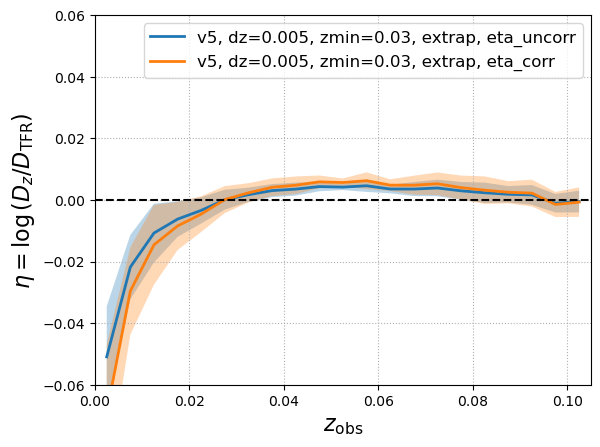

In [53]:
# fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])
cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
# plt.grid(ls=':')

for i in {'v5'}:
    for width in {50}:
        plt.figure()
        plt.grid(ls=':')

        for j in {'extrap'}:
            for k in {3}:
                dz=width/10000
                zmin = (k/100)
                zmax = zmin +  math.ceil(1+((0.1-zmin)/dz))*dz

                _zbins = np.arange(0, zmax, dz)
                # dz = 0.5*np.diff(_zbins)
                zc = 0.5*(_zbins[1:] + _zbins[:-1])
                _, eta_mean, eta_std = mean_eta_z(f'mock_dz{width}_{i}_zmin{k}_{j}', n_mocks=10, zbins=_zbins)
                
                plt.plot(zc, eta_mean, lw=2, label=f'{i}, dz={dz}, zmin={zmin}, {j}, eta_uncorr')
                plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

                _, eta_mean, eta_std = mean_eta_z(f'mock_dz{width}_{i}_zmin{k}_{j}', n_mocks=10, zbins=_zbins,
                                                 eta_col='LOGDIST_CORR', eta_err_col='LOGDIST_ERR_CORR')
                
                plt.plot(zc, eta_mean, lw=2, label=f'{i}, dz={dz}, zmin={zmin}, {j}, eta_corr')
                plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
            

        # Line at eta = 0
        plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
        # -------------------------------------------------------------------------------
        
        plt.legend(fontsize=12)
        # plt.title('Population density fits')
        plt.xlabel(r'$z_\mathrm{obs}$', fontsize=16)
        plt.ylabel(r'$\eta = \log{(D_z / D_\mathrm{TFR})}$', fontsize=16)
        
        plt.xlim(0,0.105)
        plt.ylim(-0.06, 0.06);
        # plt.show()

# fig.savefig('tfr_mock_eta.png', dpi=150);

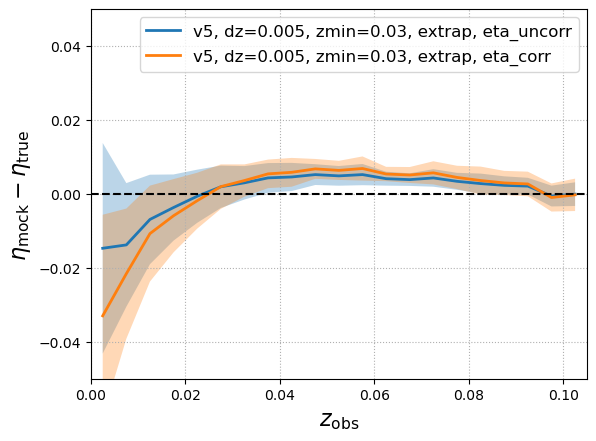

In [54]:
# fig = plt.figure(tight_layout=True, facecolor='none', dpi=150)

_zbins = np.arange(0, 0.105, 0.005)
dz = 0.5*np.diff(_zbins)
zc = 0.5*(_zbins[1:] + _zbins[:-1])
cosmology = FlatLambdaCDM(H0=100*h, Om0=0.3151)
# plt.grid(ls=':')

for i in {'v5'}:
    for j in {'extrap'}:
        for k in {3}:
            plt.figure()
            plt.grid(ls=':')
    
            for width in {50}:
                dz=width/10000
                zmin = (k/100)
                zmax = zmin +  math.ceil(1+((0.1-zmin)/dz))*dz

                _zbins = np.arange(0, zmax, dz)
                # dz = 0.5*np.diff(_zbins)
                zc = 0.5*(_zbins[1:] + _zbins[:-1])
                _, eta_mean, eta_std = mean_delta_eta_z(f'mock_dz{width}_{i}_zmin{k}_{j}', n_mocks=10, zbins=_zbins)
                
                plt.plot(zc, eta_mean, lw=2, label=f'{i}, dz={dz}, zmin={zmin}, {j}, eta_uncorr')
                plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

                _, eta_mean, eta_std = mean_delta_eta_z(f'mock_dz{width}_{i}_zmin{k}_{j}', n_mocks=10, zbins=_zbins,
                                                       eta_col='LOGDIST_CORR', eta_err_col='LOGDIST_ERR_CORR')
                
                plt.plot(zc, eta_mean, lw=2, label=f'{i}, dz={dz}, zmin={zmin}, {j}, eta_corr')
                plt.fill_between(zc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
                
            

            # Line at eta = 0
            plt.hlines(0, 0, 0.2, linestyles='dashed', colors='k', zorder=5)
            # -------------------------------------------------------------------------------
            
            plt.legend(fontsize=12)
            # plt.title('Population density fits')
            plt.xlabel(r'$z_\mathrm{obs}$', fontsize=16)
            plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)
            
            plt.xlim(0,0.105)
            plt.ylim(-0.05, 0.05);
        # plt.show()

# fig.savefig('tfr_mock_eta.png', dpi=150);

/global/u1/s/sgmoore1/DESI_SGA/TF/help_functions.py:62: RuntimeWarning: invalid value encountered in true_divide
  h = H/W
/global/u1/s/sgmoore1/DESI_SGA/TF/help_functions.py:63: RuntimeWarning: divide by zero encountered in true_divide
  e = 1/np.sqrt(W)


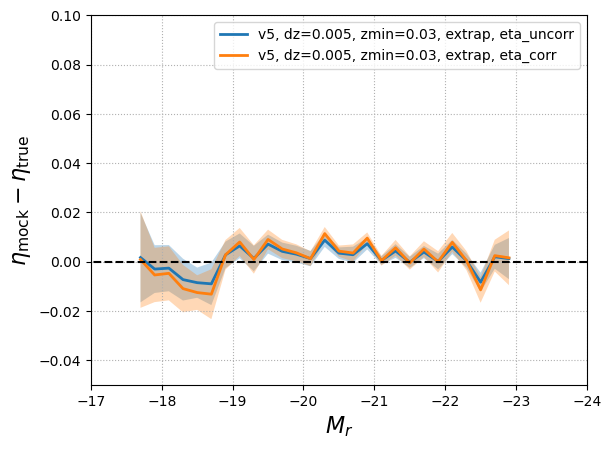

In [46]:
Mr_bins = np.arange(-24, -17, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])

for i in {'v5'}:
    for j in {'extrap'}:
        for k in {3}:
            plt.figure()
            plt.grid(ls=':')
    
            for width in {50}:
                dz=width/10000
                zmin = (k/100)
                mc, eta_mean, eta_std = mean_delta_eta_m(f'mock_dz{width}_{i}_zmin{k}_{j}', Mr_bins, n_mocks=10)
                
                plt.plot(mc, eta_mean, lw=2, label=f'{i}, dz={dz}, zmin={zmin}, {j}, eta_uncorr')
                plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

                mc, eta_mean, eta_std = mean_delta_eta_m(f'mock_dz{width}_{i}_zmin{k}_{j}', Mr_bins, n_mocks=10,
                                                        eta_col='LOGDIST_CORR', eta_err_col='LOGDIST_ERR_CORR')
                
                plt.plot(mc, eta_mean, lw=2, label=f'{i}, dz={dz}, zmin={zmin}, {j}, eta_corr')
                plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
                
            plt.grid(ls=':')
            plt.hlines(0, -24, -17, linestyles='dashed', colors='k', zorder=5)
            plt.legend()
            plt.xlabel(r'$M_r$', fontsize=16)
            plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)
            plt.xlim(-17,-24)
            plt.ylim(-0.05,0.1)
            

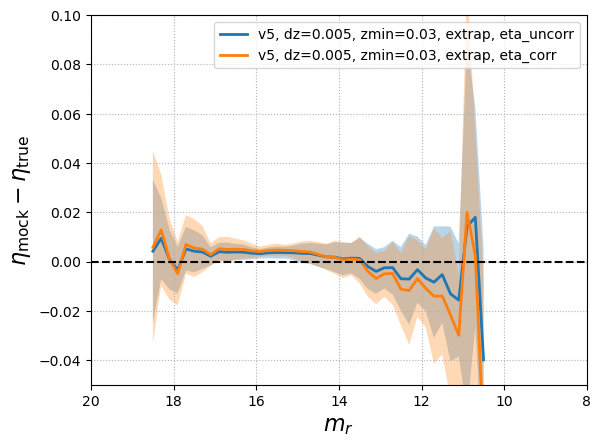

In [48]:
Mr_bins = np.arange(9, 19, 0.2)
dMr = 0.5*np.diff(Mr_bins)
Mrc = 0.5*(Mr_bins[1:] + Mr_bins[:-1])

for i in {'v5'}:
    for j in {'extrap'}:
        for k in {3}:
            plt.figure()
            plt.grid(ls=':')
    
            for width in {50}:
                dz=width/10000
                zmin = (k/100)
                mc, eta_mean, eta_std = mean_delta_eta_appm(f'mock_dz{width}_{i}_zmin{k}_{j}', Mr_bins, n_mocks=10)
                
                plt.plot(mc, eta_mean, lw=2, label=f'{i}, dz={dz}, zmin={zmin}, {j}, eta_uncorr')
                plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

                mc, eta_mean, eta_std = mean_delta_eta_appm(f'mock_dz{width}_{i}_zmin{k}_{j}', Mr_bins, n_mocks=10,
                                                           eta_col='LOGDIST_CORR', eta_err_col='LOGDIST_ERR_CORR')
                
                plt.plot(mc, eta_mean, lw=2, label=f'{i}, dz={dz}, zmin={zmin}, {j}, eta_corr')
                plt.fill_between(mc, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
                
            plt.grid(ls=':')
            plt.hlines(0, 20, 8, linestyles='dashed', colors='k', zorder=5)
            plt.legend()
            plt.xlabel(r'$m_r$', fontsize=16)
            plt.ylabel(r'$\eta_{\mathrm{mock}} - \eta_{\mathrm{true}} $', fontsize=16)
            plt.xlim(20,8)
            plt.ylim(-0.05,0.1)
            

### Check what this correction does within redshift bins

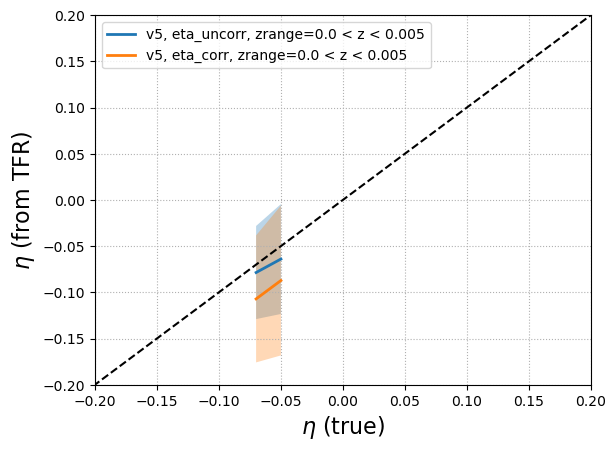

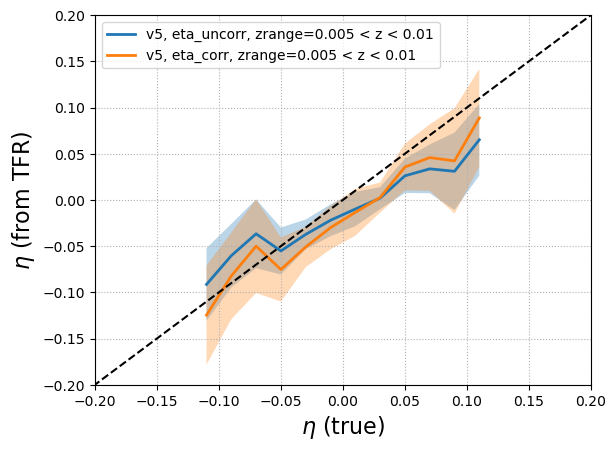

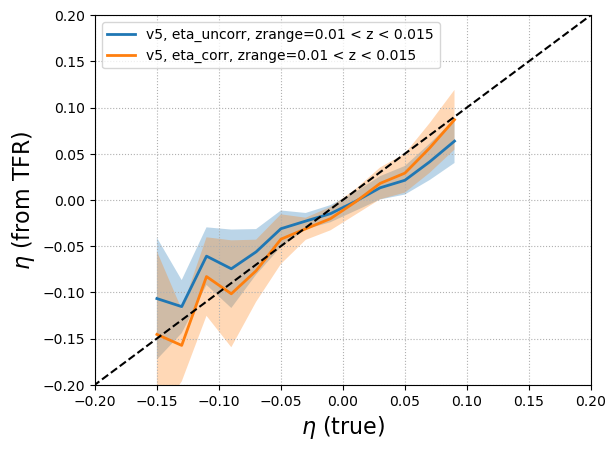

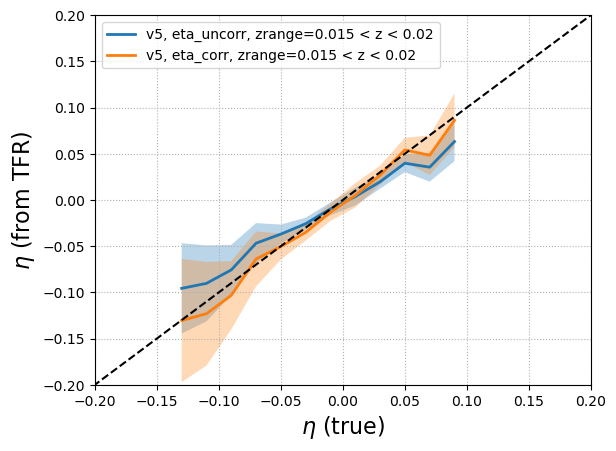

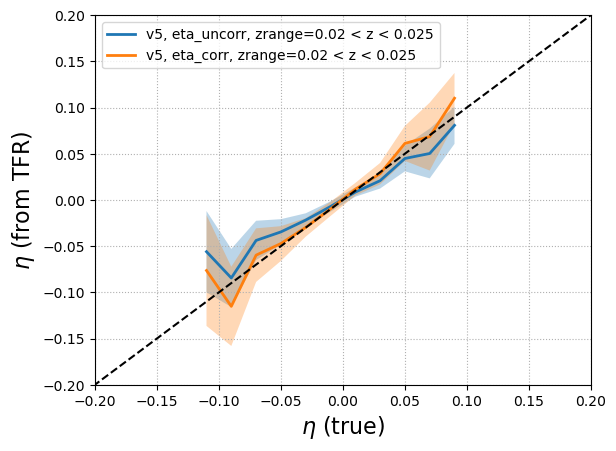

...

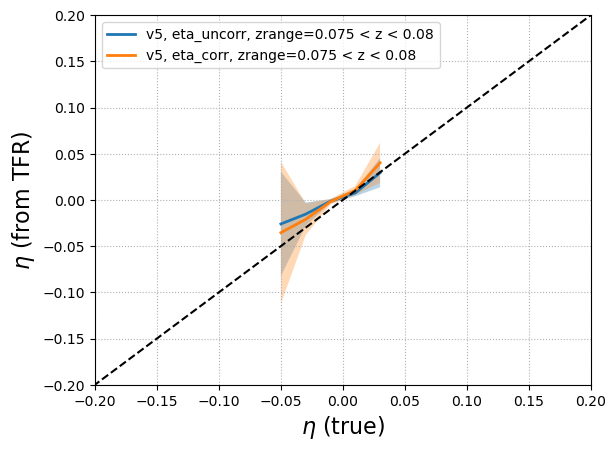

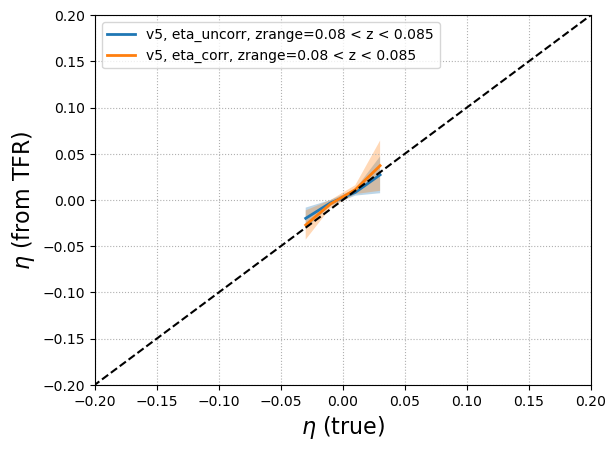

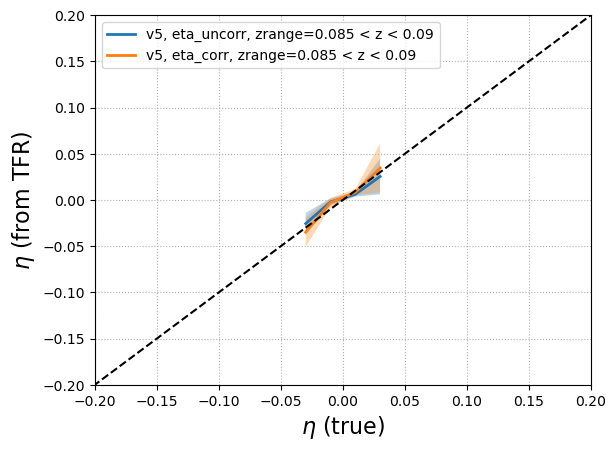

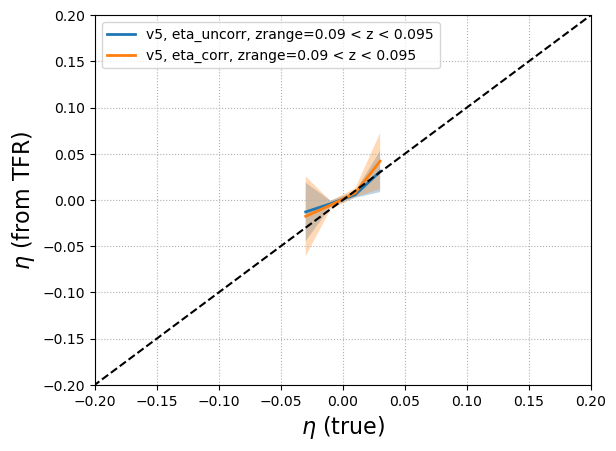

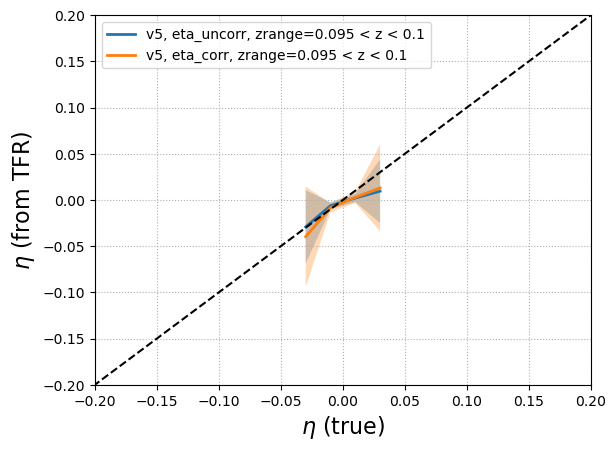

In [73]:
#### Plot to make sure it is now 1-1

eta_bins = np.arange(-0.5, 0.3, 0.02)
d_eta = 0.5*np.diff(eta_bins)
eta_c = 0.5*(eta_bins[1:] + eta_bins[:-1])

for i in {'v5'}:
    for n in range(0,20):
        plt.figure()
        plt.grid(ls=':')

        for j in {'extrap'}:
        # for j in {'extrap', 'noextrap'}:
            for width in {50}:
                k=3
                dz=width/10000
                zmin = (k/100)
                
                eta_c, eta_mean, eta_std = mean_eta_eta_zbins(f'mock_dz{width}_{i}_zmin{k}_{j}', eta_bins, n_mocks=10,
                                                             zmin=(dz*n), zmax=(dz*(n+1)))
                
                plt.plot(eta_c, eta_mean, lw=2, label=f'v5, eta_uncorr, zrange={dz*n} < z < {dz*(n+1)}')
                plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)

                
                eta_c, eta_mean, eta_std = mean_eta_eta_zbins(f'mock_dz{width}_{i}_zmin{k}_{j}', eta_bins, n_mocks=10, 
                                                              eta_col='LOGDIST_CORR', eta_err_col='LOGDIST_ERR_CORR',
                                                              zmin=(dz*n), zmax=(dz*(n+1)))
                
                plt.plot(eta_c, eta_mean, lw=2, label=f'v5, eta_corr, zrange={dz*n} < z < {dz*(n+1)}')
                plt.fill_between(eta_c, eta_mean - eta_std, eta_mean + eta_std, alpha=0.3)
                
        plt.grid(ls=':')
        plt.plot([-5, 2], [-5, 2], '--', c='k')
        plt.xlim([-0.2, 0.2])
        plt.ylim([-0.2, 0.2])
        plt.legend()
        # plt.title('Population Fit', fontsize=16)
        plt.xlabel(r'$\eta$ (true)', fontsize=16)
        plt.ylabel(r'$\eta$ (from TFR)', fontsize=16);
            